In [1]:
import timeit

### Importing Dataset

In [2]:
import h5py
filename = "test_data.h5"

with h5py.File(filename, "r") as f:
    # Print all root level object names (aka keys) 
    # these can be group or dataset names 
    print("Keys: %s" % f.keys())
    # get first object name/key; may or may NOT be a group
    a_group_key = list(f.keys())[0]
    a_group_key2 = list(f.keys())[1]
    # get the object type for a_group_key: usually group or dataset
    print(type(f[a_group_key])) 
    print(type(f[a_group_key2])) 

    # If a_group_key is a group name, 
    # this gets the object names in the group and returns as a list
    data1 = list(f[a_group_key])
    data2 = list(f[a_group_key2])
    # If a_group_key is a dataset name, 
    # this gets the dataset values and returns as a list
    data = list(f[a_group_key])
    data2 = list(f[a_group_key2])
    # preferred methods to get dataset values:
    ds_obj = f[a_group_key]      # returns as a h5py dataset object
    ds_arr1 = f[a_group_key][()]  # returns as a numpy array
    ds_obj2 = f[a_group_key2]      # returns as a h5py dataset object
    ds_arr2 = f[a_group_key2][()]  # returns as a numpy array

Keys: <KeysViewHDF5 ['xtest', 'ytest']>
<class 'h5py._hl.dataset.Dataset'>
<class 'h5py._hl.dataset.Dataset'>


In [3]:
ds_arr1.shape
ds_arr2.shape

(300,)

### Importing Depth Map Estimator

In [4]:
import cv2
import numpy as np
import joblib
import pickle
from keras.models import Sequential
from keras.models import load_model
import torch
import urllib.request
import matplotlib.pyplot as plt
import os
import pandas as pd
import sys
#sys.setrecursionlimit(1000)
#Uncomment when using Windows if CuDNN does not work
#os.environ["CUDA_VISIBLE_DEVICES"] = "-1"


#model_type = "DPT_Large"     # MiDaS v3 - Large     (highest accuracy, slowest inference speed)
#model_type = "DPT_Hybrid"   # MiDaS v3 - Hybrid    (medium accuracy, medium inference speed)
model_type = "MiDaS_small"  # MiDaS v2.1 - Small   (lowest accuracy, highest inference speed)

midas = torch.hub.load("intel-isl/MiDaS", model_type)
device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
midas.to(device)
midas.eval()

midas_transforms = torch.hub.load("intel-isl/MiDaS", "transforms")

if model_type == "DPT_Large" or model_type == "DPT_Hybrid":
    transform = midas_transforms.dpt_transform
else:
    transform = midas_transforms.small_transform


def image_to_depth(img):
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    input_batch = transform(img).to(device)

    with torch.no_grad():
        prediction = midas(input_batch)

        prediction = torch.nn.functional.interpolate(
            prediction.unsqueeze(1),
            size=img.shape[:2],
            mode="bicubic",
            align_corners=False,
        ).squeeze()

    output = prediction.cpu().numpy()
    return output

#cap=cv2.VideoCapture('CS_thirdfloor_centre.mp4',apiPreference=cv2.CAP_MSMF)

Using cache found in C:\Users\USER/.cache\torch\hub\intel-isl_MiDaS_master


Loading weights:  None


Using cache found in C:\Users\USER/.cache\torch\hub\rwightman_gen-efficientnet-pytorch_master
Using cache found in C:\Users\USER/.cache\torch\hub\intel-isl_MiDaS_master


### Evaluating the proposed approach on various values of Area of Interest Thresholds

##### The below code evaluates the proposed approach on various values of Area_of_Interest_Threshold.
##### After passing all 300 test images on each value of Area_of_Interest_Threshold, the MSE, MAE and MRE metric values are printed along with the its corresponding Area_of_Interest_Threshold.
##### The metrics are then appended to their corresponding arrays and printed.
##### One can scroll through the output and view the metrics at each theta_AOI.
##### If the wrong class is predicted, the image and its prediction is displayed

(81.67552182163273, 19.212523719165254)
1 (81.67552182163273, 19.212523719165254) turn left 0.1275 2.2690534000000007 2.4192 correct
(69.1944444444443, 20.034722222222168)
2 (69.1944444444443, 20.034722222222168) turn left 0.15416666666666667 0.018643399999998422 0.16295410000000032 correct
(74.28099173553703, 46.159779614324954)
3 (74.28099173553703, 46.159779614324954) turn left 0.2808333333333333 0.01864980000000216 0.16424840000000174 correct
(59.7160161507413, 79.87752355316427)
4 (59.7160161507413, 79.87752355316427) turn left 0.4975 0.01884989999999931 0.17974669999999904 correct
(80.54952076677439, 144.81789137380375)
5 (80.54952076677439, 144.81789137380375) turn right 0.8033333333333333 0.01868740000000102 0.1743074 correct
(85.19790104947663, 88.178410794604)
6 (85.19790104947663, 88.178410794604) turn left 0.495 0.01847850000000051 0.1760754999999996 correct
(68.64210526315777, 83.88421052631563)
7 (68.64210526315777, 83.88421052631563) turn left 0.4766666666666667 0.017900

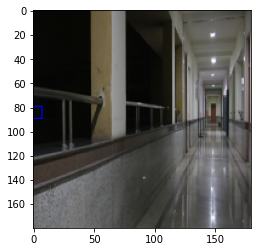

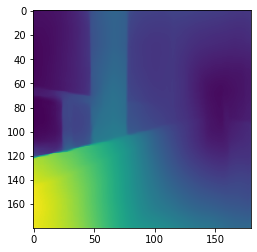

(76.21126760563364, 85.83450704225329)
18 (76.21126760563364, 85.83450704225329) turn left 0.4891666666666667 0.046109500000000025 0.18732710000000097 correct
(103.04071499503708, 15.406156901688565)
19 (103.04071499503708, 15.406156901688565) turn left 0.21833333333333332 0.04614989999999963 0.2138315999999989 correct
(65.05988023952071, 98.37724550898182)
20 (65.05988023952071, 98.37724550898182) turn right 0.5466666666666666 0.046183899999999056 0.1908235999999981 correct
(66.04055766793621, 25.486058301648384)
21 (66.04055766793621, 25.486058301648384) turn left 0.16 0.0966042999999992 0.2827075000000008 correct
(56.46857142857123, 30.039999999999917)
22 (56.46857142857123, 30.039999999999917) turn left 0.15833333333333333 0.09783949999999919 0.24026889999999668 correct
(81.41439688716022, 76.25291828793829)
23 (81.41439688716022, 76.25291828793829) turn left 0.455 0.09473799999999954 0.2424464999999998 correct
(81.84661354581739, 30.537848605577903)
24 (81.84661354581739, 30.53784

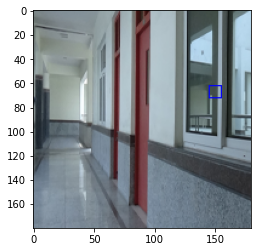

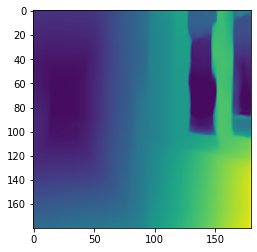

(69.48012232415884, 83.14984709480107)
53 (69.48012232415884, 83.14984709480107) turn left 0.4975 0.09386239999999901 0.2360597999999996 correct
(63.73563218390849, 28.827586206896797)
54 (63.73563218390849, 28.827586206896797) turn left 0.15833333333333333 0.0942734999999999 0.2467193000000023 correct
(60.36231884058111, 83.77480490524144)
55 (60.36231884058111, 83.77480490524144) turn left 0.48083333333333333 0.09391430000000156 0.25533709999999843 correct
(76.95640326975459, 27.051771117166158)
56 (76.95640326975459, 27.051771117166158) turn left 0.1575 0.09719520000000159 0.24142319999999984 correct
(89.67932960894046, 27.712849162011764)
57 (89.67932960894046, 27.712849162011764) turn left 0.15416666666666667 0.09763899999999381 0.2594021999999967 correct
(60.34153005464471, 156.66939890710358)
(94.75892857142841, 175.6607142857139)
58 (60.34153005464471, 156.66939890710358) turn right 0.8275 0.09781399999999962 0.24974249999999643 correct
(82.76749435665941, 14.530474040632084)
5

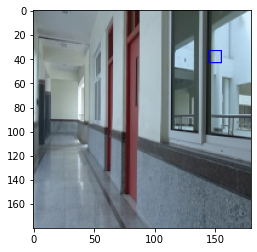

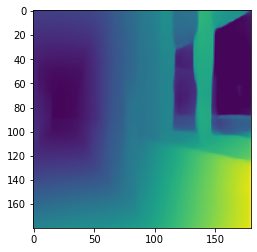

(79.66129032258046, 174.06182795698888)
98 (79.66129032258046, 174.06182795698888) turn right 0.7916666666666666 0.09167560000000208 0.2368224000000012 correct
(75.71815718157168, 48.18157181571808)
99 (75.71815718157168, 48.18157181571808) turn left 0.2808333333333333 0.09304699999999855 0.2652189000000007 correct
(88.83783783783753, 36.50193050193037)
100 (88.83783783783753, 36.50193050193037) turn left 0.20833333333333334 0.09621889999999667 0.25035520000000133 correct
(60.57394366197177, 87.86267605633773)
101 (60.57394366197177, 87.86267605633773) turn left 0.49583333333333335 0.04492270000000076 0.18672829999999863 correct
(88.71874999999976, 176.66249999999954)
102 (88.71874999999976, 176.66249999999954) turn right 0.8033333333333333 0.04516439999999733 0.18889809999999585 correct
(84.77623026926912, 157.3779015784638)
103 (84.77623026926912, 157.3779015784638) turn right 0.8258333333333333 0.04480729999999511 0.2546405000000007 correct
(61.49999999999999, 141.0)
(72.5, 141.0)
1

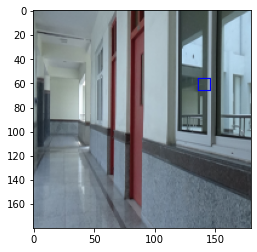

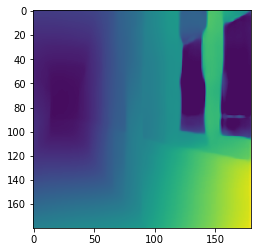

(80.68112798264671, 25.19956616052071)
105 (80.68112798264671, 25.19956616052071) turn left 0.1675 0.09727209999999786 0.2450063 correct
(85.59330143540791, 145.26794258373397)
106 (85.59330143540791, 145.26794258373397) turn right 0.805 0.09324119999999425 0.2465978999999976 correct
(72.12173913043469, 142.273913043478)
107 (72.12173913043469, 142.273913043478) turn right 0.8025 0.09247550000000615 0.23236570000000256 correct
(38.458005249344495, 89.00131233595968)
108 (38.458005249344495, 89.00131233595968) turn left 0.48833333333333334 0.09135320000000036 0.25019710000000117 correct
(79.1716621253405, 82.6485013623977)
109 (79.1716621253405, 82.6485013623977) turn left 0.4708333333333333 0.04564750000000117 0.1897637000000003 correct
(76.48857644991311, 87.08963093145965)
110 (76.48857644991311, 87.08963093145965) turn left 0.4875 0.04593730000000562 0.1988853000000006 correct
(67.95449241540362, 142.0221703617299)
111 (67.95449241540362, 142.0221703617299) turn right 0.8025 0.04583

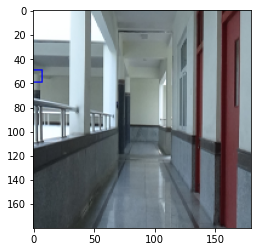

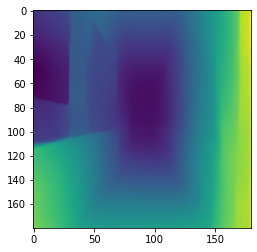

(53.27781665500511, 92.31140657802923)
116 (53.27781665500511, 92.31140657802923) turn right 0.49916666666666665 0.09248159999999928 0.27504100000000165 wrong


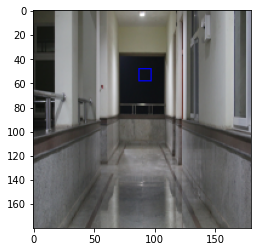

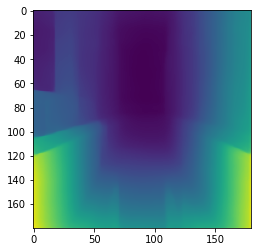

(67.190402476782, 142.86919504644368)
117 (67.190402476782, 142.86919504644368) turn right 0.8008333333333333 0.09207089999999596 0.2671019000000001 correct
(77.63621399177148, 127.76460905350133)
118 (77.63621399177148, 127.76460905350133) turn right 0.7225 0.09230089999999791 0.26579830000000015 correct
(65.28183118741156, 97.34048640915766)
119 (65.28183118741156, 97.34048640915766) turn right 0.5466666666666666 0.09556680000000028 0.2502490999999907 correct
(61.61498257839783, 88.3449477351926)
120 (61.61498257839783, 88.3449477351926) turn left 0.48833333333333334 0.09333580000000552 0.24459439999999688 correct
(72.18401206636608, 25.487179487179862)
121 (72.18401206636608, 25.487179487179862) turn left 0.14333333333333334 0.09195880000000045 0.24572019999999384 correct
(80.64693877551082, 144.82857142857236)
122 (80.64693877551082, 144.82857142857236) turn right 0.8033333333333333 0.090919999999997 0.23915449999999794 correct
(75.38414634146324, 177.60365853658527)
123 (75.384146

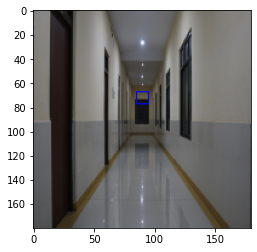

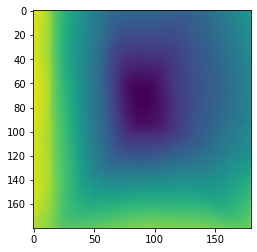

(76.28556593977336, 149.29906542056446)
142 (76.28556593977336, 149.29906542056446) turn right 0.8283333333333334 0.09018759999999304 0.2567292999999893 correct
(78.10000000000159, 25.916279069767988)
143 (78.10000000000159, 25.916279069767988) turn left 0.175 0.045627199999998425 0.20590830000000437 correct
(76.68397085610391, 27.28597449908992)
144 (76.68397085610391, 27.28597449908992) turn left 0.175 0.04560440000000199 0.2169638999999961 correct
(69.98708010335905, 96.49095607235125)
145 (69.98708010335905, 96.49095607235125) turn right 0.5466666666666666 0.04609179999999924 0.19214900000000057 correct
(77.71021377672211, 80.47030878859863)
146 (77.71021377672211, 80.47030878859863) turn left 0.4708333333333333 0.045700100000004795 0.19313900000000217 correct
(78.83544303797606, 143.51758087201353)
147 (78.83544303797606, 143.51758087201353) turn right 0.7958333333333333 0.045734599999988745 0.2011217999999957 correct
(67.03987240829424, 22.9537480063799)
148 (67.03987240829424, 2

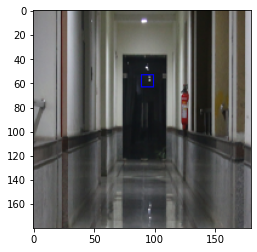

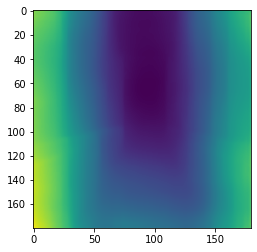

(73.61460957179035, 25.847187237616122)
182 (73.61460957179035, 25.847187237616122) turn left 0.175 0.09624660000000063 0.26712069999999244 correct
(66.35689045936451, 83.20848056537199)
183 (66.35689045936451, 83.20848056537199) turn left 0.48083333333333333 0.0940358999999944 0.24489870000000735 correct
(58.60286591607097, 130.76049129990074)
184 (58.60286591607097, 130.76049129990074) turn right 0.7183333333333334 0.09348450000000241 0.25761409999999785 correct
(62.973765432099576, 88.7793209876557)
185 (62.973765432099576, 88.7793209876557) turn left 0.48833333333333334 0.09248879999999815 0.24669010000000924 correct
(92.47346698113488, 124.87500000000362)
186 (92.47346698113488, 124.87500000000362) turn right 0.7758333333333334 0.09374139999999898 0.28548370000000034 correct
(48.78271308523509, 90.40096038415552)
187 (48.78271308523509, 90.40096038415552) turn right 0.4975 0.09218839999999773 0.25214309999999784 wrong


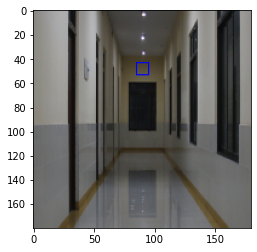

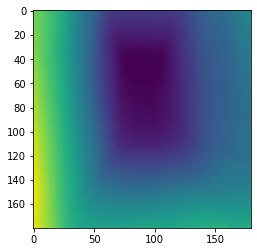

(60.55154639175242, 25.902061855670063)
(106.20388349514538, 2.033980582524268)
188 (60.55154639175242, 25.902061855670063) turn left 0.23416666666666666 0.09788209999999253 0.2503864999999905 correct
(73.01419878296305, 79.82758620689847)
189 (73.01419878296305, 79.82758620689847) turn left 0.455 0.09457319999999925 0.26135719999999196 correct
(78.47534516765359, 27.02564102564123)
190 (78.47534516765359, 27.02564102564123) turn left 0.1675 0.09235379999999793 0.24124510000000043 correct
(65.19852941176559, 155.257352941179)
191 (65.19852941176559, 155.257352941179) turn right 0.8708333333333333 0.09103299999999592 0.24506959999999367 correct
(61.606896551725214, 131.63862068965744)
192 (61.606896551725214, 131.63862068965744) turn right 0.7183333333333334 0.09055859999999427 0.24968919999999173 correct
(71.8272727272729, 97.90000000000025)
193 (71.8272727272729, 97.90000000000025) turn right 0.5466666666666666 0.045550099999999816 0.19095090000000425 correct
(77.6292682926829, 82.429

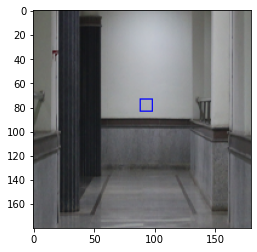

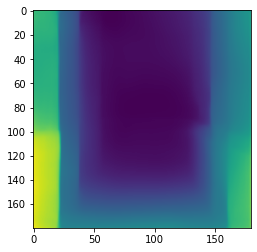

(115.00000000000001, 22.0)
205 (115.00000000000001, 22.0) turn left 0.82 0.04567829999999162 0.17566719999999236 wrong


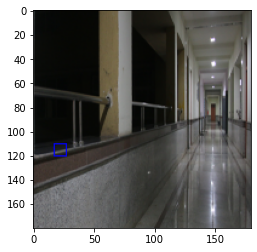

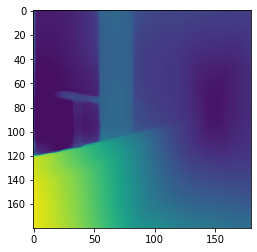

(66.99203821656141, 86.20859872611588)
206 (66.99203821656141, 86.20859872611588) turn left 0.4816666666666667 0.08260640000000308 0.2333082000000104 correct
(56.08973113054947, 154.83155166829167)
(103.93103448275852, 146.0689655172413)
207 (103.93103448275852, 146.0689655172413) turn right 0.8383333333333334 0.09545190000000048 0.3355949000000038 correct
(67.6718528995768, 97.37482319660711)
208 (67.6718528995768, 97.37482319660711) turn right 0.5466666666666666 0.09779179999999599 0.2549946000000034 correct
(87.9313099041547, 37.781150159744925)
209 (87.9313099041547, 37.781150159744925) turn left 0.225 0.09434410000000071 0.24726669999999729 correct
(90.3997252747268, 22.379120879121277)
210 (90.3997252747268, 22.379120879121277) turn left 0.14333333333333334 0.09257789999999488 0.24826059999999472 correct
(90.98619329388639, 38.621301775148204)
211 (90.98619329388639, 38.621301775148204) turn left 0.225 0.0915001999999987 0.23969259999999792 correct
(70.59909909909904, 40.12612612

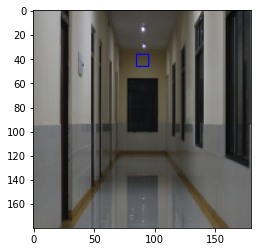

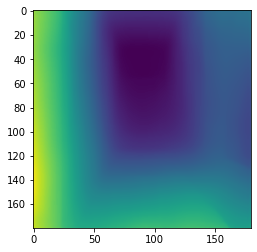

(75.8921694480116, 20.671373555841228)
218 (75.8921694480116, 20.671373555841228) turn left 0.1575 0.09773299999999097 0.25583890000000054 correct
(32.7, 42.699999999999996)
(73.3214829862896, 30.316404266125904)
(42.0, 11.0)
(43.0, 12.0)
219 (32.7, 42.699999999999996) turn left 0.1825 0.09514849999999342 0.29689779999999644 correct
(62.52469135802449, 88.49999999999976)
220 (62.52469135802449, 88.49999999999976) turn left 0.4975 0.09309720000000254 0.23432230000000231 correct
(66.5, 171.00000000000003)
221 (66.5, 171.00000000000003) turn right 0.1375 0.09258469999998908 0.22276469999999904 wrong


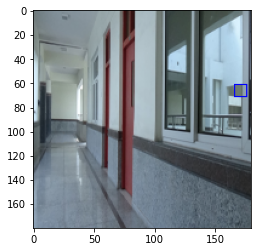

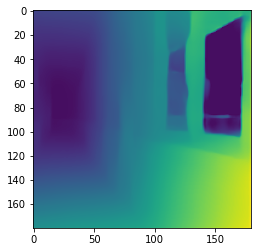

(73.34782608695642, 141.5043478260866)
222 (73.34782608695642, 141.5043478260866) turn right 0.8025 0.09271830000000136 0.23393769999999847 correct
(65.5332252836313, 83.52836304700277)
223 (65.5332252836313, 83.52836304700277) turn left 0.4841666666666667 0.09183680000001004 0.24483580000000416 correct
(65.89181692094414, 84.65187239944663)
224 (65.89181692094414, 84.65187239944663) turn left 0.4975 0.09084620000000143 0.24684179999999856 correct
(73.18953068592144, 39.283393501805456)
225 (73.18953068592144, 39.283393501805456) turn left 0.23416666666666666 0.046523100000001705 0.19719569999999464 correct
(64.6251808972522, 140.08321273517043)
226 (64.6251808972522, 140.08321273517043) turn right 0.8008333333333333 0.04634439999999529 0.22490349999999637 correct
(74.98373983739822, 37.308943089430805)
227 (74.98373983739822, 37.308943089430805) turn left 0.23416666666666666 0.04623170000000698 0.18882690000000935 correct
(76.61192350956286, 10.273340832396174)
228 (76.61192350956286,

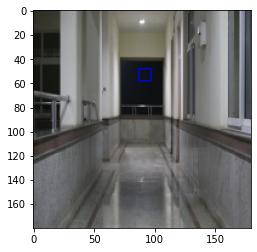

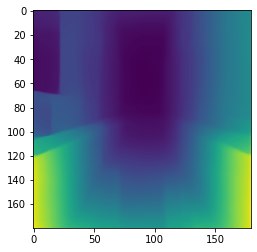

(72.78187919463072, 85.88255033557023)
236 (72.78187919463072, 85.88255033557023) turn left 0.47333333333333333 0.046699699999990685 0.19506579999999474 correct
(74.19659735349785, 87.69187145557737)
237 (74.19659735349785, 87.69187145557737) turn left 0.4875 0.04723260000000096 0.2039637999999968 correct
(60.16393442622997, 88.11293260473678)
238 (60.16393442622997, 88.11293260473678) turn left 0.48833333333333334 0.04626840000000243 0.20160260000000108 correct
(65.52014010507938, 82.40980735551757)
239 (65.52014010507938, 82.40980735551757) turn left 0.48083333333333333 0.09757550000000492 0.24814650000000427 correct
(62.35683453237513, 88.5539568345339)
240 (62.35683453237513, 88.5539568345339) turn left 0.48833333333333334 0.09451330000000269 0.24976029999999128 correct
(65.73201438848982, 87.33992805755493)
241 (65.73201438848982, 87.33992805755493) turn left 0.4975 0.09194420000000036 0.24208670000000154 correct
(63.23511450381757, 35.08091603053491)
242 (63.23511450381757, 35.08

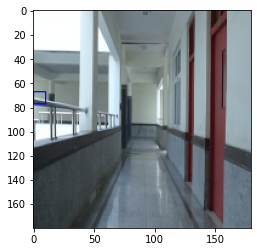

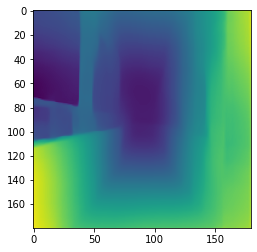

(29.23333333333325, 177.5291666666664)
267 (29.23333333333325, 177.5291666666664) turn right 0.8008333333333333 0.09783269999999789 0.23852440000000286 correct
(79.93865030674903, 26.28425357873226)
268 (79.93865030674903, 26.28425357873226) turn left 0.1675 0.0977901999999915 0.24533699999999214 correct
(65.19012797075008, 155.19926873857548)
269 (65.19012797075008, 155.19926873857548) turn right 0.8683333333333333 0.09796039999999095 0.24671119999999291 correct
(68.23956723338577, 153.74034003091418)
270 (68.23956723338577, 153.74034003091418) turn right 0.8708333333333333 0.09757529999998837 0.25201139999998645 correct
(57.57923930269585, 85.08557844691204)
271 (57.57923930269585, 85.08557844691204) turn left 0.4816666666666667 0.09771229999998354 0.27212979999998765 correct
(74.19392097264652, 95.61702127659863)
272 (74.19392097264652, 95.61702127659863) turn right 0.49083333333333334 0.09790959999997995 0.287412699999976 wrong


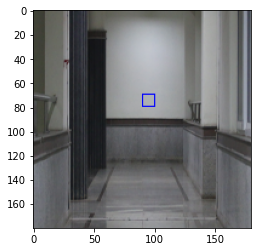

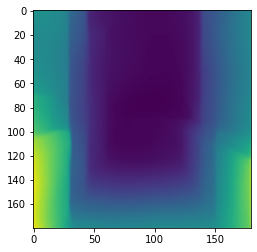

(70.82720588235368, 23.88602941176495)
273 (70.82720588235368, 23.88602941176495) turn left 0.14333333333333334 0.09838970000001268 0.2489471000000094 correct
(85.74452554744505, 2.6605839416058297)
274 (85.74452554744505, 2.6605839416058297) turn left 0.1675 0.0952964000000236 0.23514930000001755 correct
(72.0716332378222, 86.96561604584507)
275 (72.0716332378222, 86.96561604584507) turn left 0.4841666666666667 0.09295620000000326 0.23534349999999904 correct
(81.96632996632975, 78.72390572390556)
276 (81.96632996632975, 78.72390572390556) turn left 0.455 0.0914942999999937 0.23128739999998515 correct
(77.28851963746355, 141.99848942598405)
277 (77.28851963746355, 141.99848942598405) turn right 0.8 0.09084300000000667 0.2454572999999982 correct
(60.66075388026615, 156.11973392461252)
278 (60.66075388026615, 156.11973392461252) turn right 0.8683333333333333 0.046118800000016336 0.19332710000000475 correct
(85.46334012220163, 101.73727087576619)
279 (85.46334012220163, 101.73727087576619

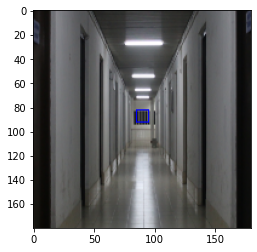

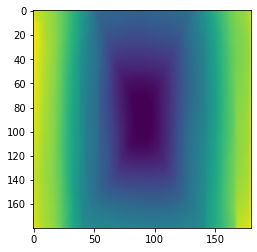

(68.77570093457955, 86.49532710280394)
284 (68.77570093457955, 86.49532710280394) turn left 0.4975 0.09407180000002313 0.23997820000002434 correct
(0.0, 179.0)
(56.03021148036233, 175.25679758308124)
285 (56.03021148036233, 175.25679758308124) turn right 0.8008333333333333 0.09238369999999918 0.23509719999998424 correct
(77.27712609970807, 87.7712609970689)
286 (77.27712609970807, 87.7712609970689) turn left 0.4875 0.09107689999999025 0.2446591000000069 correct
(62.20387359837043, 142.3129459734998)
287 (62.20387359837043, 142.3129459734998) turn right 0.7916666666666666 0.09033250000001658 0.2555791000000056 correct
(85.35629453681726, 87.8931116389549)
288 (85.35629453681726, 87.8931116389549) turn left 0.495 0.04546690000000808 0.19262990000001423 correct
(81.91319444444422, 87.69444444444419)
289 (81.91319444444422, 87.69444444444419) turn left 0.4875 0.04526150000000939 0.1891918999999973 correct
(68.87184466019468, 27.06601941747595)
290 (68.87184466019468, 27.06601941747595) tur

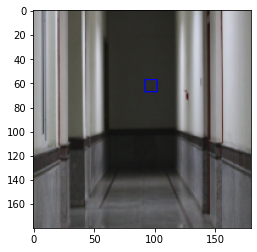

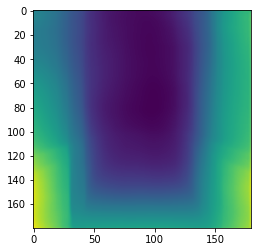

theta_AOI:  10
theta_y:  0
Number of Frames:  300
Predicted count:  300
Unable to Predict count:  0
Correct Decision count:  282
Average Inference Time(s) 0.23703880599999982
Mean Squared Error:  0.015066504577265147
Mean Absolute Error:  0.045171993936472594
Mean Squared Error including unpredicted:  0.015066504577265147
Mean Absolute Error including unpredicted:  0.045171993936472594
Accuracy:  0.94
Discernibility 1.0
theta_AOI:  10
theta_y:  0
Number of Frames:  300
Predicted count: 
[[300.]
 [  0.]
 [  0.]
 [  0.]
 [  0.]
 [  0.]
 [  0.]
 [  0.]
 [  0.]
 [  0.]]
Unable to Predict count: 
[[0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]]
Correct Decision count: 
[[282.]
 [  0.]
 [  0.]
 [  0.]
 [  0.]
 [  0.]
 [  0.]
 [  0.]
 [  0.]
 [  0.]]
Average Inference Time(s)
[[0.23703881]
 [0.        ]
 [0.        ]
 [0.        ]
 [0.        ]
 [0.        ]
 [0.        ]
 [0.        ]
 [0.        ]
 [0.        ]]
Average Depth Inference Time(s)
[[0.08141435]
 [0.        ]
 [0.   

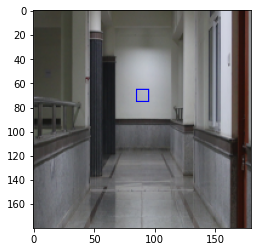

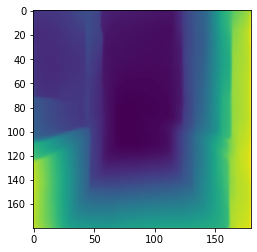

(56.66276517922627, 89.19458668617665)
13 (56.66276517922627, 89.19458668617665) turn left 0.49583333333333335 0.0979236999999955 0.2777498000000094 correct
(71.73235563703197, 86.15582034830648)
14 (71.73235563703197, 86.15582034830648) turn left 0.4891666666666667 0.09778729999999314 0.26767359999999485 correct
(65.21505376344255, 83.90322580645416)
15 (65.21505376344255, 83.90322580645416) turn left 0.48083333333333333 0.09772119999999518 0.2791949999999872 correct
(64.5154894671635, 84.57125154894835)
16 (64.5154894671635, 84.57125154894835) turn left 0.47333333333333333 0.0957576000000131 0.2543314000000123 correct
(39.862068965517174, 3.502873563218376)
(87.24557522123929, 6.747787610619487)
17 (87.24557522123929, 6.747787610619487) turn left 0.82 0.09382039999999847 0.2548205000000223 wrong


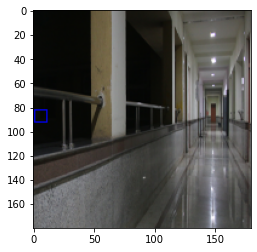

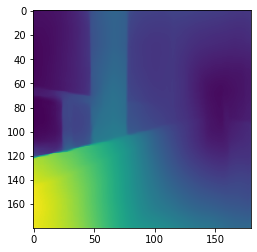

(74.98410896708435, 84.2962542565284)
18 (74.98410896708435, 84.2962542565284) turn left 0.4891666666666667 0.09183889999999906 0.25510349999998994 correct
(70.51090061644182, 27.348067959702465)
19 (70.51090061644182, 27.348067959702465) turn left 0.21833333333333332 0.09077450000000908 0.6298603000000185 correct
(71.99665271966722, 99.22008368201091)
20 (71.99665271966722, 99.22008368201091) turn right 0.5466666666666666 0.046624299999990626 0.22060379999999213 correct
(68.517186505413, 27.487905792489844)
21 (68.517186505413, 27.487905792489844) turn left 0.16 0.04638880000001677 0.2897585000000049 correct
(65.00878293601193, 29.565244667504043)
22 (65.00878293601193, 29.565244667504043) turn left 0.15833333333333333 0.04635689999997794 0.23517160000000104 correct
(80.14326853851892, 77.88408927286036)
23 (80.14326853851892, 77.88408927286036) turn left 0.455 0.09711350000000607 0.27601210000000265 correct
(80.0867970660167, 31.465158924206364)
24 (80.0867970660167, 31.4651589242063

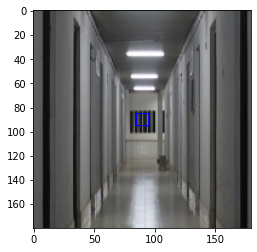

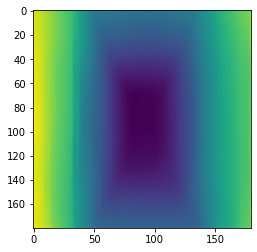

(79.73582766440094, 147.39115646258827)
50 (79.73582766440094, 147.39115646258827) turn right 0.8258333333333333 0.09067400000000703 0.25432440000000156 correct
(76.84907902555196, 148.9150326797429)
51 (76.84907902555196, 148.9150326797429) turn right 0.8283333333333334 0.09066780000000563 0.2866459999999904 correct
(66.5, 150.0)
(70.5, 130.0)
(82.5, 148.0)
52 (70.5, 130.0) turn right 0.1375 0.04624219999999468 0.18269300000000044 wrong


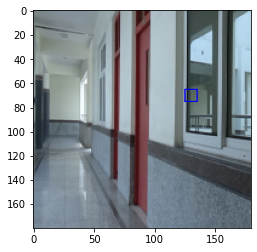

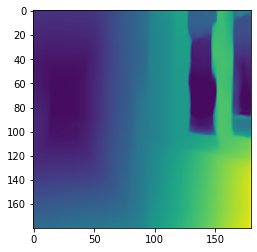

(65.49328449328571, 86.07081807081981)
53 (65.49328449328571, 86.07081807081981) turn left 0.4975 0.04656679999999369 0.20758259999999495 correct
(66.57396825397025, 27.869841269842084)
54 (66.57396825397025, 27.869841269842084) turn left 0.15833333333333333 0.046100999999993064 0.23501290000001518 correct
(60.04715047150679, 86.89831898319262)
55 (60.04715047150679, 86.89831898319262) turn left 0.48083333333333333 0.04636990000000196 0.27610530000001177 correct
(75.95692307692511, 24.86000000000066)
56 (75.95692307692511, 24.86000000000066) turn left 0.1575 0.09832309999998756 0.2764037999999971 correct
(89.4568054692382, 27.76507147296537)
57 (89.4568054692382, 27.76507147296537) turn left 0.15416666666666667 0.09481499999998277 0.29313099999998826 correct
(75.50304012971473, 159.83177948926394)
58 (75.50304012971473, 159.83177948926394) turn right 0.8275 0.09324309999999514 0.33811620000000175 correct
(81.55367231638667, 14.942090395480701)
59 (81.55367231638667, 14.942090395480701)

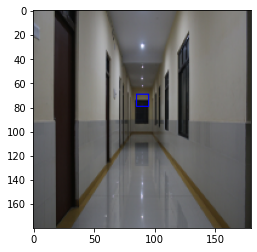

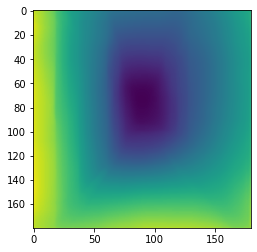

(71.28876508820969, 35.38811513463417)
88 (71.28876508820969, 35.38811513463417) turn left 0.20833333333333334 0.09357890000001134 0.26182940000001054 correct
(34.48821182444815, 17.288719622778935)
89 (34.48821182444815, 17.288719622778935) turn left 0.1875 0.09158430000002227 0.3203395000000171 correct
(76.12108262108387, 87.41595441595592)
90 (76.12108262108387, 87.41595441595592) turn left 0.4875 0.09064090000001102 0.2469739000000004 correct
(94.98606115108213, 12.142985611511207)
91 (94.98606115108213, 12.142985611511207) turn left 0.1575 0.09084279999999012 0.2998182999999983 correct
(65.41962214120231, 137.61153463706142)
92 (65.41962214120231, 137.61153463706142) turn right 0.7758333333333334 0.09061189999999897 0.3287405000000092 correct
(83.4403162055359, 27.110671936759637)
93 (83.4403162055359, 27.110671936759637) turn left 0.15416666666666667 0.04577140000000668 0.22439260000001582 correct
(71.84891406987884, 86.74315391879345)
94 (71.84891406987884, 86.74315391879345) tu

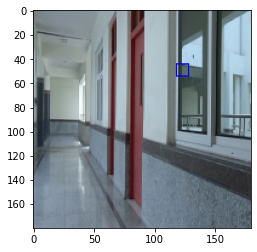

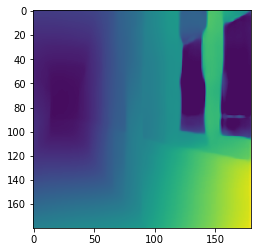

(83.70721205597667, 16.97524219591009)
105 (83.70721205597667, 16.97524219591009) turn left 0.1675 0.09252340000000459 0.29030230000000756 correct
(82.18123496391549, 144.82999198075794)
106 (82.18123496391549, 144.82999198075794) turn right 0.805 0.09110510000002137 0.26664680000001795 correct
(69.68367346938884, 142.39795918367565)
107 (69.68367346938884, 142.39795918367565) turn right 0.8025 0.09019739999999388 0.24521860000001539 correct
(36.395095367848626, 87.76737057221008)
108 (36.395095367848626, 87.76737057221008) turn left 0.48833333333333334 0.04603789999998753 0.2827508000000023 correct
(75.9247211895929, 83.22955390334774)
109 (75.9247211895929, 83.22955390334774) turn left 0.4708333333333333 0.04601579999999217 0.21457140000001118 correct
(69.5601562500017, 86.50312500000243)
110 (69.5601562500017, 86.50312500000243) turn left 0.4875 0.045664799999997285 0.22395999999997684 correct
(71.3413838120125, 142.21736292428614)
111 (71.3413838120125, 142.21736292428614) turn rig

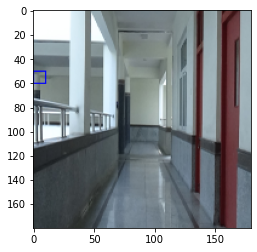

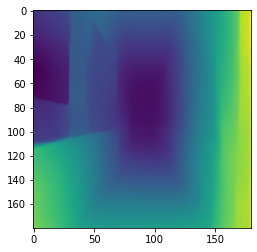

(48.96045918367514, 90.45758928571719)
116 (48.96045918367514, 90.45758928571719) turn right 0.49916666666666665 0.09155659999998988 0.33614950000000476 wrong


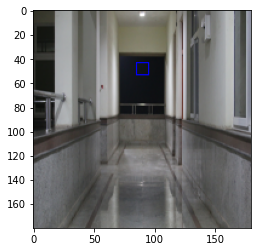

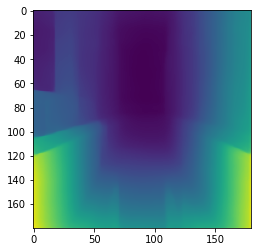

(70.8654153354656, 144.99400958466924)
117 (70.8654153354656, 144.99400958466924) turn right 0.8008333333333333 0.09780789999999229 0.31829859999999144 correct
(74.8315175097301, 129.15058365759177)
118 (74.8315175097301, 129.15058365759177) turn right 0.7225 0.09498790000000668 0.316245600000002 correct
(71.25647668393987, 98.41580310881093)
119 (71.25647668393987, 98.41580310881093) turn right 0.5466666666666666 0.09289479999998207 0.27783469999999966 correct
(57.75513698630292, 87.01969178082419)
120 (57.75513698630292, 87.01969178082419) turn left 0.48833333333333334 0.09250149999999735 0.2639423999999906 correct
(73.34320323015002, 25.673620457605036)
121 (73.34320323015002, 25.673620457605036) turn left 0.14333333333333334 0.09091960000000654 0.27413930000000164 correct
(80.9388280746966, 146.4307791371582)
122 (80.9388280746966, 146.4307791371582) turn right 0.8033333333333333 0.09026839999998515 0.27814199999997413 correct
(71.27536231884154, 174.9758454106303)
123 (71.27536231

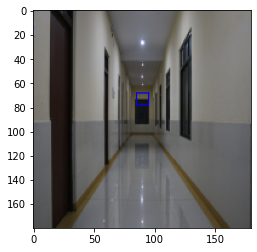

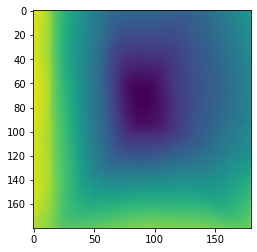

(74.97888563050077, 150.00821114369919)
142 (74.97888563050077, 150.00821114369919) turn right 0.8283333333333334 0.09308200000000966 0.2844220000000064 correct
(79.06956521739338, 26.19316770186413)
143 (79.06956521739338, 26.19316770186413) turn left 0.175 0.09147659999999291 0.2781585999999834 correct
(76.27857878476009, 26.098352214212948)
144 (76.27857878476009, 26.098352214212948) turn left 0.175 0.09132029999997826 0.2902445 correct
(73.65748587570815, 98.27330508474837)
145 (73.65748587570815, 98.27330508474837) turn right 0.5466666666666666 0.09095890000000395 0.27194769999999835 correct
(76.45117845118023, 82.61195286195505)
146 (76.45117845118023, 82.61195286195505) turn left 0.4708333333333333 0.09058650000000057 0.262776400000007 correct
(79.99847560975809, 144.08079268293093)
147 (79.99847560975809, 144.08079268293093) turn right 0.7958333333333333 0.045864000000023 0.22726590000002034 correct
(69.01395348837434, 20.671162790698308)
148 (69.01395348837434, 20.671162790698

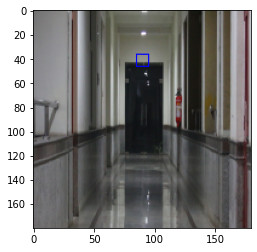

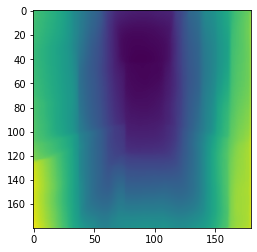

(71.13253012048347, 83.54618473895772)
160 (71.13253012048347, 83.54618473895772) turn left 0.4766666666666667 0.09778940000001057 0.2642417000000137 correct
(74.16107382550501, 87.22914669223603)
161 (74.16107382550501, 87.22914669223603) turn left 0.4841666666666667 0.09777969999998959 0.26442289999999957 correct
(76.66059817945536, 84.81924577373361)
162 (76.66059817945536, 84.81924577373361) turn left 0.4766666666666667 0.09775559999999928 0.25767719999998917 correct
(83.8067438349293, 158.19828887771038)
163 (83.8067438349293, 158.19828887771038) turn right 0.8275 0.09712780000000976 0.29734249999998497 correct
(75.21900600764816, 150.0141998907743)
164 (75.21900600764816, 150.0141998907743) turn right 0.8283333333333334 0.09448929999999223 0.2872480000000053 correct
(60.60914612361781, 148.36012861736853)
165 (60.60914612361781, 148.36012861736853) turn right 0.7916666666666666 0.0926360999999929 0.3220380999999861 correct
(75.42719546742413, 153.16373937677517)
166 (75.427195467

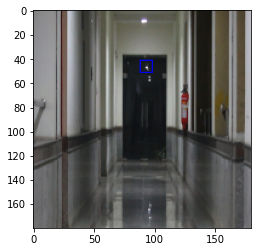

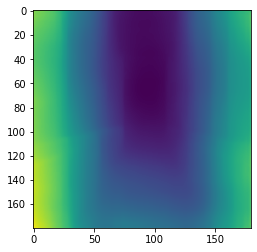

(72.76508820798745, 23.857938718663718)
182 (72.76508820798745, 23.857938718663718) turn left 0.175 0.0903479000000118 0.299977900000016 correct
(65.7540983606577, 82.78032786885511)
183 (65.7540983606577, 82.78032786885511) turn left 0.48083333333333333 0.04553129999999328 0.23042159999999967 correct
(55.79675738274644, 131.14591777649503)
184 (55.79675738274644, 131.14591777649503) turn right 0.7183333333333334 0.04582540000001245 0.23518420000002038 correct
(58.43543046357783, 87.36258278145931)
185 (58.43543046357783, 87.36258278145931) turn left 0.48833333333333334 0.0455545000000086 0.21872350000001006 correct
(83.43362695100286, 140.69448307833267)
186 (83.43362695100286, 140.69448307833267) turn right 0.7758333333333334 0.045979500000015605 0.4067565000000002 correct
(55.482334869433664, 90.68202764977242)
187 (55.482334869433664, 90.68202764977242) turn right 0.4975 0.09764190000001349 0.29661740000000236 wrong


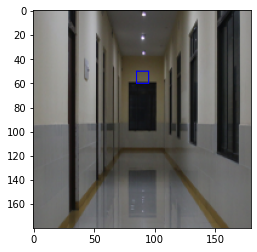

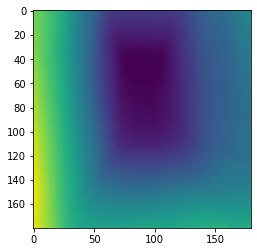

(79.60356564019725, 18.63403565640254)
188 (79.60356564019725, 18.63403565640254) turn left 0.23416666666666666 0.09558670000001257 0.3358393000000035 correct
(73.51886440045078, 80.41688457228531)
189 (73.51886440045078, 80.41688457228531) turn left 0.455 0.0935605000000237 0.31955010000001494 correct
(75.72447325770045, 24.795786061588988)
190 (75.72447325770045, 24.795786061588988) turn left 0.1675 0.09307060000000433 0.2672699000000023 correct
(66.65873605948143, 154.76654275093358)
191 (66.65873605948143, 154.76654275093358) turn right 0.8708333333333333 0.09135019999999372 0.2682356999999911 correct
(57.98148148148319, 131.18750000000364)
192 (57.98148148148319, 131.18750000000364) turn right 0.7183333333333334 0.09011689999999817 0.2670030999999824 correct
(74.50190597204778, 98.54955527319197)
193 (74.50190597204778, 98.54955527319197) turn right 0.5466666666666666 0.04597540000000322 0.2310220999999899 correct
(77.80696517413124, 82.82885572139497)
(67.28124999999996, 176.2812

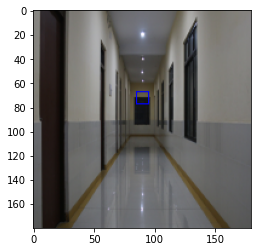

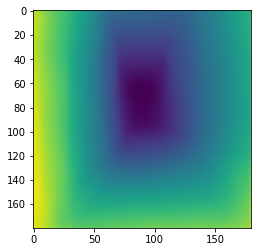

(73.70487804878307, 160.8815331010505)
202 (73.70487804878307, 160.8815331010505) turn right 0.7958333333333333 0.09298259999999914 0.325800600000008 correct
(80.85591506572551, 19.600101112235166)
203 (80.85591506572551, 19.600101112235166) turn left 0.1575 0.09152710000000752 0.29265090000001237 correct
(63.51257179323357, 88.44735162731067)
204 (63.51257179323357, 88.44735162731067) turn left 0.49083333333333334 0.0912428000000034 0.4978279999999984 correct
(114.0, 24.5)
(115.00000000000001, 21.5)
205 (114.0, 24.5) turn left 0.82 0.09034030000000826 0.2211484999999982 wrong


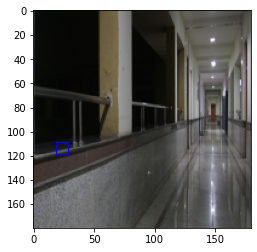

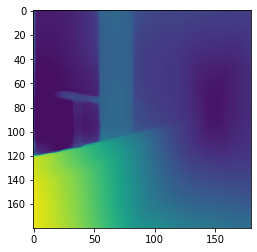

(71.89839572192714, 86.32620320855878)
206 (71.89839572192714, 86.32620320855878) turn left 0.4816666666666667 0.0456172999999751 0.23036549999997646 correct
(0.0, 179.0)
(57.968563988089194, 152.85937499998334)
207 (57.968563988089194, 152.85937499998334) turn right 0.8383333333333334 0.045798399999995354 0.36989339999999515 correct
(72.70238095238304, 98.73809523809803)
208 (72.70238095238304, 98.73809523809803) turn right 0.5466666666666666 0.046346200000016324 0.2395815000000141 correct
(87.12180629827942, 36.872251931076605)
209 (87.12180629827942, 36.872251931076605) turn left 0.225 0.045593599999989465 0.2360488999999859 correct
(88.7772925764217, 23.28002183406181)
210 (88.7772925764217, 23.28002183406181) turn left 0.14333333333333334 0.09790750000001935 0.29288080000000605 correct
(88.72822040208756, 37.614296351453035)
211 (88.72822040208756, 37.614296351453035) turn left 0.225 0.09785769999999161 0.27597979999998756 correct
(68.34313725490246, 40.97058823529445)
212 (68.343

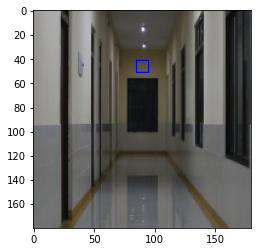

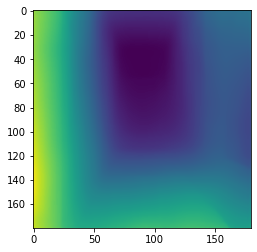

(72.94424552429903, 20.167774936062006)
218 (72.94424552429903, 20.167774936062006) turn left 0.1575 0.046098799999981566 0.25098639999998795 correct
(56.3629777214209, 31.346676326748785)
219 (56.3629777214209, 31.346676326748785) turn left 0.1825 0.09731830000001196 0.4253109000000279 correct
(68.80926130099371, 88.986769570013)
220 (68.80926130099371, 88.986769570013) turn left 0.4975 0.09443450000000553 0.2601833999999883 correct
(12.0, 160.0)
(13.0, 159.0)
(14.0, 156.0)
(15.0, 155.0)
(17.0, 151.0)
(19.0, 148.0)
(47.00000000000001, 171.0)
(52.0, 143.0)
(60.00000000000001, 171.00000000000003)
(67.0, 171.0)
(86.0, 149.5)
221 (52.0, 143.0) turn right 0.1375 0.09247199999998656 0.22372059999997873 wrong


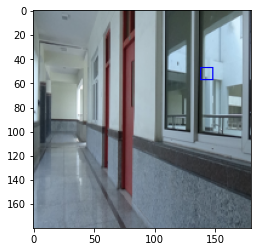

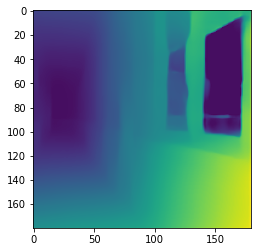

(71.63390663390791, 142.9275184275213)
222 (71.63390663390791, 142.9275184275213) turn right 0.8025 0.09104650000000447 0.25090000000000146 correct
(65.30718954248559, 85.30065359477402)
223 (65.30718954248559, 85.30065359477402) turn left 0.4841666666666667 0.09037309999999366 0.2802408000000014 correct
(65.25039001560239, 86.05928237129721)
224 (65.25039001560239, 86.05928237129721) turn left 0.4975 0.04555279999999584 0.22179570000000126 correct
(71.1845124282999, 39.1845124282993)
225 (71.1845124282999, 39.1845124282993) turn left 0.23416666666666666 0.04532509999998524 0.21321969999999624 correct
(65.73274739583564, 144.43815104167163)
226 (65.73274739583564, 144.43815104167163) turn right 0.8008333333333333 0.04519880000000853 0.29007769999998345 correct
(73.89083419155666, 38.116374871267666)
227 (73.89083419155666, 38.116374871267666) turn left 0.23416666666666666 0.045437000000021044 0.2108644000000197 correct
(75.85659838018343, 15.633635064316817)
228 (75.85659838018343, 15.

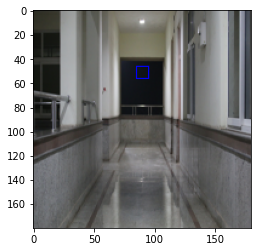

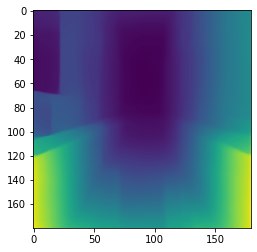

(70.785550458717, 85.10435779816684)
236 (70.785550458717, 85.10435779816684) turn left 0.47333333333333333 0.04608310000000415 0.21022170000000528 correct
(72.05015673981346, 87.63845350052445)
237 (72.05015673981346, 87.63845350052445) turn left 0.4875 0.0461296999999945 0.2103155000000072 correct
(57.28617886179034, 86.73414634146582)
238 (57.28617886179034, 86.73414634146582) turn left 0.48833333333333334 0.04583329999999819 0.2216480999999817 correct
(64.75806451613074, 82.60923753665932)
239 (64.75806451613074, 82.60923753665932) turn left 0.48083333333333333 0.09702010000000882 0.27748560000000566 correct
(58.81443298969245, 86.74306106265108)
240 (58.81443298969245, 86.74306106265108) turn left 0.48833333333333334 0.0942094000000111 0.2694270000000074 correct
(62.83211678832246, 87.41501564129499)
241 (62.83211678832246, 87.41501564129499) turn left 0.4975 0.09442169999999805 0.2605246999999906 correct
(59.718989280246916, 33.527565084227575)
242 (59.718989280246916, 33.5275650

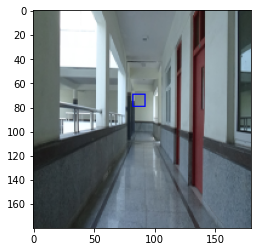

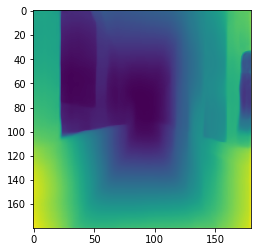

(79.74296028881092, 143.96389891697171)
255 (79.74296028881092, 143.96389891697171) turn right 0.7958333333333333 0.09205449999998905 0.27161219999999275 correct
(82.65604352895733, 159.25923047027374)
256 (82.65604352895733, 159.25923047027374) turn right 0.8275 0.09075569999998834 0.3138015999999766 correct
(70.64153846153945, 143.73692307692508)
257 (70.64153846153945, 143.73692307692508) turn right 0.8025 0.09016330000002881 0.24266310000001567 correct
(70.16068222621361, 25.863554757630794)
258 (70.16068222621361, 25.863554757630794) turn left 0.175 0.0903201000000422 0.26014800000001514 correct
(63.39020878329921, 87.37077033837559)
259 (63.39020878329921, 87.37077033837559) turn left 0.49583333333333335 0.09042990000000373 0.268845400000032 correct
(73.95042897998245, 36.18303145853285)
260 (73.95042897998245, 36.18303145853285) turn left 0.20833333333333334 0.09027520000000777 0.25841830000001664 correct
(69.40078917700318, 30.543968432920884)
261 (69.40078917700318, 30.5439684

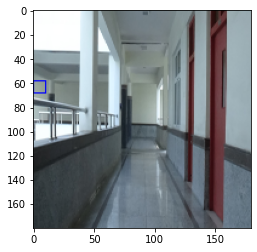

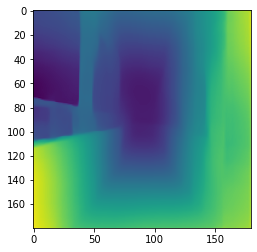

(33.20673076923142, 173.88822115384946)
267 (33.20673076923142, 173.88822115384946) turn right 0.8008333333333333 0.04630859999997483 0.20539079999997512 correct
(77.1704697986597, 22.84161073825566)
268 (77.1704697986597, 22.84161073825566) turn left 0.1675 0.046457399999951576 0.2310926999999765 correct
(70.36224219989646, 157.1036488630407)
(57.99999999999999, 178.375)
269 (70.36224219989646, 157.1036488630407) turn right 0.8683333333333333 0.046163199999966764 0.24422249999997803 correct
(71.61178369653142, 153.74495560936646)
270 (71.61178369653142, 153.74495560936646) turn right 0.8708333333333333 0.04630940000004102 0.2207567000000381 correct
(63.18464646464876, 86.88202020202301)
271 (63.18464646464876, 86.88202020202301) turn left 0.4816666666666667 0.09785049999999273 0.316441999999995 correct
(61.27097327425554, 94.66028297841164)
272 (61.27097327425554, 94.66028297841164) turn right 0.49083333333333334 0.09426179999996975 0.4745999999999526 wrong


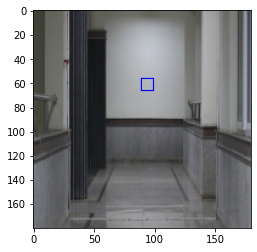

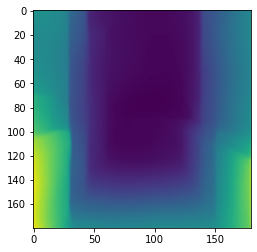

(73.7416719044648, 25.665619107480328)
273 (73.7416719044648, 25.665619107480328) turn left 0.14333333333333334 0.0923897999999781 0.27935940000003257 correct
(84.2759900990123, 8.995049504950778)
274 (84.2759900990123, 8.995049504950778) turn left 0.1675 0.09248429999996688 0.2803025999999704 correct
(75.70892018779493, 86.90962441314738)
275 (75.70892018779493, 86.90962441314738) turn left 0.4841666666666667 0.09249319999997851 0.25230319999997164 correct
(82.44043321299822, 78.85078219013405)
276 (82.44043321299822, 78.85078219013405) turn left 0.455 0.09181160000002819 0.2509823000000324 correct
(77.03420074349651, 142.78810408922337)
277 (77.03420074349651, 142.78810408922337) turn right 0.8 0.09102419999999256 0.2686037000000283 correct
(68.01594202898775, 159.6913043478314)
278 (68.01594202898775, 159.6913043478314) turn right 0.8683333333333333 0.04598440000000892 0.25452359999997043 correct
(85.00525394045802, 101.98598949212234)
279 (85.00525394045802, 101.98598949212234) tur

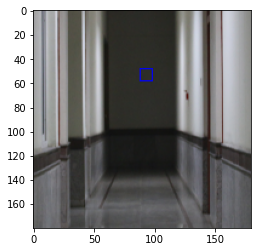

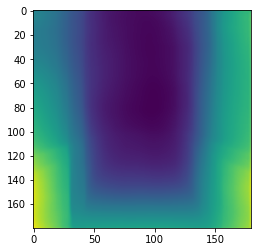

theta_AOI:  30
theta_y:  0
Number of Frames:  300
Predicted count:  300
Unable to Predict count:  0
Correct Decision count:  279
Average Inference Time(s) 0.2746785710000004
Mean Squared Error:  0.010748161853942676
Mean Absolute Error:  0.03780572471281882
Mean Squared Error including unpredicted:  0.010748161853942676
Mean Absolute Error including unpredicted:  0.03780572471281882
Accuracy:  0.93
Discernibility 1.0
theta_AOI:  30
theta_y:  0
Number of Frames:  300
Predicted count: 
[[300.]
 [300.]
 [  0.]
 [  0.]
 [  0.]
 [  0.]
 [  0.]
 [  0.]
 [  0.]
 [  0.]]
Unable to Predict count: 
[[0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]]
Correct Decision count: 
[[282.]
 [279.]
 [  0.]
 [  0.]
 [  0.]
 [  0.]
 [  0.]
 [  0.]
 [  0.]
 [  0.]]
Average Inference Time(s)
[[0.23703881]
 [0.27467857]
 [0.        ]
 [0.        ]
 [0.        ]
 [0.        ]
 [0.        ]
 [0.        ]
 [0.        ]
 [0.        ]]
Average Depth Inference Time(s)
[[0.08141435]
 [0.07734131]
 [0.      

(76.26430755788799, 82.7287024901732)
(62.06645569620236, 175.09810126582232)
43 (76.26430755788799, 82.7287024901732) turn left 0.4708333333333333 0.0932425999999964 0.3223363999999833 correct
(70.28318584071005, 138.3008849557564)
44 (70.28318584071005, 138.3008849557564) turn right 0.7758333333333334 0.045669900000007146 0.2495086999999785 correct
(78.7451564828637, 145.70889220069952)
45 (78.7451564828637, 145.70889220069952) turn right 0.8033333333333333 0.04540320000000975 0.24758810000002995 correct
(61.422197225349045, 86.07761529809044)
46 (61.422197225349045, 86.07761529809044) turn left 0.48083333333333333 0.04530539999996108 0.274475099999961 correct
(56.982366470736515, 26.146690518782624)
47 (56.982366470736515, 26.146690518782624) turn left 0.1975 0.045395799999994324 0.31524100000001454 correct
(63.793616090951154, 141.1031919545302)
48 (63.793616090951154, 141.1031919545302) turn right 0.7916666666666666 0.09640929999994796 0.31052719999996725 correct
(92.4065075921932

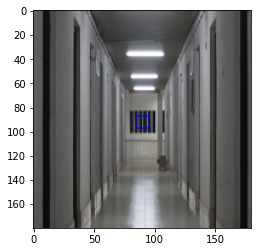

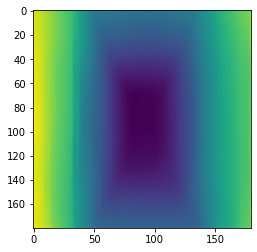

(77.9052701801222, 146.7705136757882)
50 (77.9052701801222, 146.7705136757882) turn right 0.8258333333333333 0.09386729999999943 0.27714609999998174 correct
(75.82548227905143, 149.70165993719627)
51 (75.82548227905143, 149.70165993719627) turn right 0.8283333333333334 0.09799220000002151 0.30875539999999546 correct
(70.80214723926473, 139.24846625767086)
(71.22408963585545, 24.612044817927597)
(73.07432432432418, 174.9932432432429)
52 (70.80214723926473, 139.24846625767086) turn right 0.1375 0.09776349999998502 0.28170149999999694 wrong


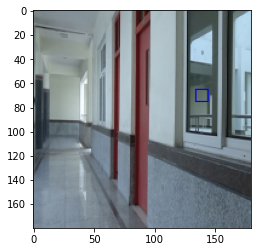

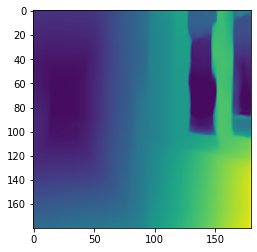

(67.99529411764887, 86.18588235294361)
53 (67.99529411764887, 86.18588235294361) turn left 0.4975 0.09499049999999443 0.27403639999999996 correct
(67.58586232420672, 26.28941524796541)
54 (67.58586232420672, 26.28941524796541) turn left 0.15833333333333333 0.09280230000001666 0.31933040000001256 correct
(59.940343476951824, 86.94817716179709)
55 (59.940343476951824, 86.94817716179709) turn left 0.48083333333333333 0.09133949999994684 0.3390715999999543 correct
(74.80605786618686, 23.034810126583)
56 (74.80605786618686, 23.034810126583) turn left 0.1575 0.09137019999997165 0.2997968999999898 correct
(90.05166374781393, 27.99387040280302)
57 (90.05166374781393, 27.99387040280302) turn left 0.15416666666666667 0.09070940000003702 0.30407869999999093 correct
(76.09273107986918, 159.26084355369548)
58 (76.09273107986918, 159.26084355369548) turn right 0.8275 0.09060100000004923 0.3423586000000114 correct
(79.46188980873507, 17.77904653154434)
59 (79.46188980873507, 17.77904653154434) turn l

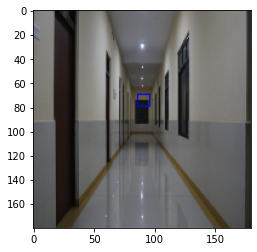

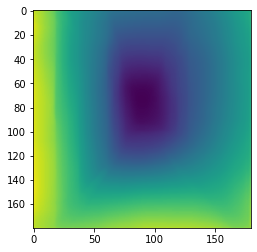

(70.12903225806672, 35.38005865102748)
88 (70.12903225806672, 35.38005865102748) turn left 0.20833333333333334 0.0930103000000031 0.28375190000002704 correct
(42.63640542403784, 22.367271891517795)
89 (42.63640542403784, 22.367271891517795) turn left 0.1875 0.09149959999996327 0.3782939999999826 correct
(76.03268551236928, 87.53445229682202)
90 (76.03268551236928, 87.53445229682202) turn left 0.4875 0.09026129999995192 0.25987559999998666 correct
(90.84569662386568, 18.3711364717061)
91 (90.84569662386568, 18.3711364717061) turn left 0.1575 0.09033260000001064 0.36979830000001357 correct
(69.26025844479302, 138.04126048514212)
92 (69.26025844479302, 138.04126048514212) turn right 0.7758333333333334 0.045271200000001954 0.334184300000004 correct
(81.94142480211312, 26.871240105541688)
93 (81.94142480211312, 26.871240105541688) turn left 0.15416666666666667 0.045266499999968346 0.24471660000000384 correct
(72.27983539094855, 86.94473838918552)
94 (72.27983539094855, 86.94473838918552) tu

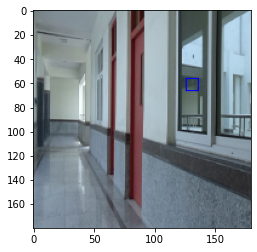

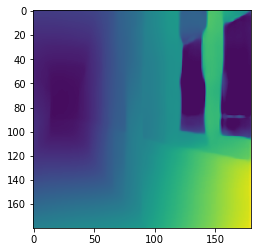

(84.18819719323811, 17.013673983447838)
105 (84.18819719323811, 17.013673983447838) turn left 0.1675 0.09075439999998025 0.3215083999999706 correct
(81.41708542713805, 144.64489112228227)
106 (81.41708542713805, 144.64489112228227) turn right 0.805 0.09118669999998019 0.2846374999999739 correct
(68.01954397394313, 142.96009771987383)
107 (68.01954397394313, 142.96009771987383) turn right 0.8025 0.09030849999999191 0.26424209999998993 correct
(25.86585365853658, 3.3682926829268194)
(39.5009216589839, 86.84861751151557)
108 (39.5009216589839, 86.84861751151557) turn left 0.48833333333333334 0.045298099999968144 0.34711749999996755 correct
(74.42267502612567, 83.84639498432885)
109 (74.42267502612567, 83.84639498432885) turn left 0.4708333333333333 0.04526110000000472 0.2426608000000101 correct
(70.87009063444324, 86.25679758308443)
110 (70.87009063444324, 86.25679758308443) turn left 0.4875 0.045297199999993154 0.2499104999999986 correct
(72.20552147239512, 142.64672801636434)
111 (72.20

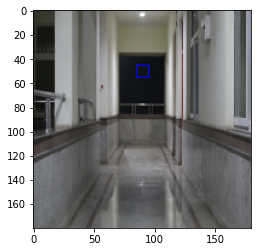

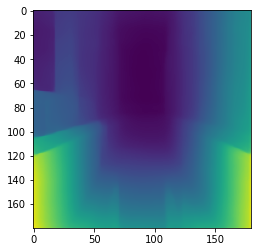

(70.9892638036828, 146.04386503067798)
117 (70.9892638036828, 146.04386503067798) turn right 0.8008333333333333 0.04597350000000233 0.291447699999992 correct
(75.19720241360308, 129.67279210093065)
118 (75.19720241360308, 129.67279210093065) turn right 0.7225 0.045777499999985594 0.30728099999998904 correct
(70.21730769230993, 99.01298076923379)
119 (70.21730769230993, 99.01298076923379) turn right 0.5466666666666666 0.04596589999999878 0.25304439999996475 correct
(55.817023740592425, 86.03821656051237)
120 (55.817023740592425, 86.03821656051237) turn left 0.48833333333333334 0.09787979999998697 0.2894139999999652 correct
(71.71549045717053, 25.359520639148638)
121 (71.71549045717053, 25.359520639148638) turn left 0.14333333333333334 0.0978008000000159 0.3078945000000317 correct
(82.18869309838753, 148.32268722467472)
122 (82.18869309838753, 148.32268722467472) turn right 0.8033333333333333 0.09512080000001788 0.3228076999999985 correct
(65.68433734939929, 172.69879518072742)
123 (65.6

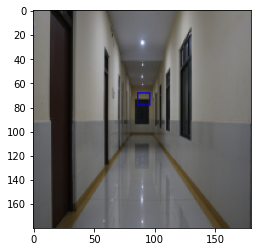

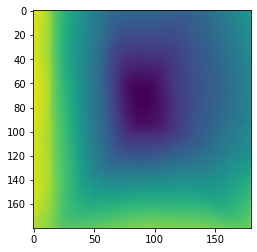

(73.87917194761542, 150.20363329109063)
142 (73.87917194761542, 150.20363329109063) turn right 0.8283333333333334 0.09100689999996803 0.3059056999999825 correct
(79.50807136788673, 25.716652506372988)
143 (79.50807136788673, 25.716652506372988) turn left 0.175 0.09420069999998759 0.31098830000001954 correct
(79.72420321868334, 23.43988639949582)
144 (79.72420321868334, 23.43988639949582) turn left 0.175 0.09203860000002351 0.33435890000004065 correct
(74.76958059626291, 98.81354219302968)
145 (74.76958059626291, 98.81354219302968) turn right 0.5466666666666666 0.0908207999999604 0.29398820000000114 correct
(75.36054054054266, 83.41081081081364)
146 (75.36054054054266, 83.41081081081364) turn left 0.4708333333333333 0.0904997000000094 0.2871233999999845 correct
(80.23670490094092, 144.25443169969125)
147 (80.23670490094092, 144.25443169969125) turn right 0.7958333333333333 0.046296799999993254 0.24700080000002345 correct
(71.48015634395804, 20.63018641010251)
148 (71.48015634395804, 20.

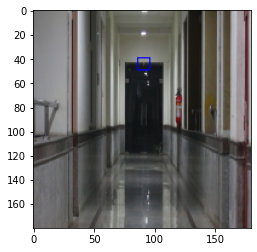

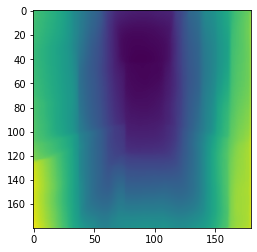

(70.07858428314533, 83.3515296940639)
160 (70.07858428314533, 83.3515296940639) turn left 0.4766666666666667 0.045595300000002226 0.23572230000002037 correct
(74.95074530136309, 86.26117952041753)
161 (74.95074530136309, 86.26117952041753) turn left 0.4841666666666667 0.0964476999999988 0.2809234999999717 correct
(75.51739788199899, 84.51664145234732)
162 (75.51739788199899, 84.51664145234732) turn left 0.4766666666666667 0.09299379999998791 0.27000810000004094 correct
(85.46114344402801, 158.9041424169857)
163 (85.46114344402801, 158.9041424169857) turn right 0.8275 0.09161030000001347 0.3259806000000367 correct
(74.38961038961266, 150.20941558442058)
164 (74.38961038961266, 150.20941558442058) turn right 0.8283333333333334 0.09141799999997602 0.3102018999999814 correct
(58.859445958216554, 151.81448683014466)
165 (58.859445958216554, 151.81448683014466) turn right 0.7916666666666666 0.09061950000000252 0.3769131000000243 correct
(72.226032735778, 153.49181605612353)
166 (72.226032735

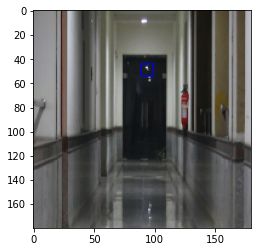

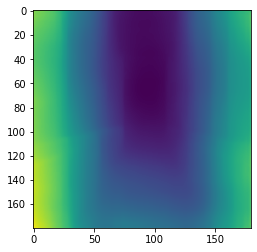

(72.231897067625, 21.750448833034383)
182 (72.231897067625, 21.750448833034383) turn left 0.175 0.045960900000011407 0.29749160000000074 correct
(65.21175950486528, 82.66799292661653)
183 (65.21175950486528, 82.66799292661653) turn left 0.48083333333333333 0.04589010000000826 0.2583575999999539 correct
(53.415206857996985, 132.57845695117842)
184 (53.415206857996985, 132.57845695117842) turn right 0.7183333333333334 0.09696650000000773 0.32322450000003755 correct
(56.52155936208094, 86.9243945658621)
185 (56.52155936208094, 86.9243945658621) turn left 0.48833333333333334 0.0938735999999949 0.28273349999994934 correct
(0.0, 179.0)
(81.31761759582123, 139.7762412892033)
186 (81.31761759582123, 139.7762412892033) turn right 0.7758333333333334 0.09219749999999749 0.6898788999999965 correct
(59.27606951871879, 91.38235294117965)
187 (59.27606951871879, 91.38235294117965) turn right 0.4975 0.09232649999995601 0.3286058999999568 wrong


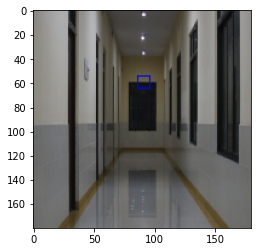

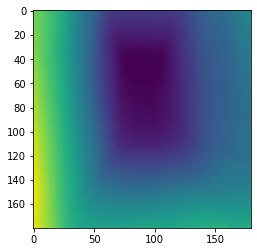

(77.80622986035947, 21.306766917291554)
188 (77.80622986035947, 21.306766917291554) turn left 0.23416666666666666 0.09217989999996234 0.3885320999999635 correct
(74.24677871148407, 80.36386554621785)
189 (74.24677871148407, 80.36386554621785) turn left 0.455 0.09087820000002012 0.34927790000000414 correct
(78.47373147732628, 20.921418949259767)
190 (78.47373147732628, 20.921418949259767) turn left 0.1675 0.046161700000027395 0.2561681000000249 correct
(69.942092457423, 155.10608272506605)
191 (69.942092457423, 155.10608272506605) turn right 0.8708333333333333 0.04626330000002099 0.25076649999999745 correct
(55.71244855967275, 132.34053497942799)
192 (55.71244855967275, 132.34053497942799) turn right 0.7183333333333334 0.046179899999970075 0.24541289999996252 correct
(74.90371697268499, 99.05866547246193)
193 (74.90371697268499, 99.05866547246193) turn right 0.5466666666666666 0.04620840000001181 0.2559147999999709 correct
(64.95975232198228, 169.74767801857826)
(78.33779477374344, 83.1

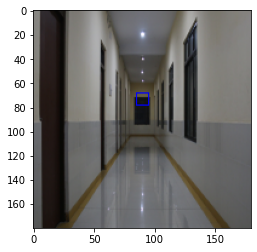

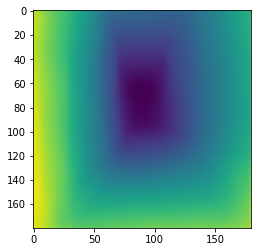

(72.5677095227179, 156.3503082895537)
202 (72.5677095227179, 156.3503082895537) turn right 0.7958333333333333 0.045476399999984096 0.332894500000009 correct
(81.53499549414346, 21.202463202163116)
203 (81.53499549414346, 21.202463202163116) turn left 0.1575 0.04558900000000676 0.2941308000000049 correct
(64.83155923516996, 89.92055982653838)
204 (64.83155923516996, 89.92055982653838) turn left 0.49083333333333334 0.04552890000002208 0.6794125000000122 correct
(81.85114045618474, 15.000600240096503)
205 (81.85114045618474, 15.000600240096503) turn left 0.82 0.09781450000002678 0.2869860999999787 wrong


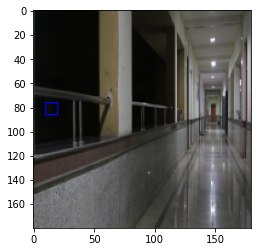

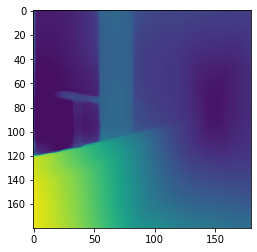

(72.69505494505749, 85.7857142857171)
206 (72.69505494505749, 85.7857142857171) turn left 0.4816666666666667 0.0981454999999869 0.3056455999999912 correct
(59.158344785456855, 151.14017407236042)
207 (59.158344785456855, 151.14017407236042) turn right 0.8383333333333334 0.09783420000002252 0.4627010000000382 correct
(72.60424966799691, 99.07746790615656)
208 (72.60424966799691, 99.07746790615656) turn right 0.5466666666666666 0.09487339999998312 0.304649999999981 correct
(86.20786933927543, 35.86896807720972)
209 (86.20786933927543, 35.86896807720972) turn left 0.225 0.0930819000000156 0.3191497000000254 correct
(84.57838364167732, 23.15903927296414)
210 (84.57838364167732, 23.15903927296414) turn left 0.14333333333333334 0.09138830000000553 0.3303340000000503 correct
(85.82133333333597, 36.79644444444558)
211 (85.82133333333597, 36.79644444444558) turn left 0.225 0.09149019999995289 0.3050693999999794 correct
(67.2389162561589, 40.59852216748856)
212 (67.2389162561589, 40.598522167488

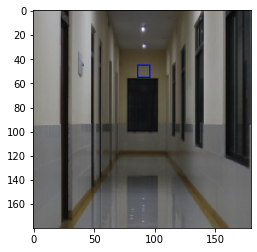

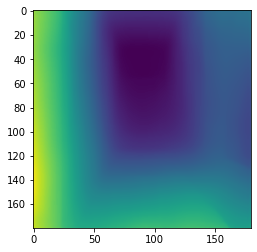

(70.49536707056555, 21.682109764790486)
218 (70.49536707056555, 21.682109764790486) turn left 0.1575 0.09488290000001598 0.3255541999999991 correct
(58.398369162336806, 31.64269829503029)
219 (58.398369162336806, 31.64269829503029) turn left 0.1825 0.09456230000000687 0.4634667000000263 correct
(69.46858440575505, 89.44133232399945)
220 (69.46858440575505, 89.44133232399945) turn left 0.4975 0.09258359999995491 0.2698264999999651 correct
(50.48475609756262, 157.27134146341984)
(73.81355932203459, 23.36346516007554)
(90.5, 141.5)
(91.69230769230771, 162.0)
(92.90909090909092, 148.09090909090907)
221 (90.5, 141.5) turn right 0.1375 0.09114010000001826 0.3115928000000281 wrong


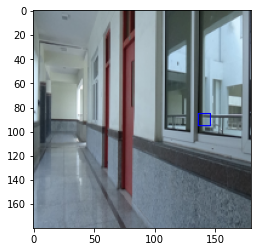

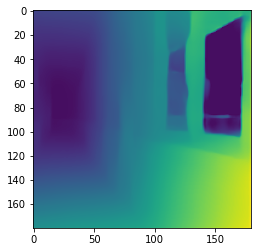

(72.38029315961107, 143.29234527687683)
222 (72.38029315961107, 143.29234527687683) turn right 0.8025 0.09035930000004555 0.2661107000000129 correct
(67.43536875495884, 86.13005551150161)
223 (67.43536875495884, 86.13005551150161) turn left 0.4841666666666667 0.09020100000003595 0.3093117000000234 correct
(68.22878625134487, 86.30612244898248)
224 (68.22878625134487, 86.30612244898248) turn left 0.4975 0.09025320000000647 0.28524360000000115 correct
(66.60368956743204, 39.28435114503942)
225 (66.60368956743204, 39.28435114503942) turn left 0.23416666666666666 0.045298300000013114 0.2336508000000208 correct
(66.56081730768923, 144.94543269230093)
226 (66.56081730768923, 144.94543269230093) turn right 0.8008333333333333 0.04527089999999134 0.32294279999996434 correct
(72.72091544819011, 37.79275270184478)
227 (72.72091544819011, 37.79275270184478) turn left 0.23416666666666666 0.045484500000043226 0.23411600000002863 correct
(75.24148714385218, 16.93815149409368)
228 (75.24148714385218, 

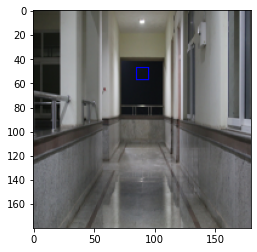

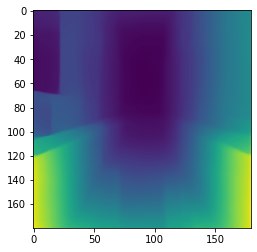

(69.71181755356106, 84.81548030407994)
236 (69.71181755356106, 84.81548030407994) turn left 0.47333333333333333 0.04561010000003307 0.22666700000002038 correct
(72.35256861365446, 87.80788177340168)
237 (72.35256861365446, 87.80788177340168) turn left 0.4875 0.04555579999998827 0.2260830000000169 correct
(55.75854584916067, 86.07216494845632)
238 (55.75854584916067, 86.07216494845632) turn left 0.48833333333333334 0.07113580000003594 0.26753669999999374 correct
(64.79201485608382, 82.55849582172986)
239 (64.79201485608382, 82.55849582172986) turn left 0.48083333333333333 0.09758540000001403 0.30388319999997293 correct
(56.0846325167056, 85.58908685969098)
240 (56.0846325167056, 85.58908685969098) turn left 0.48833333333333334 0.09454769999996415 0.2909841999999685 correct
(62.282933160287556, 87.65606748864646)
241 (62.282933160287556, 87.65606748864646) turn left 0.4975 0.09233659999995325 0.2766542999999615 correct
(58.77431539188136, 32.75590179414648)
(60.00000000000001, 2.0)
242 (

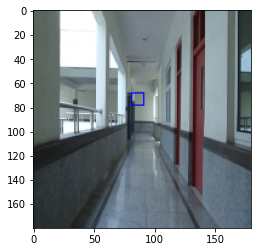

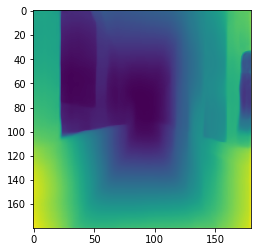

(80.25181723780092, 143.85202492212247)
255 (80.25181723780092, 143.85202492212247) turn right 0.7958333333333333 0.09065279999998666 0.2892944999999827 correct
(86.98053852305893, 159.42895227938772)
256 (86.98053852305893, 159.42895227938772) turn right 0.8275 0.09023509999997259 0.35469889999995985 correct
(68.64973730297876, 144.45709281961865)
257 (68.64973730297876, 144.45709281961865) turn right 0.8025 0.09000340000000051 0.26082210000004125 correct
(69.03311965812163, 24.310363247863975)
258 (69.03311965812163, 24.310363247863975) turn left 0.175 0.045321800000010626 0.3831369000000109 correct
(65.91704857928694, 87.71448212649238)
259 (65.91704857928694, 87.71448212649238) turn left 0.49583333333333335 0.04539230000000316 0.2567068999999833 correct
(72.23247863248085, 35.36068376068487)
260 (72.23247863248085, 35.36068376068487) turn left 0.20833333333333334 0.045340699999997014 0.23757850000004055 correct
(78.27331017899918, 24.782527384450415)
261 (78.27331017899918, 24.7825

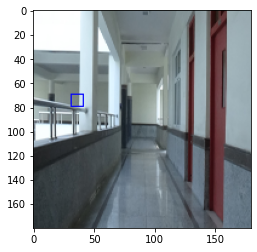

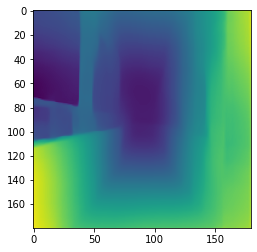

(37.042957746479885, 170.89154929577947)
267 (37.042957746479885, 170.89154929577947) turn right 0.8008333333333333 0.09046700000004648 0.27228230000002895 correct
(77.30867544539372, 20.005422153370134)
268 (77.30867544539372, 20.005422153370134) turn left 0.1675 0.045902600000033544 0.2679861000000301 correct
(70.86027111574805, 158.59506430309884)
269 (70.86027111574805, 158.59506430309884) turn right 0.8683333333333333 0.045905500000003485 0.27837460000000647 correct
(73.490318906608, 154.2448747152668)
270 (73.490318906608, 154.2448747152668) turn right 0.8708333333333333 0.04612149999996973 0.23916019999995797 correct
(65.52375500858595, 87.08700629650824)
271 (65.52375500858595, 87.08700629650824) turn left 0.4816666666666667 0.04591840000000502 0.30244310000000496 correct
(61.740331491714215, 93.89944751381469)
272 (61.740331491714215, 93.89944751381469) turn right 0.49083333333333334 0.0975109000000316 0.5499472000000196 wrong


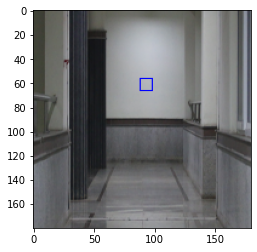

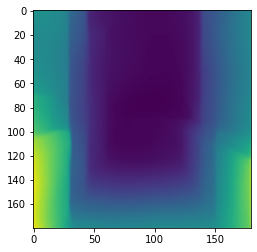

(73.20398230088723, 25.436725663717645)
273 (73.20398230088723, 25.436725663717645) turn left 0.14333333333333334 0.09487109999997756 0.3078435999999556 correct
(80.691646191648, 14.91584766584796)
274 (80.691646191648, 14.91584766584796) turn left 0.1675 0.09436970000001565 0.33981590000001916 correct
(75.23924941360643, 86.06724003127685)
275 (75.23924941360643, 86.06724003127685) turn left 0.4841666666666667 0.09273980000000392 0.27091919999998026 correct
(82.79653679653917, 79.1587301587324)
276 (82.79653679653917, 79.1587301587324) turn left 0.455 0.09254709999999022 0.27200290000001814 correct
(77.08975069252311, 142.58116343490738)
277 (77.08975069252311, 142.58116343490738) turn right 0.8 0.09249060000001919 0.28857909999999265 correct
(67.03370786517075, 158.69452247191535)
278 (67.03370786517075, 158.69452247191535) turn right 0.8683333333333333 0.09237959999995837 0.32368119999995315 correct
(82.04812998160794, 102.05272838749447)
279 (82.04812998160794, 102.05272838749447) 

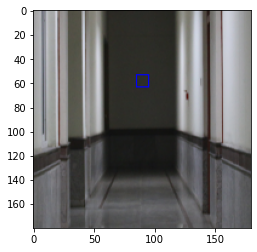

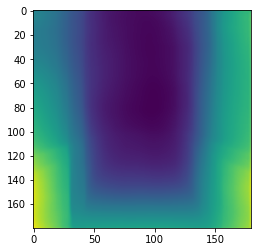

theta_AOI:  50
theta_y:  0
Number of Frames:  300
Predicted count:  300
Unable to Predict count:  0
Correct Decision count:  282
Average Inference Time(s) 0.3116671913333291
Mean Squared Error:  0.007157810719487151
Mean Absolute Error:  0.031040447573042477
Mean Squared Error including unpredicted:  0.007157810719487151
Mean Absolute Error including unpredicted:  0.031040447573042477
Accuracy:  0.94
Discernibility 1.0
theta_AOI:  50
theta_y:  0
Number of Frames:  300
Predicted count: 
[[300.]
 [300.]
 [300.]
 [  0.]
 [  0.]
 [  0.]
 [  0.]
 [  0.]
 [  0.]
 [  0.]]
Unable to Predict count: 
[[0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]]
Correct Decision count: 
[[282.]
 [279.]
 [282.]
 [  0.]
 [  0.]
 [  0.]
 [  0.]
 [  0.]
 [  0.]
 [  0.]]
Average Inference Time(s)
[[0.23703881]
 [0.27467857]
 [0.31166719]
 [0.        ]
 [0.        ]
 [0.        ]
 [0.        ]
 [0.        ]
 [0.        ]
 [0.        ]]
Average Depth Inference Time(s)
[[0.08141435]
 [0.07734131]
 [0.0782

(74.43519736842345, 83.24210526316082)
(59.219806763285, 174.74396135265715)
43 (74.43519736842345, 83.24210526316082) turn left 0.4708333333333333 0.0980214999999589 0.3525412999999844 correct
(71.12921348314862, 137.7640449438246)
44 (71.12921348314862, 137.7640449438246) turn right 0.7758333333333334 0.09443859999998949 0.307372799999996 correct
(78.9285970577709, 145.35952637244833)
45 (78.9285970577709, 145.35952637244833) turn right 0.8033333333333333 0.09421889999998712 0.32620400000001837 correct
(61.727536231884336, 86.29826086956541)
46 (61.727536231884336, 86.29826086956541) turn left 0.48083333333333333 0.09214400000001888 0.34569179999999733 correct
(56.942300343899596, 27.00420328620279)
47 (56.942300343899596, 27.00420328620279) turn left 0.1975 0.09072429999997667 0.406556299999977 correct
(63.22472981564111, 141.13509218055142)
48 (63.22472981564111, 141.13509218055142) turn right 0.7916666666666666 0.09016929999995682 0.33259239999995316 correct
(93.37626774848214, 90

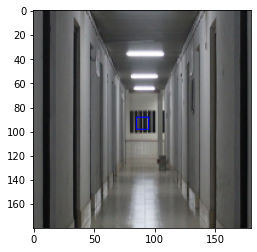

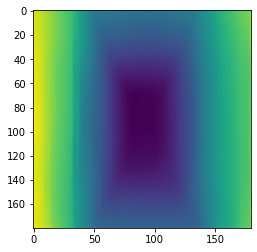

(76.42200557103291, 146.4094707520936)
50 (76.42200557103291, 146.4094707520936) turn right 0.8258333333333333 0.045284799999990355 0.2530997999999727 correct
(75.16821760916483, 150.3661417322889)
51 (75.16821760916483, 150.3661417322889) turn right 0.8283333333333334 0.04527330000001939 0.2761767000000077 correct
(70.27586206896744, 25.625331564987427)
(69.5166666666677, 139.23717948718226)
(72.18660287081322, 175.11483253588477)
52 (69.5166666666677, 139.23717948718226) turn right 0.1375 0.04553659999999127 0.26771600000000717 wrong


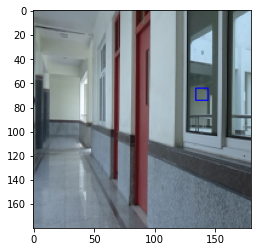

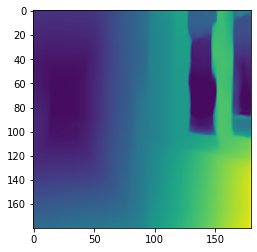

(67.72071005917368, 86.39289940828684)
53 (67.72071005917368, 86.39289940828684) turn left 0.4975 0.09769000000000005 0.28731570000002193 correct
(67.69441624365321, 24.40558375634432)
54 (67.69441624365321, 24.40558375634432) turn left 0.15833333333333333 0.09546000000000276 0.3669608000000153 correct
(60.237202925042155, 86.06375685557045)
55 (60.237202925042155, 86.06375685557045) turn left 0.48083333333333333 0.09312290000002577 0.3806139000000144 correct
(73.69141004862469, 22.657374392221236)
56 (73.69141004862469, 22.657374392221236) turn left 0.1575 0.09135470000001078 0.3312055999999757 correct
(90.46363935505413, 27.684106614018773)
57 (90.46363935505413, 27.684106614018773) turn left 0.15416666666666667 0.09107879999999113 0.32957579999998643 correct
(76.91558916808606, 158.27421322272897)
58 (76.91558916808606, 158.27421322272897) turn right 0.8275 0.09055910000000722 0.3667824000000337 correct
(81.78272804053385, 20.00717905405243)
59 (81.78272804053385, 20.00717905405243)

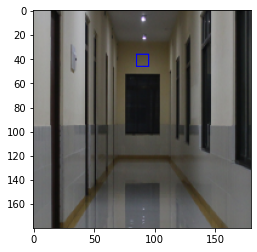

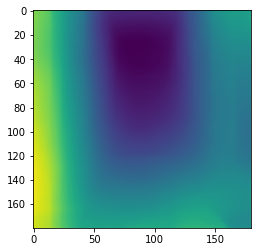

(73.10461416070241, 46.12092283214153)
62 (73.10461416070241, 46.12092283214153) turn left 0.2808333333333333 0.09782890000002453 0.31898130000001856 correct
(76.42219387755352, 147.52933673469923)
63 (76.42219387755352, 147.52933673469923) turn right 0.8258333333333333 0.0949675999999613 0.33940669999998363 correct
(53.96019986215767, 132.2455203307907)
64 (53.96019986215767, 132.2455203307907) turn right 0.7183333333333334 0.09454799999997476 0.431914699999993 correct
(82.77329731814768, 23.077561257956358)
65 (82.77329731814768, 23.077561257956358) turn left 0.14333333333333334 0.09247879999998077 0.40676489999998466 correct
(58.81087702106031, 25.14633349664869)
66 (58.81087702106031, 25.14633349664869) turn left 0.195 0.09109680000000253 0.4384388999999942 correct
(72.87049180328096, 129.6864754098404)
(51.809523809523725, 44.428571428571374)
(72.35986733001751, 47.70149253731407)
67 (72.87049180328096, 129.6864754098404) turn right 0.7225 0.09106910000002699 0.33103550000004134 c

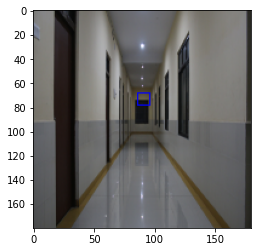

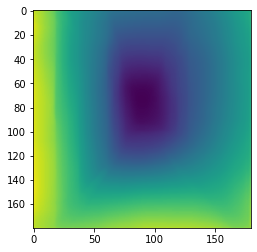

(69.43283582089795, 35.48017057569406)
88 (69.43283582089795, 35.48017057569406) turn left 0.20833333333333334 0.0936148999999773 0.30887489999997797 correct
(49.29716738196842, 26.181115879825164)
89 (49.29716738196842, 26.181115879825164) turn left 0.1875 0.09342029999999113 0.4336079000000268 correct
(76.1440833844288, 87.82955242182983)
90 (76.1440833844288, 87.82955242182983) turn left 0.4875 0.09197729999999638 0.27990579999999454 correct
(86.87532155718425, 22.075115760587234)
91 (86.87532155718425, 22.075115760587234) turn left 0.1575 0.09185290000004898 0.43138550000003306 correct
(69.11333694278204, 137.89225771519867)
92 (69.11333694278204, 137.89225771519867) turn right 0.7758333333333334 0.09028130000001511 0.5632279000000153 correct
(81.26897099722132, 26.69964243146692)
93 (81.26897099722132, 26.69964243146692) turn left 0.15416666666666667 0.04616720000001351 0.2752310000000193 correct
(72.90582959641488, 87.46922136160092)
94 (72.90582959641488, 87.46922136160092) turn

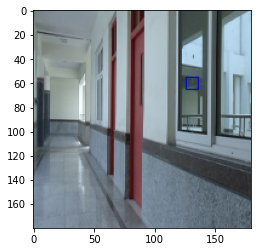

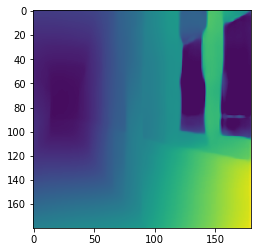

(83.11696551724027, 18.18510344827563)
105 (83.11696551724027, 18.18510344827563) turn left 0.1675 0.04592769999999291 0.30583469999999124 correct
(80.9643652561272, 144.5211581291809)
106 (80.9643652561272, 144.5211581291809) turn right 0.805 0.09767350000004171 0.3090665999999942 correct
(66.70725520040789, 145.00152207001966)
107 (66.70725520040789, 145.00152207001966) turn right 0.8025 0.09775390000004336 0.2988356000000181 correct
(28.754844961241048, 7.741279069767641)
(41.858873841762666, 84.24376336420964)
108 (41.858873841762666, 84.24376336420964) turn left 0.48833333333333334 0.094907199999966 0.46501760000001013 correct
(72.12477264460041, 84.50891233175977)
109 (72.12477264460041, 84.50891233175977) turn left 0.4708333333333333 0.0931793999999968 0.3216140999999766 correct
(71.17647058823773, 86.50435729847776)
110 (71.17647058823773, 86.50435729847776) turn left 0.4875 0.0913697999999954 0.3222140999999965 correct
(73.31914893617251, 143.05924071756826)
111 (73.3191489361

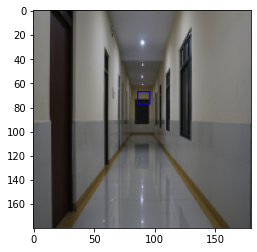

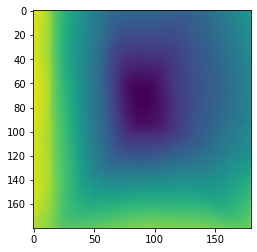

(72.63458994709237, 150.7318121693173)
142 (72.63458994709237, 150.7318121693173) turn right 0.8283333333333334 0.09272190000001501 0.33042340000002923 correct
(80.14416412531118, 23.799279179373187)
143 (80.14416412531118, 23.799279179373187) turn left 0.175 0.09262429999995447 0.35056479999997237 correct
(78.44475459408694, 22.40567573854254)
144 (78.44475459408694, 22.40567573854254) turn left 0.175 0.0910486000000219 0.37234829999999874 correct
(74.65322580645397, 99.50806451613236)
145 (74.65322580645397, 99.50806451613236) turn right 0.5466666666666666 0.09096900000002961 0.3082947000000331 correct
(72.82088414634399, 84.3830030487832)
(79.0, 179.0)
146 (72.82088414634399, 84.3830030487832) turn left 0.4708333333333333 0.09034639999998717 0.3136331000000041 correct
(81.68362989324095, 144.46654804270926)
147 (81.68362989324095, 144.46654804270926) turn right 0.7958333333333333 0.0899923000000058 0.3193029999999908 correct
(71.36346014053463, 21.45093288102636)
148 (71.36346014053

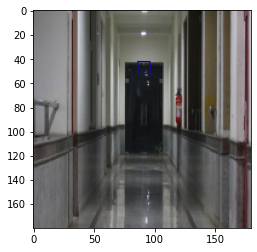

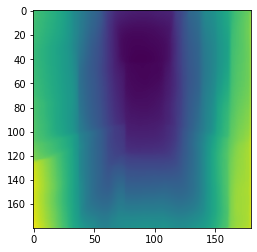

(68.2650551314696, 83.09584393554145)
160 (68.2650551314696, 83.09584393554145) turn left 0.4766666666666667 0.046271600000011404 0.2615619000000038 correct
(75.24894514768157, 85.68682606657569)
161 (75.24894514768157, 85.68682606657569) turn left 0.4841666666666667 0.046551899999997204 0.2579236999999921 correct
(74.33464955577723, 84.60365251727829)
162 (74.33464955577723, 84.60365251727829) turn left 0.4766666666666667 0.0463455999999951 0.2543504000000212 correct
(87.76291633883851, 158.76055599265158)
163 (87.76291633883851, 158.76055599265158) turn right 0.8275 0.09744200000000092 0.3634867999999756 correct
(72.92116182572838, 150.50973507820467)
164 (72.92116182572838, 150.50973507820467) turn right 0.8283333333333334 0.0977108999999814 0.3411181999999826 correct
(56.40849447513141, 152.43042127069947)
165 (56.40849447513141, 152.43042127069947) turn right 0.7916666666666666 0.09503300000000081 0.4318521000000146 correct
(70.70381998953249, 155.52851909994317)
166 (70.703819989

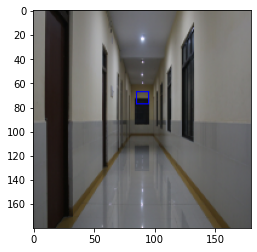

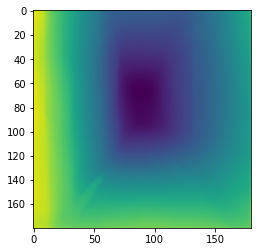

(44.728902953581205, 28.689521800277905)
169 (44.728902953581205, 28.689521800277905) turn left 0.1975 0.09294560000000729 0.427408000000014 correct
(90.80379883444141, 158.59162529677073)
170 (90.80379883444141, 158.59162529677073) turn right 0.8275 0.09090660000003936 0.38564330000002656 correct
(61.9567430025466, 38.27353689567549)
171 (61.9567430025466, 38.27353689567549) turn left 0.23416666666666666 0.09011120000002393 0.30493240000004107 correct
(70.56401453957315, 25.584814216475813)
172 (70.56401453957315, 25.584814216475813) turn left 0.16 0.08995320000002494 0.5332420000000297 correct
(72.38593953420488, 30.570953276433077)
173 (72.38593953420488, 30.570953276433077) turn left 0.21833333333333332 0.04536630000001196 0.42000520000004826 correct
(65.07061197041266, 139.9482178883707)
174 (65.07061197041266, 139.9482178883707) turn right 0.7916666666666666 0.04528179999999793 0.28041940000002796 correct
(70.8806664083713, 138.41418055017888)
175 (70.8806664083713, 138.414180550

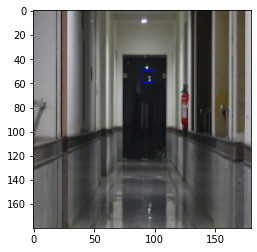

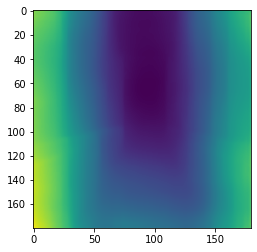

(71.5108359133091, 22.112645868062675)
182 (71.5108359133091, 22.112645868062675) turn left 0.175 0.09044510000001083 0.3691863999999896 correct
(64.63071358106122, 82.70075633015739)
183 (64.63071358106122, 82.70075633015739) turn left 0.48083333333333333 0.04597610000007535 0.28672030000007 correct
(54.0616594772882, 133.15529053539262)
184 (54.0616594772882, 133.15529053539262) turn right 0.7183333333333334 0.04589499999997315 0.31607950000000073 correct
(57.10918114144134, 86.6935483870996)
185 (57.10918114144134, 86.6935483870996) turn left 0.48833333333333334 0.04597119999993993 0.2608046999999942 correct
(75.83370288249105, 137.5953436807247)
186 (75.83370288249105, 137.5953436807247) turn right 0.7758333333333334 0.04592689999992672 0.5953000999999176 correct
(61.12575757575584, 91.9863636363601)
187 (61.12575757575584, 91.9863636363601) turn right 0.4975 0.0977940000000217 0.36825439999995524 wrong


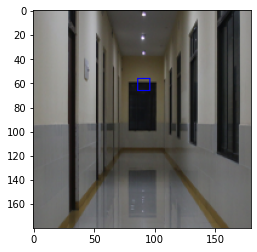

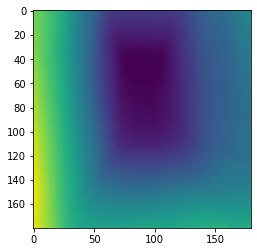

(76.86932006632549, 23.099004975121474)
188 (76.86932006632549, 23.099004975121474) turn left 0.23416666666666666 0.09479929999997694 0.5808107000000291 correct
(74.0631698973728, 80.42234891675656)
189 (74.0631698973728, 80.42234891675656) turn left 0.455 0.09331159999999272 0.3795283000000609 correct
(81.00661455201593, 19.163860493085053)
190 (81.00661455201593, 19.163860493085053) turn left 0.1675 0.09298710000007304 0.3416788000000679 correct
(74.02628120893829, 155.98127463863878)
191 (74.02628120893829, 155.98127463863878) turn right 0.8708333333333333 0.09184609999999793 0.3306059000000232 correct
(55.84504059301297, 132.38969290505182)
192 (55.84504059301297, 132.38969290505182) turn right 0.7183333333333334 0.09160310000004301 0.32283170000005157 correct
(74.9634455302228, 99.69743032935529)
193 (74.9634455302228, 99.69743032935529) turn right 0.5466666666666666 0.09052780000001803 0.31947839999997996 correct
(77.11531690141089, 83.97227112676332)
(62.3296703296715, 167.76043

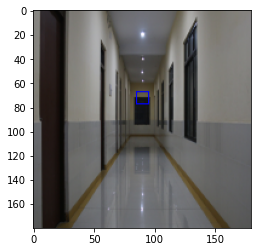

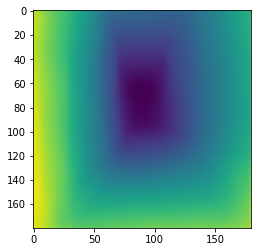

(72.90271659323749, 153.9546622613633)
202 (72.90271659323749, 153.9546622613633) turn right 0.7958333333333333 0.09521440000003167 0.41818339999997534 correct
(82.16603053434712, 22.138597328243126)
203 (82.16603053434712, 22.138597328243126) turn left 0.1575 0.09297100000003411 0.37468539999997574 correct
(66.48664588424309, 90.05585980285777)
204 (66.48664588424309, 90.05585980285777) turn right 0.49083333333333334 0.09125050000000101 0.6431440999999722 wrong


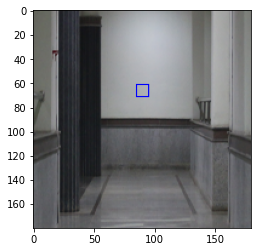

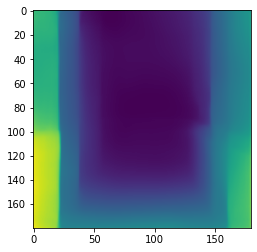

(75.401736745889, 15.539305301645822)
(76.5480225988699, 150.80225988700545)
(67.0, 34.49999999999999)
205 (67.0, 34.49999999999999) turn left 0.82 0.09144350000008217 0.3066989000000149 wrong


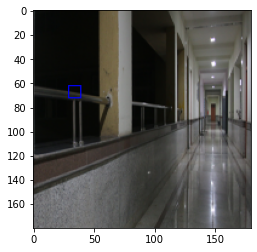

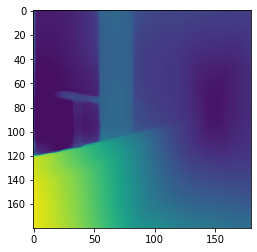

(72.7876857749494, 85.6178343949073)
206 (72.7876857749494, 85.6178343949073) turn left 0.4816666666666667 0.09026110000002063 0.32034360000000106 correct
(61.84042116777949, 149.73909476274198)
(21.74074074074074, 92.74074074074073)
207 (21.74074074074074, 92.74074074074073) turn right 0.8383333333333334 0.09025880000001507 0.4802312000000484 correct
(72.29178779070008, 99.41206395349161)
208 (72.29178779070008, 99.41206395349161) turn right 0.5466666666666666 0.04556049999996503 0.27824390000000676 correct
(86.50370573702877, 35.082624210814814)
209 (86.50370573702877, 35.082624210814814) turn left 0.225 0.04566490000001977 0.30536080000001675 correct
(80.25942196531324, 22.535028901732733)
210 (80.25942196531324, 22.535028901732733) turn left 0.14333333333333334 0.04562870000006569 0.32968210000001363 correct
(84.54565844280944, 36.70330022428828)
211 (84.54565844280944, 36.70330022428828) turn left 0.225 0.09805800000003728 0.3381958999999597 correct
(66.2958677685968, 39.995041322

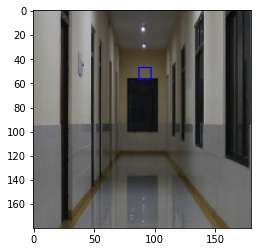

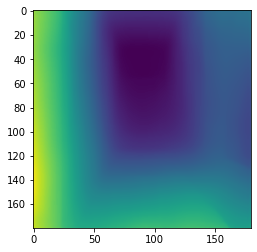

(68.14549839228168, 23.019560557341467)
218 (68.14549839228168, 23.019560557341467) turn left 0.1575 0.045895900000004985 0.4476507000000538 correct
(60.72499333155221, 31.09509202453839)
219 (60.72499333155221, 31.09509202453839) turn left 0.1825 0.09801000000004478 0.4920245000000705 correct
(70.40011068068834, 90.46485888212791)
220 (70.40011068068834, 90.46485888212791) turn right 0.4975 0.09770820000005642 0.2918687999999747 wrong


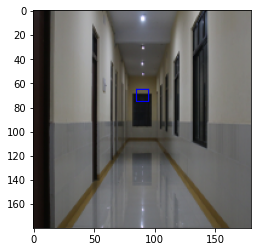

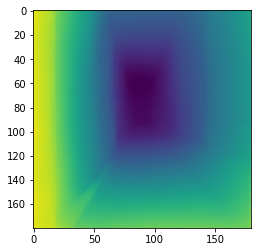

(50.34005905511985, 157.2814960629973)
(72.91109229466747, 24.14817950889139)
(92.02499999999989, 162.77499999999984)
(92.10000000000001, 141.6)
(92.77999999999986, 148.49999999999977)
(93.5, 170.0)
221 (92.10000000000001, 141.6) turn right 0.1375 0.09770349999996597 0.3492663999999195 wrong


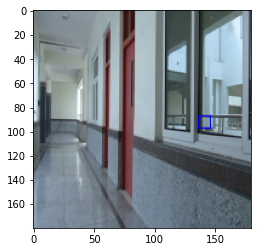

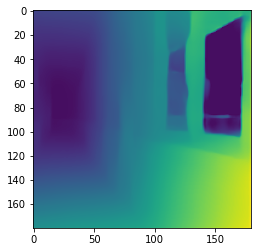

(72.33782129743163, 143.25703794370054)
222 (72.33782129743163, 143.25703794370054) turn right 0.8025 0.09433190000004288 0.2834340000000566 correct
(67.56828459451417, 85.72505275851782)
223 (67.56828459451417, 85.72505275851782) turn left 0.4841666666666667 0.09269949999998062 0.34253190000003997 correct
(68.19591496457092, 86.64985410588041)
224 (68.19591496457092, 86.64985410588041) turn left 0.4975 0.09238600000003316 0.3090783999999758 correct
(63.30384967919545, 38.657653528873816)
225 (63.30384967919545, 38.657653528873816) turn left 0.23416666666666666 0.09071480000000065 0.2996713 correct
(65.97023586670976, 145.39030325719173)
226 (65.97023586670976, 145.39030325719173) turn right 0.8008333333333333 0.09034970000004705 0.40931350000005295 correct
(69.62546661136676, 36.10286188303726)
227 (69.62546661136676, 36.10286188303726) turn left 0.23416666666666666 0.09050390000004427 0.30735520000007455 correct
(73.67681239623577, 18.324847814056223)
228 (73.67681239623577, 18.32484

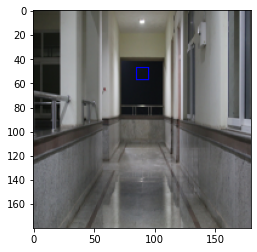

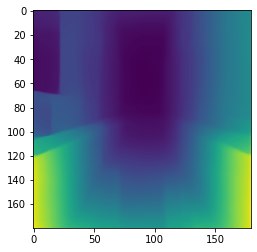

(68.94377120698222, 84.59718856035184)
236 (68.94377120698222, 84.59718856035184) turn left 0.47333333333333333 0.09479559999999765 0.2977000999999291 correct
(72.93207941484026, 87.95611285266739)
237 (72.93207941484026, 87.95611285266739) turn left 0.4875 0.09419270000000779 0.29236839999998665 correct
(56.50820283370834, 86.08165548098725)
238 (56.50820283370834, 86.08165548098725) turn left 0.48833333333333334 0.09395269999993161 0.31747649999999794 correct
(64.44186827957213, 82.67909946236841)
239 (64.44186827957213, 82.67909946236841) turn left 0.48083333333333333 0.09200850000001992 0.32776010000009137 correct
(54.67641248518596, 84.49348083761645)
240 (54.67641248518596, 84.49348083761645) turn left 0.48833333333333334 0.09061629999996512 0.45120859999997265 correct
(61.08484005563464, 88.02503477051758)
241 (61.08484005563464, 88.02503477051758) turn left 0.4975 0.09100799999998799 0.29643639999994775 correct
(58.3977777777773, 28.186111111110772)
242 (58.3977777777773, 28.18

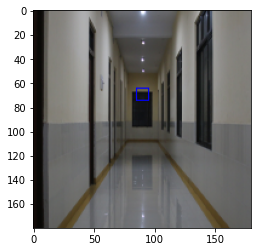

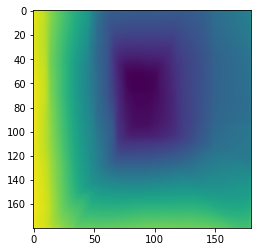

(82.33020066039823, 164.72796545592394)
249 (82.33020066039823, 164.72796545592394) turn right 0.7958333333333333 0.09358470000006491 0.36552770000002965 correct
(65.71117070895517, 146.4977845149266)
250 (65.71117070895517, 146.4977845149266) turn right 0.8008333333333333 0.09246159999997872 0.5240424999999505 correct
(82.19624060150645, 142.92067669173412)
251 (82.19624060150645, 142.92067669173412) turn right 0.7958333333333333 0.09184809999999288 0.3161177999999154 correct
(68.41894925909507, 86.63493488998964)
252 (68.41894925909507, 86.63493488998964) turn left 0.4975 0.09076770000001488 0.29879540000001725 correct
(69.42705804457678, 87.4153608474889)
253 (69.42705804457678, 87.4153608474889) turn left 0.4841666666666667 0.09078900000008616 0.38249740000003385 correct
(65.323085031615, 64.98085031622563)
254 (65.323085031615, 64.98085031622563) turn left 0.5033333333333333 0.09052029999998012 0.42301450000002205 wrong


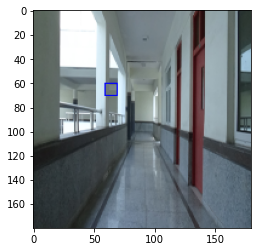

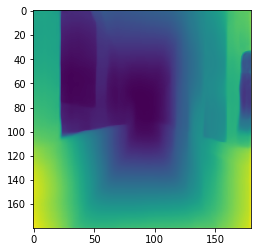

(82.04349415204966, 143.462353801174)
255 (82.04349415204966, 143.462353801174) turn right 0.7958333333333333 0.0945396999999275 0.32134020000000874 correct
(91.23402973080744, 158.66271595016505)
256 (91.23402973080744, 158.66271595016505) turn right 0.8275 0.09398690000000443 0.5377664999999752 correct
(67.2948228882855, 146.29863760218416)
257 (67.2948228882855, 146.29863760218416) turn right 0.8025 0.09327940000002855 0.2874102999999195 correct
(68.42575702298643, 23.160160525356538)
258 (68.42575702298643, 23.160160525356538) turn left 0.175 0.09202340000001641 0.3187902000000804 correct
(66.3956386292858, 87.76981654552038)
259 (66.3956386292858, 87.76981654552038) turn left 0.49583333333333335 0.0919331999999713 0.3235862000000225 correct
(71.05497483546537, 35.16531165311765)
260 (71.05497483546537, 35.16531165311765) turn left 0.20833333333333334 0.09194259999992482 0.3132070999999996 correct
(81.31057354661714, 24.39328911431675)
261 (81.31057354661714, 24.39328911431675) tur

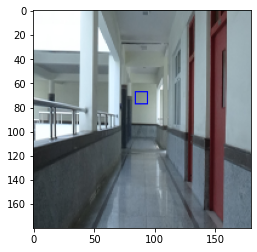

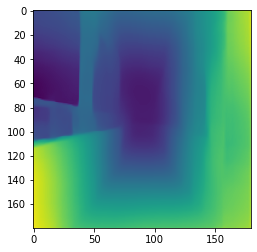

(39.880138682517384, 168.11738484398796)
267 (39.880138682517384, 168.11738484398796) turn right 0.8008333333333333 0.0977684000000636 0.29906710000000203 correct
(77.55910987482548, 19.396105702364203)
268 (77.55910987482548, 19.396105702364203) turn left 0.1675 0.0945552000000589 0.35374799999999595 correct
(71.39454845814907, 157.5178964757686)
269 (71.39454845814907, 157.5178964757686) turn right 0.8683333333333333 0.09352819999992334 0.3524833999999828 correct
(76.67137355584329, 154.89987163030057)
270 (76.67137355584329, 154.89987163030057) turn right 0.8708333333333333 0.09191009999995003 0.3058000999999422 correct
(66.45591594334934, 87.27957971676024)
271 (66.45591594334934, 87.27957971676024) turn left 0.4816666666666667 0.09131260000003749 0.37836460000005445 correct
(63.60244735344802, 92.31749193702112)
272 (63.60244735344802, 92.31749193702112) turn right 0.49083333333333334 0.09109809999995377 0.5926958000000013 wrong


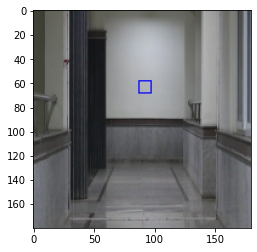

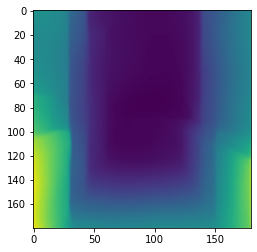

(72.0368178829744, 24.975673898751733)
273 (72.0368178829744, 24.975673898751733) turn left 0.14333333333333334 0.09022329999993417 0.3278040999999803 correct
(82.01136115358814, 17.241861481318367)
274 (82.01136115358814, 17.241861481318367) turn left 0.1675 0.04552130000001853 0.33673559999999725 correct
(74.73100731570293, 85.89364096792622)
275 (74.73100731570293, 85.89364096792622) turn left 0.4841666666666667 0.0456646999999748 0.2402479999999514 correct
(83.0102722136642, 79.13353877760919)
276 (83.0102722136642, 79.13353877760919) turn left 0.455 0.04558169999995698 0.24540769999998702 correct
(76.72075471698369, 142.79245283019333)
277 (76.72075471698369, 142.79245283019333) turn right 0.8 0.04567320000001018 0.25884819999998854 correct
(67.32567049808341, 157.65325670497813)
278 (67.32567049808341, 157.65325670497813) turn right 0.8683333333333333 0.09687040000005709 0.3576864999999998 correct
(78.8279492701564, 102.20172290020999)
279 (78.8279492701564, 102.20172290020999) t

(64.69997201231389, 83.46515533165329)
15 (64.69997201231389, 83.46515533165329) turn left 0.48083333333333333 0.09700490000000173 0.35350930000004155 correct
(62.78557194101451, 84.58907931447082)
16 (62.78557194101451, 84.58907931447082) turn left 0.47333333333333333 0.0928967999999486 0.3117191000000048 correct
(49.952241715401286, 13.95581546458786)
(70.9748187714639, 157.20183136208084)
17 (70.9748187714639, 157.20183136208084) turn right 0.82 0.09286349999990762 0.56080309999993 correct
(68.66689419795438, 82.64266211604372)
18 (68.66689419795438, 82.64266211604372) turn left 0.4891666666666667 0.09134300000005169 0.3241604999999481 correct
(82.19307880056697, 33.54463040446657)
19 (82.19307880056697, 33.54463040446657) turn left 0.21833333333333332 0.09109000000000833 0.6271154999999453 correct
(69.74730796841608, 99.49856424982389)
20 (69.74730796841608, 99.49856424982389) turn right 0.5466666666666666 0.09051899999997204 0.3182970999999952 correct
(68.95515405709648, 27.320212

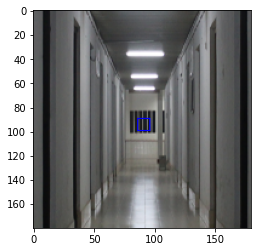

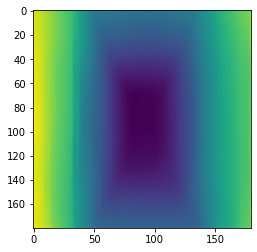

(75.72380612972454, 146.18460441910676)
50 (75.72380612972454, 146.18460441910676) turn right 0.8258333333333333 0.09523669999998674 0.32467050000002473 correct
(74.22998544395946, 150.8716157205244)
51 (74.22998544395946, 150.8716157205244) turn right 0.8283333333333334 0.094577299999969 0.3469241000000238 correct
(69.15364354697326, 25.146619841967446)
(39.625, 131.37500000000003)
(40.5, 134.0)
(68.81938325991338, 139.23568281938645)
(69.33210332103305, 175.0664206642062)
52 (39.625, 131.37500000000003) turn right 0.1375 0.09255689999997685 0.34559009999998125 wrong


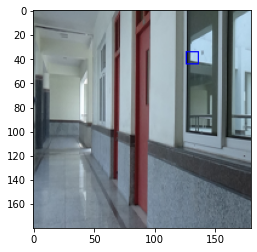

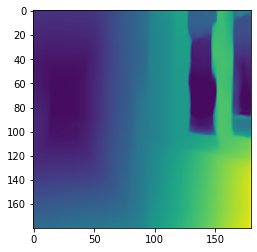

(66.60964083176013, 86.21361058601438)
53 (66.60964083176013, 86.21361058601438) turn left 0.4975 0.09217330000001311 0.29761710000002495 correct
(67.41517944694435, 25.60364777407082)
54 (67.41517944694435, 25.60364777407082) turn left 0.15833333333333333 0.09110359999999673 0.39992610000001605 correct
(58.90140105078126, 85.7535901926346)
55 (58.90140105078126, 85.7535901926346) turn left 0.48083333333333333 0.09013040000002093 0.421665599999983 correct
(71.98678861788379, 23.46849593495856)
56 (71.98678861788379, 23.46849593495856) turn left 0.1575 0.04557780000004641 0.3139570000000731 correct
(91.3411190965061, 27.306468172483708)
57 (91.3411190965061, 27.306468172483708) turn left 0.15416666666666667 0.045558899999946334 0.31364979999989373 correct
(77.94523661912974, 157.08596817522863)
58 (77.94523661912974, 157.08596817522863) turn right 0.8275 0.04589729999997871 0.3453322999999955 correct
(85.80652839169304, 21.374192451544445)
59 (85.80652839169304, 21.374192451544445) turn

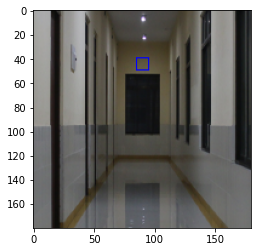

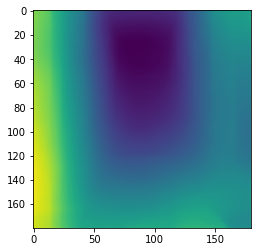

(72.20432692307813, 45.757211538462)
62 (72.20432692307813, 45.757211538462) turn left 0.2808333333333333 0.09181730000000243 0.34210859999996046 correct
(76.21222664015583, 147.3312624254415)
63 (76.21222664015583, 147.3312624254415) turn right 0.8258333333333333 0.09050380000007863 0.3645359000000781 correct
(56.30198507672398, 132.0872870617952)
64 (56.30198507672398, 132.0872870617952) turn right 0.7183333333333334 0.09079269999995176 0.4736573000000135 correct
(79.34392828034866, 24.121108394454833)
65 (79.34392828034866, 24.121108394454833) turn left 0.14333333333333334 0.04595510000001468 0.39387699999997494 correct
(59.90809407011476, 25.99307459240877)
66 (59.90809407011476, 25.99307459240877) turn left 0.195 0.046003799999994044 0.4226021999999148 correct
(71.25279642058405, 129.74912112496426)
(69.19075712881175, 47.734513274337495)
(81.67164179104462, 162.31343283582066)
(85.0, 168.0)
67 (71.25279642058405, 129.74912112496426) turn right 0.7225 0.045922799999971176 0.327707

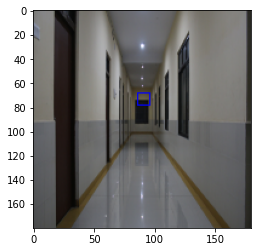

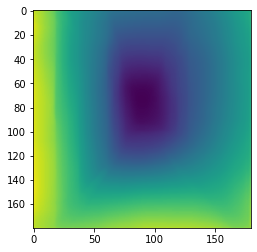

(68.78385986862904, 35.285580231467904)
88 (68.78385986862904, 35.285580231467904) turn left 0.20833333333333334 0.04563699999994242 0.29033640000000105 correct
(54.53307064452176, 29.340416549392756)
89 (54.53307064452176, 29.340416549392756) turn left 0.1875 0.04566290000002482 0.5646749 correct
(76.3554670208081, 88.15759185480596)
90 (76.3554670208081, 88.15759185480596) turn left 0.4875 0.09784920000004149 0.3090228000000934 correct
(82.75171929824079, 24.13656140350706)
91 (82.75171929824079, 24.13656140350706) turn left 0.1575 0.09525670000004993 0.47531900000001315 correct
(68.67689343411261, 138.1071587372032)
92 (68.67689343411261, 138.1071587372032) turn right 0.7758333333333334 0.10681099999999333 0.4887362000000621 correct
(80.05709023941228, 26.470841006753222)
93 (80.05709023941228, 26.470841006753222) turn left 0.15416666666666667 0.09175600000003215 0.33588190000000395 correct
(73.82193909260556, 87.48011187072927)
94 (73.82193909260556, 87.48011187072927) turn left 0.

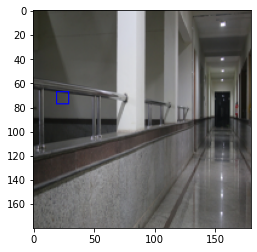

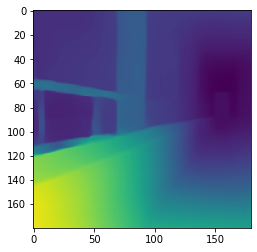

(70.13183113182912, 151.39342139341724)
96 (70.13183113182912, 151.39342139341724) turn right 0.8283333333333334 0.04555140000002211 0.3138748000000078 correct
(47.2605480643776, 164.9691170074005)
(70.40345699831599, 24.08516020236169)
(73.0, 120.625)
97 (73.0, 120.625) turn right 0.1375 0.045658000000003085 0.3417581999999584 wrong


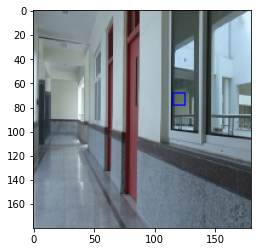

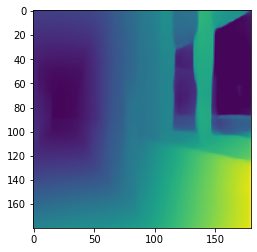

(61.7047473200542, 153.52542113321408)
98 (61.7047473200542, 153.52542113321408) turn right 0.7916666666666666 0.045848999999975604 0.40706909999994423 correct
(76.5665040650432, 46.55089430894457)
99 (76.5665040650432, 46.55089430894457) turn left 0.2808333333333333 0.09780660000001262 0.3376081000000113 correct
(83.37951807229193, 36.72966867469997)
100 (83.37951807229193, 36.72966867469997) turn left 0.20833333333333334 0.09463570000002619 0.3193870000000061 correct
(67.38417878680627, 87.35260730755877)
101 (67.38417878680627, 87.35260730755877) turn left 0.49583333333333335 0.09492160000002059 0.3261486999999761 correct
(69.21895904714394, 157.58753467121457)
102 (69.21895904714394, 157.58753467121457) turn right 0.8033333333333333 0.0926904000000377 0.4386877000000595 correct
(76.87389732465043, 152.6504699927563)
103 (76.87389732465043, 152.6504699927563) turn right 0.8258333333333333 0.09238630000004378 0.6119425000000547 correct
(52.16396018858215, 168.63279203772157)
(59.2993

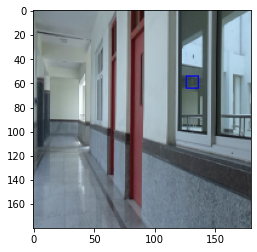

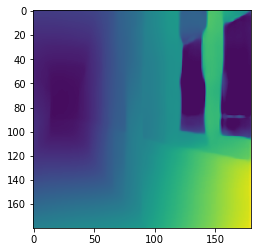

(81.83641696750385, 19.370938628157557)
105 (81.83641696750385, 19.370938628157557) turn left 0.1675 0.09085369999991144 0.3779098999999633 correct
(79.878535170416, 144.38578680203528)
106 (79.878535170416, 144.38578680203528) turn right 0.805 0.04639959999997245 0.2740717000000359 correct
(66.12599565532453, 146.04634322954863)
107 (66.12599565532453, 146.04634322954863) turn right 0.8025 0.04628890000003594 0.2771738000000141 correct
(40.331021779175686, 66.75555314768887)
108 (40.331021779175686, 66.75555314768887) turn left 0.48833333333333334 0.04628149999996367 0.5053912999999284 correct
(0.0, 179.0)
(54.29540358744566, 161.83127802691084)
(69.29388403494669, 85.91024622716239)
(77.6, 178.4)
(79.5, 177.0)
109 (69.29388403494669, 85.91024622716239) turn left 0.4708333333333333 0.09814630000005309 0.428926400000023 correct
(72.26131221719406, 86.57041855203575)
110 (72.26131221719406, 86.57041855203575) turn left 0.4875 0.09795409999992444 0.35383439999998245 correct
(72.388991960

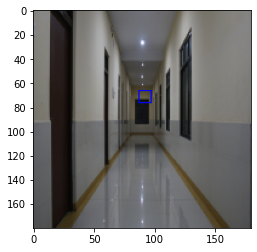

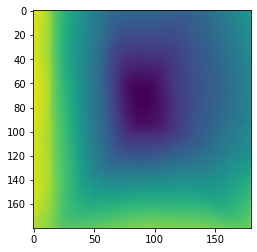

(71.19744884400575, 151.28222163167365)
142 (71.19744884400575, 151.28222163167365) turn right 0.8283333333333334 0.09190940000007686 0.3575792999999976 correct
(79.76575630251438, 23.601050420166132)
143 (79.76575630251438, 23.601050420166132) turn left 0.175 0.09163990000001832 0.3886929999999893 correct
(77.48603242820145, 23.01562805235173)
144 (77.48603242820145, 23.01562805235173) turn left 0.175 0.09054090000006454 0.40082970000003115 correct
(74.39844542075299, 99.74112875971936)
145 (74.39844542075299, 99.74112875971936) turn right 0.5466666666666666 0.04593980000004194 0.2831895000000486 correct
(71.32022307015029, 84.57205752861807)
(65.42128603104237, 172.20177383592087)
146 (71.32022307015029, 84.57205752861807) turn left 0.4708333333333333 0.04599780000000919 0.31255579999992733 correct
(81.81835256238124, 144.51274483498574)
147 (81.81835256238124, 144.51274483498574) turn right 0.7958333333333333 0.045997899999974834 0.4446785000000091 correct
(70.732201986749, 22.58278

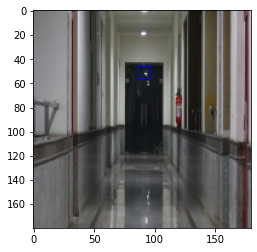

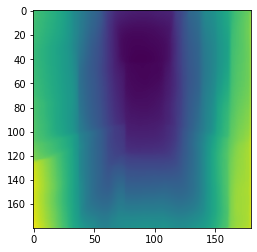

(66.73298768632783, 82.68049254698924)
160 (66.73298768632783, 82.68049254698924) turn left 0.4766666666666667 0.0925565000000006 0.3324494999999388 correct
(75.30676416819303, 85.74149908592605)
161 (75.30676416819303, 85.74149908592605) turn left 0.4841666666666667 0.09104689999992388 0.319045200000005 correct
(73.38500914077035, 84.59378427788202)
162 (73.38500914077035, 84.59378427788202) turn left 0.4766666666666667 0.09044800000003761 0.3180733000000373 correct
(90.10292221744041, 157.96970348086364)
163 (90.10292221744041, 157.96970348086364) turn right 0.8275 0.09021010000003571 0.3832806000000346 correct
(71.78423236514298, 150.91338174273443)
164 (71.78423236514298, 150.91338174273443) turn right 0.8283333333333334 0.04558220000001256 0.31643370000006144 correct
(57.41030619865008, 151.01508588497344)
165 (57.41030619865008, 151.01508588497344) turn right 0.7916666666666666 0.04611590000001797 0.41066330000001017 correct
(70.2343113284371, 153.70374898124126)
166 (70.23431132

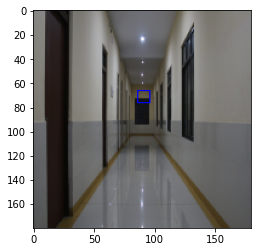

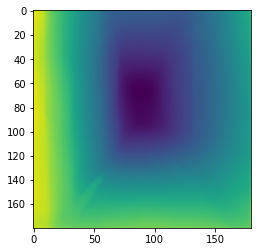

(49.81308694334499, 30.26310209027242)
169 (49.81308694334499, 30.26310209027242) turn left 0.1975 0.09249030000000857 0.45298939999997856 correct
(93.99893842886391, 157.33174097662695)
170 (93.99893842886391, 157.33174097662695) turn right 0.8275 0.09148500000003423 0.4213739000000487 correct
(60.219746208605834, 37.42154131847806)
171 (60.219746208605834, 37.42154131847806) turn left 0.23416666666666666 0.09077330000002348 0.47466819999999643 correct
(70.7197552447475, 26.53181818181499)
172 (70.7197552447475, 26.53181818181499) turn left 0.16 0.04594290000000001 0.37759110000001783 correct
(72.98967318673286, 30.650103268132373)
173 (72.98967318673286, 30.650103268132373) turn left 0.21833333333333332 0.04602379999994355 0.46725340000000415 correct
(64.20205655526824, 140.53341902313215)
174 (64.20205655526824, 140.53341902313215) turn right 0.7916666666666666 0.046034599999984493 0.3140684999999621 correct
(70.51039334825958, 137.92388871122984)
175 (70.51039334825958, 137.9238887

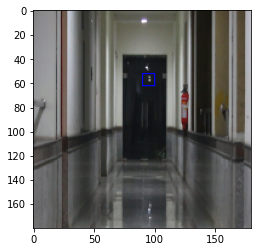

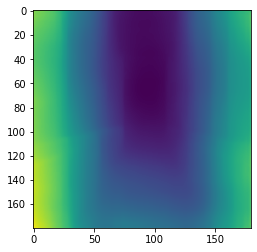

(70.62579194767417, 22.691804618841246)
182 (70.62579194767417, 22.691804618841246) turn left 0.175 0.09050860000002103 0.39360229999999774 correct
(63.70348837209164, 83.21035940803178)
183 (63.70348837209164, 83.21035940803178) turn left 0.48083333333333333 0.09040829999992184 0.4924768999999287 correct
(54.016487882394834, 133.5818434644293)
184 (54.016487882394834, 133.5818434644293) turn right 0.7183333333333334 0.09574770000006083 0.40514089999999214 correct
(58.2801418439722, 85.4843380614663)
185 (58.2801418439722, 85.4843380614663) turn left 0.48833333333333334 0.09778210000001764 0.34775439999998525 correct
(76.22961667174187, 134.84453909340795)
186 (76.22961667174187, 134.84453909340795) turn right 0.7758333333333334 0.09775150000007216 0.692984200000069 correct
(61.703629836452556, 92.6503789389621)
187 (61.703629836452556, 92.6503789389621) turn right 0.4975 0.09509540000010475 0.40215330000000904 wrong


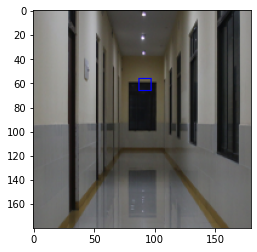

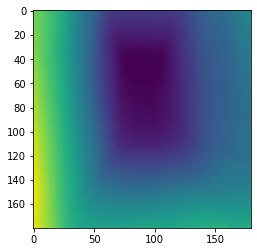

(75.8526603001318, 24.11814461118555)
188 (75.8526603001318, 24.11814461118555) turn left 0.23416666666666666 0.09310880000009547 0.48149399999999787 correct
(73.91380961500913, 80.47347251483582)
189 (73.91380961500913, 80.47347251483582) turn left 0.455 0.0915105000000267 0.40654430000006414 correct
(80.44609227871518, 19.84298493408552)
190 (80.44609227871518, 19.84298493408552) turn left 0.1675 0.090662400000042 0.3714086000001089 correct
(78.86578534617462, 157.1272686533611)
191 (78.86578534617462, 157.1272686533611) turn right 0.8708333333333333 0.046367199999963304 0.3356369000000541 correct
(56.42132639791791, 133.20780234069858)
192 (56.42132639791791, 133.20780234069858) turn right 0.7183333333333334 0.04631080000001475 0.3127954999999929 correct
(74.68662186927426, 100.12583995113201)
193 (74.68662186927426, 100.12583995113201) turn right 0.5466666666666666 0.04632660000004307 0.2908350000000155 correct
(58.12712623097731, 168.00895255148112)
(75.8598510494272, 84.300609343

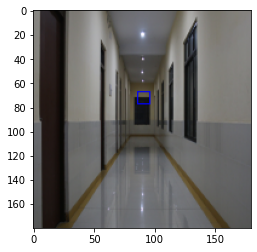

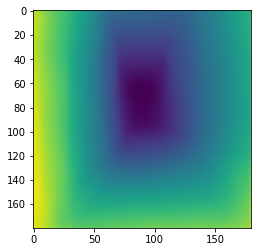

(73.99559124546373, 152.70776255705806)
202 (73.99559124546373, 152.70776255705806) turn right 0.7958333333333333 0.04579379999995581 0.40238079999994625 correct
(81.78110882956203, 23.22053388090146)
203 (81.78110882956203, 23.22053388090146) turn left 0.1575 0.04566720000002533 0.34770380000009027 correct
(68.58901330127304, 90.2310062373237)
204 (68.58901330127304, 90.2310062373237) turn right 0.49083333333333334 0.04586099999994531 0.6421737999999095 wrong


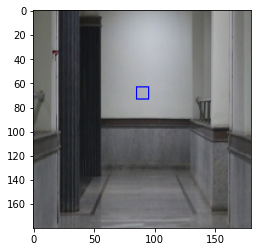

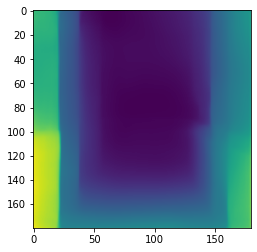

(63.11026374324964, 16.392119478869247)
(74.72672309552756, 150.34945586457397)
(94.0135135135134, 43.09459459459451)
(116.99999999999999, 11.0)
205 (94.0135135135134, 43.09459459459451) turn left 0.82 0.09794829999998456 0.3731966000000284 wrong


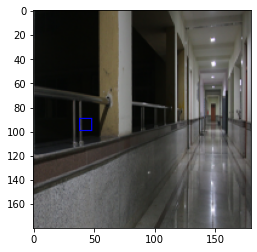

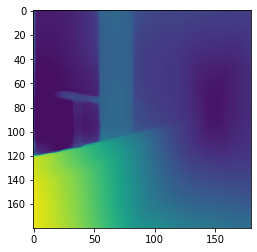

(72.81153957668957, 85.88808350246461)
206 (72.81153957668957, 85.88808350246461) turn left 0.4816666666666667 0.09480689999998049 0.3487534000000778 correct
(30.499637418420058, 96.09282088470178)
(64.60950159587428, 147.46660937883388)
(32.0, 111.0)
207 (30.499637418420058, 96.09282088470178) turn right 0.8383333333333334 0.09475180000004002 0.7006714999999986 correct
(71.6248484848496, 99.62030303030468)
208 (71.6248484848496, 99.62030303030468) turn right 0.5466666666666666 0.09322270000006938 0.33977070000003096 correct
(87.15394429087128, 34.14267488836637)
209 (87.15394429087128, 34.14267488836637) turn left 0.225 0.09140359999992143 0.3876702000000023 correct
(77.45887281035031, 23.250571210964846)
210 (77.45887281035031, 23.250571210964846) turn left 0.14333333333333334 0.09059639999998126 0.40548649999993813 correct
(82.31798664121703, 36.77290076335684)
211 (82.31798664121703, 36.77290076335684) turn left 0.225 0.0904889999999341 0.3703848000000107 correct
(65.48028477546728

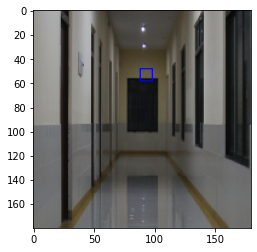

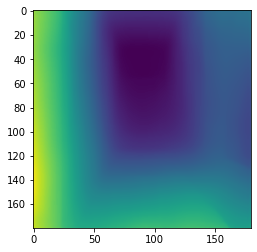

(64.48861975359671, 23.84631447065994)
218 (64.48861975359671, 23.84631447065994) turn left 0.1575 0.09267850000003364 0.5325959000000466 correct
(63.16236665839637, 31.31146117588621)
219 (63.16236665839637, 31.31146117588621) turn left 0.1825 0.09224310000001879 0.508775900000046 correct
(70.75681431005353, 91.22316865417682)
220 (70.75681431005353, 91.22316865417682) turn right 0.4975 0.09128009999994902 0.3045098999999709 wrong


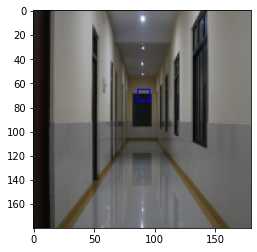

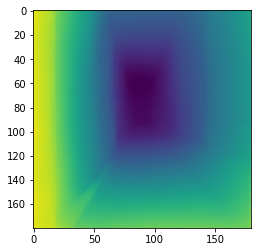

(50.29749276760058, 157.26759884282106)
(71.96455424275182, 23.687969924812723)
(92.07142857142857, 141.57142857142856)
(92.83749999999982, 148.7999999999997)
(92.39759036144561, 163.86746987951784)
221 (92.07142857142857, 141.57142857142856) turn right 0.1375 0.09021960000006857 0.3665093000000752 wrong


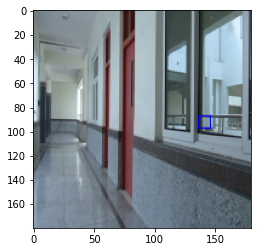

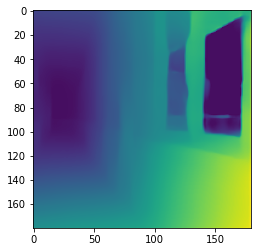

(72.14372032801262, 144.25895554596923)
222 (72.14372032801262, 144.25895554596923) turn right 0.8025 0.09008850000009261 0.3035290000000259 correct
(66.95028028271695, 85.23300024372)
223 (66.95028028271695, 85.23300024372) turn left 0.4841666666666667 0.045443700000078024 0.3223606999999902 correct
(68.40916584240277, 86.79261457303265)
224 (68.40916584240277, 86.79261457303265) turn left 0.4975 0.04542170000001988 0.2870070000000169 correct
(61.608517887566144, 38.35706984667928)
225 (61.608517887566144, 38.35706984667928) turn left 0.23416666666666666 0.04557409999995343 0.28250089999994543 correct
(64.58250927069706, 146.392923362158)
226 (64.58250927069706, 146.392923362158) turn right 0.8008333333333333 0.04527959999995801 0.4051585999999361 correct
(65.85796194943812, 32.659890539483)
227 (65.85796194943812, 32.659890539483) turn left 0.23416666666666666 0.09774790000005851 0.36330180000004475 correct
(71.52209197474731, 19.884129846707424)
228 (71.52209197474731, 19.8841298467

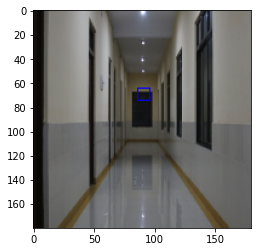

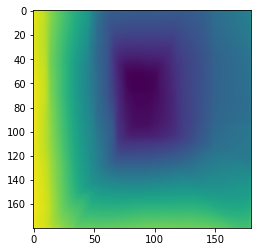

(0.0, 179.0)
(83.90644820294999, 160.16173361520288)
249 (83.90644820294999, 160.16173361520288) turn right 0.7958333333333333 0.09428319999994983 0.5676669999999149 correct
(67.16872294372503, 145.0739177489226)
250 (67.16872294372503, 145.0739177489226) turn right 0.8008333333333333 0.09771979999993619 0.5551764999999023 correct
(85.77142043837165, 142.70623398804477)
251 (85.77142043837165, 142.70623398804477) turn right 0.7958333333333333 0.09433909999995649 0.35125670000002174 correct
(69.20028922632177, 86.53000723066083)
252 (69.20028922632177, 86.53000723066083) turn left 0.4975 0.09274440000001505 0.32238649999999325 correct
(70.4463699379713, 87.60379423567088)
253 (70.4463699379713, 87.60379423567088) turn left 0.4841666666666667 0.0910282999999481 0.419710699999996 correct
(63.257483289735035, 64.9904097645976)
254 (63.257483289735035, 64.9904097645976) turn left 0.5033333333333333 0.09103849999996783 0.4650011999999606 wrong


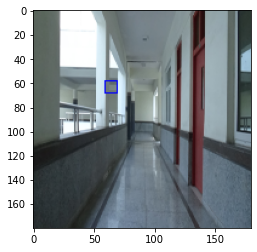

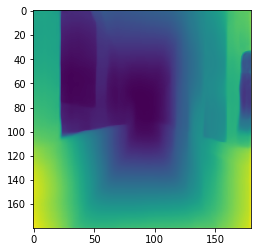

(83.91097760786319, 143.17203713817443)
255 (83.91097760786319, 143.17203713817443) turn right 0.7958333333333333 0.09804240000005393 0.3586248000000296 correct
(94.35316289739866, 157.22418879054018)
256 (94.35316289739866, 157.22418879054018) turn right 0.8275 0.09316439999997783 0.4396244999999226 correct
(66.6583897667442, 147.97441685478296)
257 (66.6583897667442, 147.97441685478296) turn right 0.8025 0.09215459999995801 0.3166800000000194 correct
(68.05070267291224, 22.154036924772406)
258 (68.05070267291224, 22.154036924772406) turn left 0.175 0.09074739999994108 0.3495091999999431 correct
(66.66868298047756, 87.55842727522557)
259 (66.66868298047756, 87.55842727522557) turn left 0.49583333333333335 0.09090289999994638 0.3485693000000083 correct
(70.06134807793437, 33.17956819378536)
(92.0, 5.0)
260 (70.06134807793437, 33.17956819378536) turn left 0.20833333333333334 0.046311199999991004 0.31112689999997656 correct
(82.2694316922489, 24.534430900740855)
261 (82.2694316922489, 24

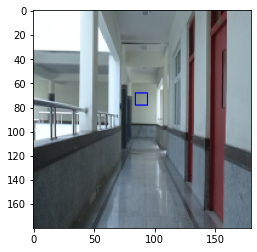

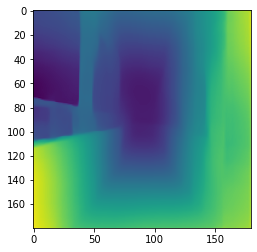

(42.51238095238237, 165.5638095238152)
267 (42.51238095238237, 165.5638095238152) turn right 0.8008333333333333 0.09240580000005139 0.315113100000076 correct
(77.52240143368644, 20.26366487455058)
268 (77.52240143368644, 20.26366487455058) turn left 0.1675 0.09118079999996098 0.380508500000019 correct
(71.81214721155564, 156.37412508465852)
269 (71.81214721155564, 156.37412508465852) turn right 0.8683333333333333 0.09099739999999201 0.38229969999997593 correct
(78.7453514024608, 156.28269776237454)
270 (78.7453514024608, 156.28269776237454) turn right 0.8708333333333333 0.09034989999997833 0.3337355999999545 correct
(66.52351340846629, 87.37349397589513)
271 (66.52351340846629, 87.37349397589513) turn left 0.4816666666666667 0.09027500000001965 0.40139669999996386 correct
(65.63693456675537, 90.89281167785113)
272 (65.63693456675537, 90.89281167785113) turn right 0.49083333333333334 0.045671700000070814 0.5918130000000019 wrong


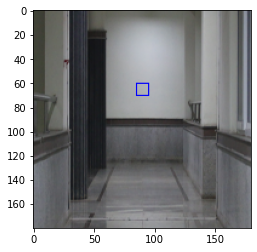

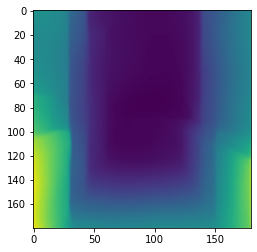

(69.8273273273244, 24.115865865864965)
273 (69.8273273273244, 24.115865865864965) turn left 0.14333333333333334 0.04570969999997487 0.3163859000000002 correct
(84.72945147678266, 19.175527426157966)
274 (84.72945147678266, 19.175527426157966) turn left 0.1675 0.09627000000000407 0.4353910999999471 correct
(74.08129370629602, 86.00000000000287)
275 (74.08129370629602, 86.00000000000287) turn left 0.4841666666666667 0.0929059000000052 0.30721730000004754 correct
(83.2147624656484, 78.77934825284932)
276 (83.2147624656484, 78.77934825284932) turn left 0.455 0.09182610000004843 0.3115175000000363 correct
(76.43545216251896, 143.0163826998739)
277 (76.43545216251896, 143.0163826998739) turn right 0.8 0.0903653000000304 0.3297247000000425 correct
(67.76468010516614, 156.36875547763947)
278 (67.76468010516614, 156.36875547763947) turn right 0.8683333333333333 0.09061629999996512 0.5203404999999748 correct
(76.54672245466537, 102.49093444908377)
279 (76.54672245466537, 102.49093444908377) turn

(76.62477504499199, 85.86622675465016)
14 (76.62477504499199, 85.86622675465016) turn left 0.4891666666666667 0.04563699999994242 0.29465219999997316 correct
(64.6167709637025, 83.4400500625748)
15 (64.6167709637025, 83.4400500625748) turn left 0.48083333333333333 0.04574290000005021 0.3190414000000601 correct
(62.61101780315975, 83.64360094054697)
16 (62.61101780315975, 83.64360094054697) turn left 0.47333333333333333 0.09682889999999134 0.3323670999999422 correct
(49.82267792521192, 15.01145958986749)
(70.64897824654177, 156.58371786421108)
17 (70.64897824654177, 156.58371786421108) turn right 0.82 0.09839140000008229 0.4541353000000754 correct
(67.01347708895017, 82.47978436657792)
18 (67.01347708895017, 82.47978436657792) turn left 0.4891666666666667 0.09492560000001049 0.3423678999999993 correct
(85.54250309790383, 34.18810408922351)
19 (85.54250309790383, 34.18810408922351) turn left 0.21833333333333332 0.09311590000004344 0.7900176000000556 correct
(68.98275301009055, 99.5623169

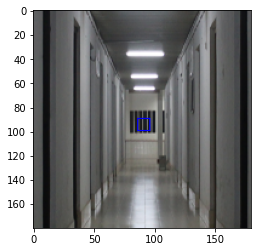

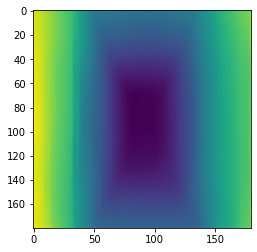

(75.01941747573028, 146.02568117758025)
50 (75.01941747573028, 146.02568117758025) turn right 0.8258333333333333 0.09789359999990666 0.3406338999999434 correct
(73.45257021727429, 151.12241653417766)
51 (73.45257021727429, 151.12241653417766) turn right 0.8283333333333334 0.0980726999999888 0.3604423000000452 correct
(66.66019417475883, 139.0300970873821)
(68.11034980166127, 24.613775694194846)
(67.92358803986696, 174.98671096345478)
52 (66.66019417475883, 139.0300970873821) turn right 0.1375 0.09513159999994514 0.3727676999999403 wrong


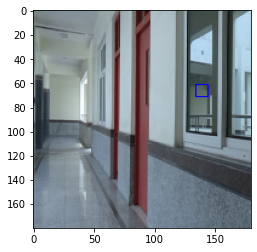

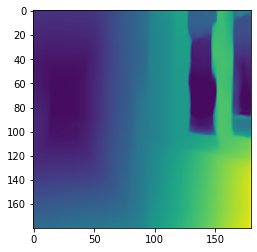

(65.91737288135812, 86.01991525424026)
53 (65.91737288135812, 86.01991525424026) turn left 0.4975 0.09505529999989903 0.3082574999999679 correct
(67.47183979974183, 26.128017164309536)
54 (67.47183979974183, 26.128017164309536) turn left 0.15833333333333333 0.0930250999999771 0.41906070000004547 correct
(59.08520179371402, 85.61178731581158)
55 (59.08520179371402, 85.61178731581158) turn left 0.48083333333333333 0.09320639999998548 0.44452750000004926 correct
(70.76589986467756, 23.890843482181577)
56 (70.76589986467756, 23.890843482181577) turn left 0.1575 0.0927087999999685 0.3804188000000295 correct
(91.72821905407844, 26.639737497169538)
57 (91.72821905407844, 26.639737497169538) turn left 0.15416666666666667 0.09566269999993438 0.3837075999999797 correct
(78.28667434715045, 156.51497695850904)
58 (78.28667434715045, 156.51497695850904) turn right 0.8275 0.09372929999994994 0.40676089999999476 correct
(87.46353599750216, 21.983050847454997)
59 (87.46353599750216, 21.983050847454997

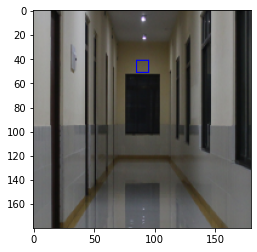

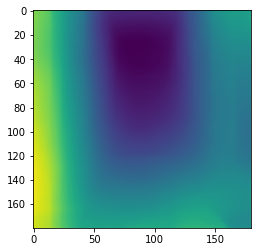

(71.7502612330179, 45.059561128525175)
62 (71.7502612330179, 45.059561128525175) turn left 0.2808333333333333 0.09079410000003918 0.35805419999996957 correct
(76.03933333332854, 147.25199999999006)
63 (76.03933333332854, 147.25199999999006) turn right 0.8258333333333333 0.04591919999995753 0.34071110000002136 correct
(56.88727179879817, 132.50453210774504)
(0.0, 179.0)
64 (56.88727179879817, 132.50453210774504) turn right 0.7183333333333334 0.04607260000000224 0.4558958000000075 correct
(77.16679132385208, 24.66746447269757)
65 (77.16679132385208, 24.66746447269757) turn left 0.14333333333333334 0.046184100000004946 0.416308699999945 correct
(61.341655172410114, 26.534068965515605)
66 (61.341655172410114, 26.534068965515605) turn left 0.195 0.09772639999994226 0.4845242999999755 correct
(70.21144629264167, 130.0363687623336)
(69.26436781609368, 47.7391688771012)
(71.68684210526293, 163.8736842105259)
67 (70.21144629264167, 130.0363687623336) turn right 0.7225 0.09528639999996358 0.4067

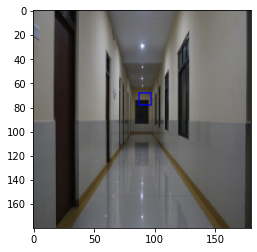

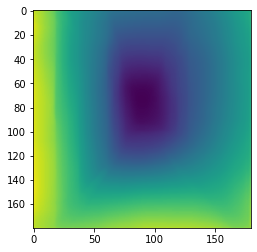

(68.2521647861437, 33.90553660456486)
88 (68.2521647861437, 33.90553660456486) turn left 0.20833333333333334 0.09244880000005651 0.3579101999999921 correct
(56.5644356955355, 30.631102362203517)
89 (56.5644356955355, 30.631102362203517) turn left 0.1875 0.09104739999997946 0.48673699999994824 correct
(76.66043613707413, 88.21767912772877)
90 (76.66043613707413, 88.21767912772877) turn left 0.4875 0.09101750000002085 0.31098640000004707 correct
(81.08520879406561, 24.833224925197452)
91 (81.08520879406561, 24.833224925197452) turn left 0.1575 0.09104050000007646 0.49104829999998856 correct
(68.6021721641153, 138.50603378921235)
92 (68.6021721641153, 138.50603378921235) turn right 0.7758333333333334 0.09034500000007029 0.4849087000000054 correct
(79.40836274775859, 26.200108607113393)
93 (79.40836274775859, 26.200108607113393) turn left 0.15416666666666667 0.04572619999999006 0.3060010000000375 correct
(74.30807248764317, 87.51510159253029)
94 (74.30807248764317, 87.51510159253029) turn 

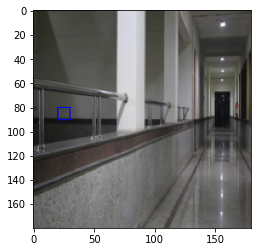

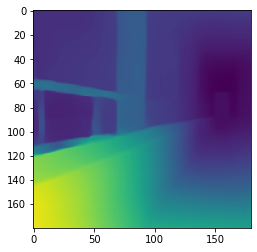

(69.21649484535662, 151.7837394564114)
96 (69.21649484535662, 151.7837394564114) turn right 0.8283333333333334 0.09784830000000966 0.5181408999999348 correct
(47.31499133449053, 164.9449740034722)
(70.31100478469132, 24.14869341185216)
(43.0, 120.75000000000001)
(72.38709677419351, 120.58064516129028)
97 (72.38709677419351, 120.58064516129028) turn right 0.1375 0.09718460000010509 0.4058017000000973 wrong


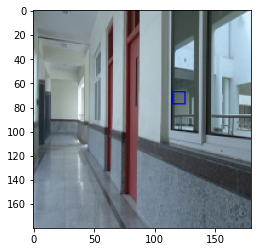

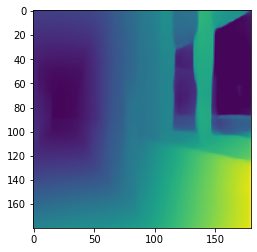

(62.4733865119595, 152.73749093544728)
98 (62.4733865119595, 152.73749093544728) turn right 0.7916666666666666 0.09470460000000003 0.4691125000000511 correct
(76.52811594202882, 46.337971014492716)
99 (76.52811594202882, 46.337971014492716) turn left 0.2808333333333333 0.09424819999992451 0.3476152999999158 correct
(83.07986798680167, 36.53894389439058)
100 (83.07986798680167, 36.53894389439058) turn left 0.20833333333333334 0.09218129999999292 0.3309979000000567 correct
(67.92332268370838, 87.52012779552996)
101 (67.92332268370838, 87.52012779552996) turn left 0.49583333333333335 0.09088339999993877 0.332675399999971 correct
(69.6782738095171, 156.08437499998482)
102 (69.6782738095171, 156.08437499998482) turn right 0.8033333333333333 0.09084189999998671 0.457575899999938 correct
(76.30273224043306, 152.1213114754004)
103 (76.30273224043306, 152.1213114754004) turn right 0.8258333333333333 0.04606319999993502 0.43524330000002465 correct
(52.33778234086415, 168.5687885010323)
(59.03592

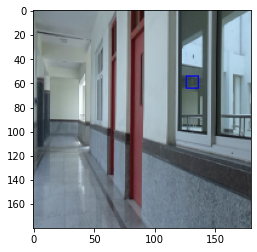

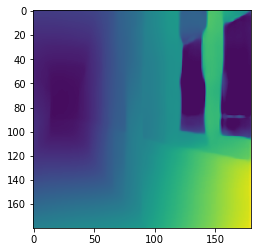

(80.93334709037681, 19.937680561285926)
105 (80.93334709037681, 19.937680561285926) turn left 0.1675 0.09774709999999232 0.398907099999974 correct
(79.23759099934094, 144.41032428855567)
106 (79.23759099934094, 144.41032428855567) turn right 0.805 0.09412439999994149 0.3319199000000026 correct
(66.1320927394765, 147.3398413666901)
107 (66.1320927394765, 147.3398413666901) turn right 0.8025 0.09365730000001804 0.342072499999972 correct
(42.47537897553018, 66.84484296047185)
108 (42.47537897553018, 66.84484296047185) turn left 0.48833333333333334 0.09194250000007287 0.7177355000000034 correct
(0.0, 179.0)
(48.87434130523073, 161.90879610863982)
(67.74437116215192, 86.84307482373801)
109 (67.74437116215192, 86.84307482373801) turn left 0.4708333333333333 0.09173699999996643 0.46445189999997183 correct
(72.55055611728764, 86.44009100100799)
110 (72.55055611728764, 86.44009100100799) turn left 0.4875 0.09122960000001967 0.36127350000003844 correct
(71.21638330757095, 145.55358062853773)
111

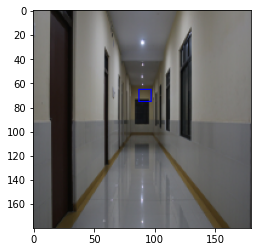

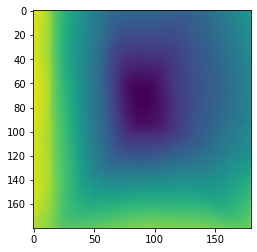

(69.89686311786662, 151.6851235741368)
142 (69.89686311786662, 151.6851235741368) turn right 0.8283333333333334 0.0914465000000746 0.37025790000006964 correct
(78.81958762885789, 24.02768232149429)
143 (78.81958762885789, 24.02768232149429) turn left 0.175 0.09047670000006747 0.40485960000000887 correct
(77.21171335030098, 23.427246271368777)
144 (77.21171335030098, 23.427246271368777) turn left 0.175 0.04587340000000495 0.3689264000000776 correct
(74.31121495327287, 99.9607476635539)
145 (74.31121495327287, 99.9607476635539) turn right 0.5466666666666666 0.04626430000007531 0.29297910000002503 correct
(70.72835269271214, 84.628035902849)
(62.94953271028091, 172.1869158878522)
146 (70.72835269271214, 84.628035902849) turn left 0.4708333333333333 0.046241699999995944 0.33124629999997524 correct
(81.39354686763565, 144.8219500706474)
147 (81.39354686763565, 144.8219500706474) turn right 0.7958333333333333 0.0979614999999967 0.37980799999991177 correct
(70.25803966877768, 23.2070094357766

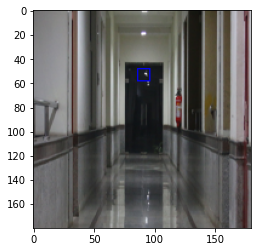

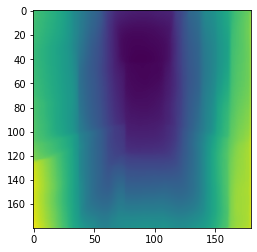

(66.16685979142598, 82.49797219003499)
160 (66.16685979142598, 82.49797219003499) turn left 0.4766666666666667 0.09313780000002225 0.346436199999971 correct
(75.27133550488823, 85.57654723127322)
161 (75.27133550488823, 85.57654723127322) turn left 0.4841666666666667 0.09164269999996577 0.33059739999998783 correct
(73.23613363607105, 84.59325332468671)
162 (73.23613363607105, 84.59325332468671) turn left 0.4766666666666667 0.09055269999998927 0.33035319999999047 correct
(91.0098911968263, 157.51256181996442)
163 (91.0098911968263, 157.51256181996442) turn right 0.8275 0.09091680000005908 0.39959029999999984 correct
(70.94836892747759, 151.18704529452359)
164 (70.94836892747759, 151.18704529452359) turn right 0.8283333333333334 0.046024799999941024 0.3295002999999497 correct
(58.61448168575466, 150.3553952764701)
165 (58.61448168575466, 150.3553952764701) turn right 0.7916666666666666 0.04615879999994377 0.423983499999963 correct
(69.11556764105184, 150.4221617946783)
166 (69.1155676410

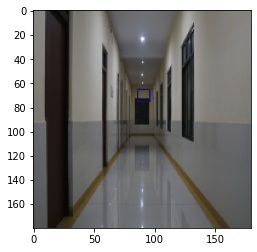

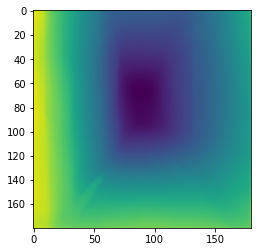

(52.34828908135301, 30.925741871359264)
169 (52.34828908135301, 30.925741871359264) turn left 0.1975 0.09403870000005554 0.4725895000000264 correct
(94.91462217859441, 156.61629048084313)
170 (94.91462217859441, 156.61629048084313) turn right 0.8275 0.09213820000002215 0.5780490000000782 correct
(59.46155837431847, 36.645094486149496)
171 (59.46155837431847, 36.645094486149496) turn left 0.23416666666666666 0.09146150000003672 0.35788930000001073 correct
(70.85122349101832, 27.04306688417264)
172 (70.85122349101832, 27.04306688417264) turn left 0.16 0.04635089999999309 0.3952311999998983 correct
(73.256644144146, 31.00878378378439)
173 (73.256644144146, 31.00878378378439) turn left 0.21833333333333332 0.0463488000000325 0.4908480999999938 correct
(63.83344851416361, 140.92513245795095)
174 (63.83344851416361, 140.92513245795095) turn right 0.7916666666666666 0.046529899999995905 0.3290730999999596 correct
(70.42941003815747, 137.83240387437783)
175 (70.42941003815747, 137.8324038743778

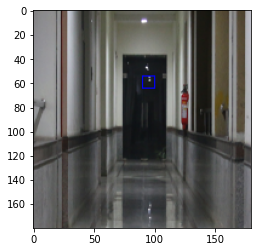

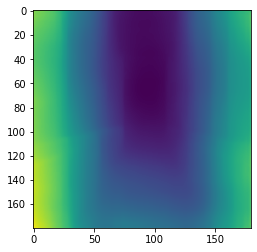

(70.27677888293067, 23.033473603670192)
182 (70.27677888293067, 23.033473603670192) turn left 0.175 0.045984399999952075 0.49916269999994256 correct
(63.19870254684959, 83.48702546852063)
183 (63.19870254684959, 83.48702546852063) turn left 0.48083333333333333 0.09784799999999905 0.37439849999998387 correct
(53.93525931081868, 133.41750783151937)
184 (53.93525931081868, 133.41750783151937) turn right 0.7183333333333334 0.0948331000000735 0.42766500000004726 correct
(57.91858789625068, 83.30835734869893)
185 (57.91858789625068, 83.30835734869893) turn left 0.48833333333333334 0.0943169999999327 0.3719208999999637 correct
(76.85781990521431, 133.67240247904172)
186 (76.85781990521431, 133.67240247904172) turn right 0.7758333333333334 0.09463470000002872 0.7112838000000465 correct
(61.41123882502535, 92.88122605362928)
187 (61.41123882502535, 92.88122605362928) turn right 0.4975 0.09280499999999847 0.4178575000000819 wrong


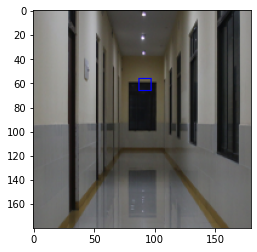

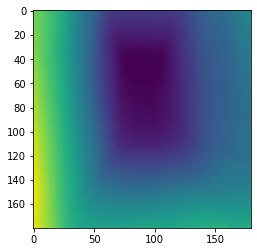

(0.0, 1.0)
(75.76376350921613, 24.715193897011435)
188 (75.76376350921613, 24.715193897011435) turn left 0.23416666666666666 0.09120129999996607 0.4996123999999327 correct
(73.8240198687158, 80.46318963987017)
189 (73.8240198687158, 80.46318963987017) turn left 0.455 0.09079610000003413 0.42021699999997963 correct
(80.13067935957842, 20.332107312850038)
190 (80.13067935957842, 20.332107312850038) turn left 0.1675 0.09032700000000204 0.38136789999998655 correct
(80.46472211272373, 157.153330705542)
191 (80.46472211272373, 157.153330705542) turn right 0.8708333333333333 0.04557280000005903 0.4915527000000566 correct
(56.31575358035591, 133.40827460785715)
192 (56.31575358035591, 133.40827460785715) turn right 0.7183333333333334 0.0459425999999894 0.33293849999995473 correct
(74.44563986409929, 100.26585503963727)
193 (74.44563986409929, 100.26585503963727) turn right 0.5466666666666666 0.046013399999992544 0.29952160000004824 correct
(55.00000000000164, 168.00389711613835)
(75.1897018970

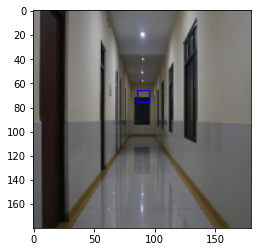

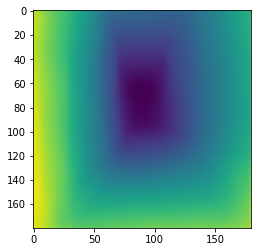

(74.63144635446835, 152.40071132185838)
202 (74.63144635446835, 152.40071132185838) turn right 0.7958333333333333 0.04564159999995354 0.41408560000002126 correct
(81.66596031592344, 23.82488923135954)
203 (81.66596031592344, 23.82488923135954) turn left 0.1575 0.04564340000001721 0.3595523999999841 correct
(69.67042678545756, 90.28495473487666)
204 (69.67042678545756, 90.28495473487666) turn right 0.49083333333333334 0.09795340000005126 0.8550950000000057 wrong


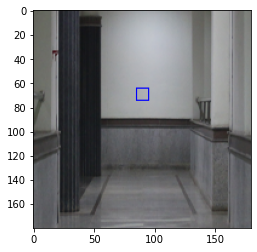

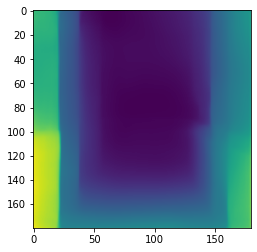

(59.836899138648825, 17.759377604890048)
(73.87019641332388, 150.6891545687487)
(92.8461538461537, 44.14102564102553)
(116.99999999999999, 11.5)
205 (92.8461538461537, 44.14102564102553) turn left 0.82 0.09471199999995861 0.39814560000002075 wrong


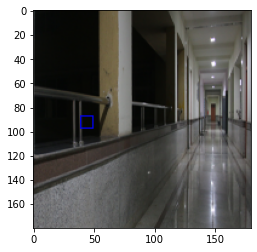

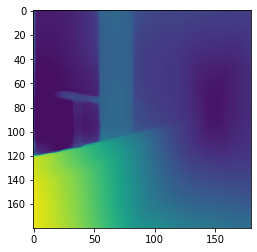

(72.86680761099196, 85.94635306553691)
206 (72.86680761099196, 85.94635306553691) turn left 0.4816666666666667 0.09342760000004091 0.35806860000002416 correct
(58.78887251290049, 136.36993367724088)
207 (58.78887251290049, 136.36993367724088) turn right 0.8383333333333334 0.09258550000004107 0.6064820999999938 correct
(71.35763985527309, 99.76036738101789)
208 (71.35763985527309, 99.76036738101789) turn right 0.5466666666666666 0.09110210000005736 0.3487096000000065 correct
(87.6232479910207, 33.36666043729784)
209 (87.6232479910207, 33.36666043729784) turn left 0.225 0.090348199999994 0.4095855999999003 correct
(76.4528837621915, 23.781721384203085)
210 (76.4528837621915, 23.781721384203085) turn left 0.14333333333333334 0.09063330000003589 0.42042719999994915 correct
(80.05382726155683, 36.7554236594318)
211 (80.05382726155683, 36.7554236594318) turn left 0.225 0.09021629999995184 0.393354899999963 correct
(64.87804878049, 40.835710998620684)
212 (64.87804878049, 40.835710998620684) 

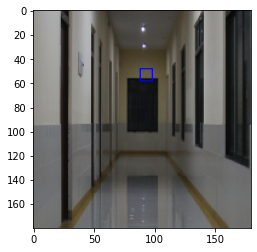

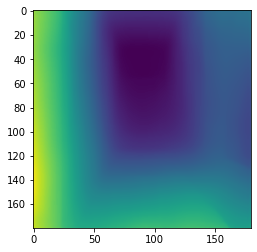

(63.21749049429019, 24.340114068438545)
218 (63.21749049429019, 24.340114068438545) turn left 0.1575 0.045673800000031406 0.36101220000000467 correct
(64.73874195854185, 31.497855611150744)
219 (64.73874195854185, 31.497855611150744) turn left 0.1825 0.09786889999998039 0.525828899999965 correct
(70.90003829950453, 91.44197625431181)
220 (70.90003829950453, 91.44197625431181) turn right 0.4975 0.09463060000007317 0.3173563999999942 wrong


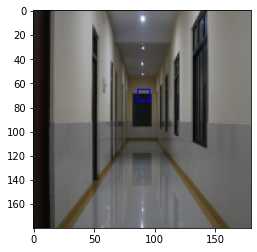

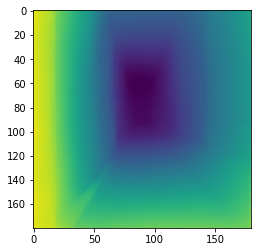

(53.87712418300846, 157.1755991285457)
(71.52531924262667, 23.646411272567928)
(92.26666666666667, 141.53333333333333)
221 (92.26666666666667, 141.53333333333333) turn right 0.1375 0.09245840000005501 0.3853017000000136 wrong


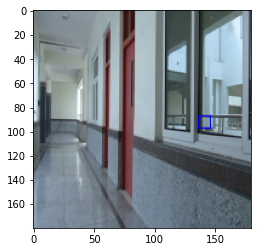

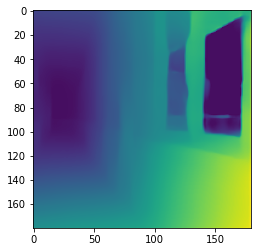

(71.76528808766612, 145.2287027218148)
(81.47368421052612, 169.6766917293229)
(82.66666666666666, 177.55555555555557)
222 (71.76528808766612, 145.2287027218148) turn right 0.8025 0.09298929999999928 0.4709426000000576 correct
(66.77930423221372, 85.07578107688302)
223 (66.77930423221372, 85.07578107688302) turn left 0.4841666666666667 0.09123469999997269 0.37999939999997423 correct
(67.7475504322764, 86.91757925072022)
224 (67.7475504322764, 86.91757925072022) turn left 0.4975 0.09051360000000841 0.3436808999999812 correct
(61.0991517987718, 38.315004387247896)
225 (61.0991517987718, 38.315004387247896) turn left 0.23416666666666666 0.04571080000005168 0.2982566000000588 correct
(64.13871428570927, 146.36471428570218)
226 (64.13871428570927, 146.36471428570218) turn right 0.8008333333333333 0.0454527000000553 0.42741960000000745 correct
(64.48761904761389, 30.49227513227266)
227 (64.48761904761389, 30.49227513227266) turn left 0.23416666666666666 0.04563010000003942 0.34472150000010515

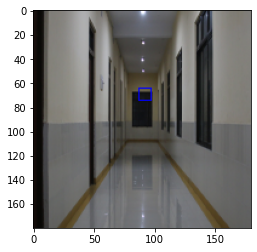

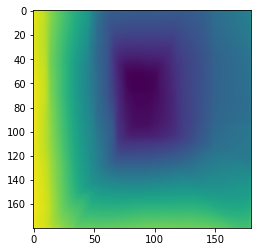

(84.53708004334038, 158.64684935746732)
249 (84.53708004334038, 158.64684935746732) turn right 0.7958333333333333 0.04600160000006781 0.4091061000000309 correct
(67.68221052631874, 144.57842105263782)
250 (67.68221052631874, 144.57842105263782) turn right 0.8008333333333333 0.046193299999913506 0.6513439999999946 correct
(86.75031814710817, 142.4596589462927)
251 (86.75031814710817, 142.4596589462927) turn right 0.7958333333333333 0.09785480000005009 0.36686329999997724 correct
(69.62054439404034, 86.39792611795477)
252 (69.62054439404034, 86.39792611795477) turn left 0.4975 0.09495459999993727 0.3356681999999864 correct
(70.74958457958553, 87.53472914588457)
253 (70.74958457958553, 87.53472914588457) turn left 0.4841666666666667 0.09467730000005758 0.4390322000000424 correct
(62.61876872786267, 65.60800871696698)
254 (62.61876872786267, 65.60800871696698) turn left 0.5033333333333333 0.09267099999999573 0.4828674000000319 wrong


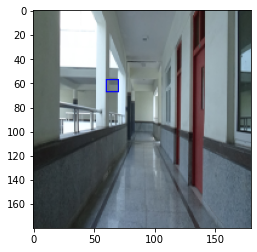

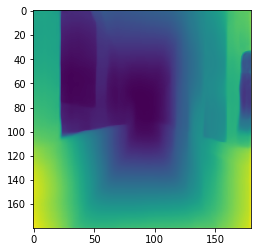

(83.87640175523772, 143.02901023890195)
255 (83.87640175523772, 143.02901023890195) turn right 0.7958333333333333 0.09132030000000668 0.36768879999999626 correct
(95.11557637104303, 156.37890920076933)
256 (95.11557637104303, 156.37890920076933) turn right 0.8275 0.09052139999994324 0.45604309999998804 correct
(66.33811270423733, 147.9543181060404)
257 (66.33811270423733, 147.9543181060404) turn right 0.8025 0.04567819999999756 0.2820069000000558 correct
(67.89073097211507, 22.26877668927322)
258 (67.89073097211507, 22.26877668927322) turn left 0.175 0.04569630000003144 0.3170473000000129 correct
(66.83754960317171, 87.46974206348838)
259 (66.83754960317171, 87.46974206348838) turn left 0.49583333333333335 0.045909199999982775 0.31822939999995015 correct
(69.4525450099977, 31.913091798175145)
260 (69.4525450099977, 31.913091798175145) turn left 0.20833333333333334 0.09001680000005763 0.3778750999999829 correct
(82.6388487127509, 24.789846687877596)
261 (82.6388487127509, 24.78984668787

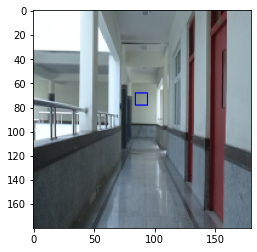

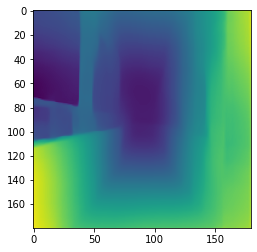

(43.831798021154725, 164.36608665984838)
267 (43.831798021154725, 164.36608665984838) turn right 0.8008333333333333 0.0904805000000124 0.3250871999999845 correct
(77.0666255397839, 20.707382274314448)
268 (77.0666255397839, 20.707382274314448) turn left 0.1675 0.09041830000001028 0.3959697000000233 correct
(72.26382273762083, 155.79685235036933)
269 (72.26382273762083, 155.79685235036933) turn right 0.8683333333333333 0.04598160000000462 0.3475996000000805 correct
(79.1354560172676, 157.0156502968125)
270 (79.1354560172676, 157.0156502968125) turn right 0.8708333333333333 0.04602080000006481 0.30808140000010553 correct
(66.45681243222963, 87.430610769777)
271 (66.45681243222963, 87.430610769777) turn left 0.4816666666666667 0.04595910000000458 0.3734183999999914 correct
(66.94820356820578, 90.4778426375178)
272 (66.94820356820578, 90.4778426375178) turn right 0.49083333333333334 0.09826109999994515 0.6596752999998898 wrong


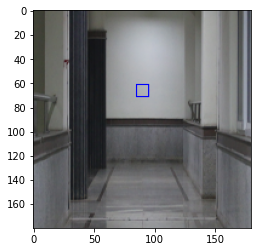

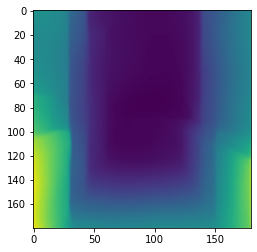

(69.14690663666605, 23.98335208098831)
273 (69.14690663666605, 23.98335208098831) turn left 0.14333333333333334 0.09390089999999418 0.38289800000006835 correct
(85.45915107256035, 20.060094325267883)
274 (85.45915107256035, 20.060094325267883) turn left 0.1675 0.09227019999991626 0.5941009999999096 correct
(73.87354085603383, 85.95992217899116)
275 (73.87354085603383, 85.95992217899116) turn left 0.4841666666666667 0.09128889999999501 0.31234330000006594 correct
(83.44143204727355, 78.3194299617685)
276 (83.44143204727355, 78.3194299617685) turn left 0.455 0.09069580000004862 0.32249130000002424 correct
(76.23572474377752, 143.11976573938614)
277 (76.23572474377752, 143.11976573938614) turn right 0.8 0.04636649999997644 0.2978120000000217 correct
(67.7691699604679, 155.7063241106566)
278 (67.7691699604679, 155.7063241106566) turn right 0.8683333333333333 0.046353999999951156 0.35573599999997896 correct
(75.6027925776149, 102.72533529302541)
279 (75.6027925776149, 102.72533529302541) tu

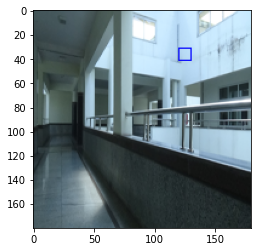

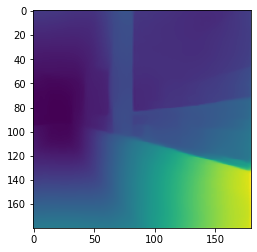

(57.60217049835336, 28.667285449090972)
2 (57.60217049835336, 28.667285449090972) turn left 0.15416666666666667 0.09782260000008591 0.47481790000006185 correct
(70.12581716858035, 39.430607651914535)
3 (70.12581716858035, 39.430607651914535) turn left 0.2808333333333333 0.09502550000001975 0.5557703000000629 correct
(73.64690515538973, 117.2817614756874)
4 (73.64690515538973, 117.2817614756874) turn right 0.4975 0.09304689999999027 0.889189999999985 wrong


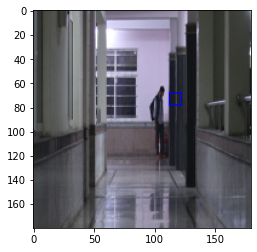

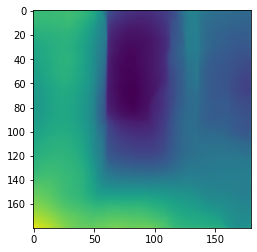

(87.04297073254291, 146.25562510575173)
5 (87.04297073254291, 146.25562510575173) turn right 0.8033333333333333 0.09806000000003223 0.7873985999999604 correct
(76.03882887113531, 87.60216063878663)
6 (76.03882887113531, 87.60216063878663) turn left 0.495 0.09383760000002894 0.4480670000000373 correct
(62.1235847769713, 84.67507843404229)
7 (62.1235847769713, 84.67507843404229) turn left 0.4766666666666667 0.09364229999994222 0.4820876999999655 correct
(72.953093694756, 28.25374189746622)
8 (72.953093694756, 28.25374189746622) turn left 0.1575 0.09832269999992604 0.5275143999999727 correct
(73.27330873309634, 39.600820008204884)
9 (73.27330873309634, 39.600820008204884) turn left 0.1975 0.09523400000000493 0.6573568000000023 correct
(75.809253840534, 144.63579005122014)
10 (75.809253840534, 144.63579005122014) turn right 0.7916666666666666 0.09307290000003832 0.6120438000000377 correct
(72.95362020098601, 135.6534398351087)
(0.0, 179.0)
11 (72.95362020098601, 135.6534398351087) turn rig

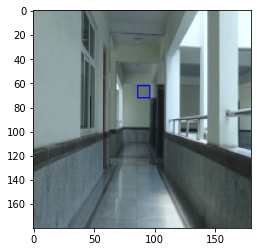

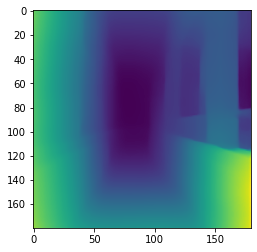

(66.11790626251494, 135.77300040058037)
(83.61235521235744, 18.01621621621672)
44 (66.11790626251494, 135.77300040058037) turn right 0.7758333333333334 0.0948951999999963 0.5364382999999862 correct
(0.0, 179.0)
(73.50954177897849, 145.55018867925028)
45 (73.50954177897849, 145.55018867925028) turn right 0.8033333333333333 0.09775490000004083 0.694723999999951 correct
(64.16349189071703, 85.3105475127924)
46 (64.16349189071703, 85.3105475127924) turn left 0.48083333333333333 0.09521430000006603 0.5514858000000231 correct
(70.25442580406543, 36.743627769027285)
47 (70.25442580406543, 36.743627769027285) turn left 0.1975 0.09314469999992525 0.6015573999999333 correct
(65.85282361381914, 142.54340473506969)
48 (65.85282361381914, 142.54340473506969) turn right 0.7916666666666666 0.09181250000006003 0.5662207000000308 correct
(96.66166883963209, 92.31812255540697)
49 (96.66166883963209, 92.31812255540697) turn right 0.495 0.09195599999998194 0.4951399000000265 wrong


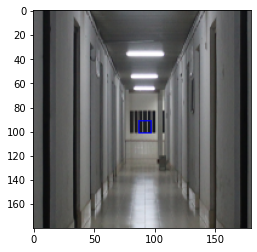

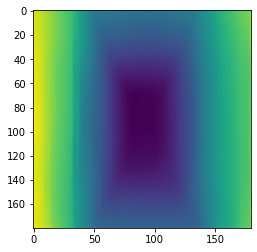

(66.99921647638378, 144.7980747705428)
(0.0, 179.0)
50 (66.99921647638378, 144.7980747705428) turn right 0.8258333333333333 0.09067579999998543 0.5353364999999712 correct
(69.48884854771539, 151.91014004148832)
51 (69.48884854771539, 151.91014004148832) turn right 0.8283333333333334 0.09057540000003428 0.6325152000000571 correct
(64.37561732749592, 26.58021729927846)
(61.90184921764037, 139.04907539118483)
(59.72483221476581, 173.5654362416131)
52 (61.90184921764037, 139.04907539118483) turn right 0.1375 0.04618190000007871 0.4985532000000603 wrong


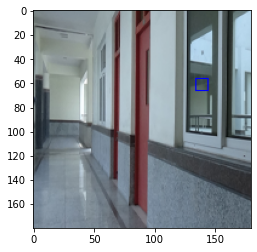

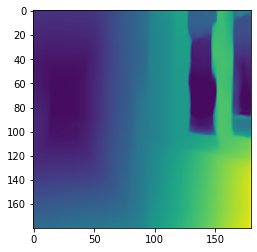

(58.151316768332414, 88.65496205920871)
53 (58.151316768332414, 88.65496205920871) turn left 0.4975 0.04623300000002928 0.4153807999999799 correct
(70.55062807209417, 30.8489350081932)
54 (70.55062807209417, 30.8489350081932) turn left 0.15833333333333333 0.0980406999999559 0.5502943000000187 correct
(69.03876532002424, 82.78819791194563)
55 (69.03876532002424, 82.78819791194563) turn left 0.48083333333333333 0.09499479999999494 0.6145923999999923 correct
(67.97078415332517, 30.04136963889238)
56 (67.97078415332517, 30.04136963889238) turn left 0.1575 0.09529029999998784 0.5268593000000692 correct
(97.50629633988537, 30.002824526303513)
57 (97.50629633988537, 30.002824526303513) turn left 0.15416666666666667 0.09295589999999265 0.6606426000000738 correct
(79.8239554902408, 150.99800545875146)
58 (79.8239554902408, 150.99800545875146) turn right 0.8275 0.09324679999997443 0.5608108000000129 correct
(86.58844283399195, 28.78058548679549)
59 (86.58844283399195, 28.78058548679549) turn lef

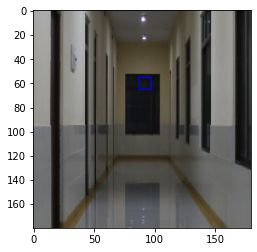

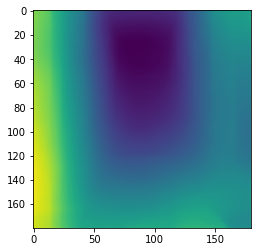

(67.33539698056006, 41.31801889866542)
62 (67.33539698056006, 41.31801889866542) turn left 0.2808333333333333 0.09227659999999105 0.5484809000000723 correct
(70.12886124987634, 144.53389744113346)
(0.0, 179.0)
63 (70.12886124987634, 144.53389744113346) turn right 0.8258333333333333 0.09650569999996605 0.7129596999999421 correct
(60.145907053539325, 112.13417079497978)
64 (60.145907053539325, 112.13417079497978) turn right 0.7183333333333334 0.09385700000007091 0.8242859000000635 correct
(77.95574079587706, 31.801528232611012)
65 (77.95574079587706, 31.801528232611012) turn left 0.14333333333333334 0.0923137999999426 0.5791219000000183 correct
(75.05625182163132, 31.202662003305537)
66 (75.05625182163132, 31.202662003305537) turn left 0.195 0.09098199999993994 0.5867026999999325 correct
(63.75851885506687, 133.95218082689863)
(68.75539033457432, 47.45873605948088)
67 (68.75539033457432, 47.45873605948088) turn left 0.7225 0.09049239999990277 0.7188453999999638 wrong


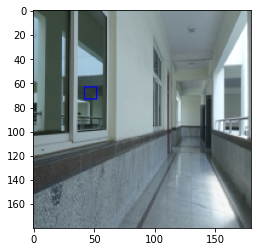

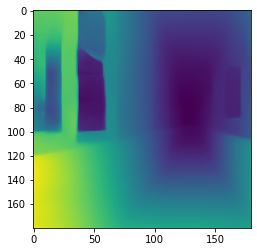

(72.78363289759963, 85.01579520696687)
68 (72.78363289759963, 85.01579520696687) turn left 0.4766666666666667 0.09057769999992615 0.481288999999947 correct
(77.11275888519366, 47.271030426999296)
69 (77.11275888519366, 47.271030426999296) turn left 0.2808333333333333 0.04583900000000085 0.45362520000003315 correct
(50.95662650602475, 84.13092369477994)
(65.95096322241758, 20.565674255692006)
70 (50.95662650602475, 84.13092369477994) turn left 0.47333333333333333 0.0456302999999707 0.5016966999999113 correct
(97.71576548581454, 144.9603273254681)
71 (97.71576548581454, 144.9603273254681) turn right 0.805 0.04601040000000012 0.5161941999999726 correct
(89.72928479971576, 36.113590634720715)
72 (89.72928479971576, 36.113590634720715) turn left 0.225 0.09814759999994749 0.6147558999999774 correct
(101.31965392260082, 30.412019174558814)
73 (101.31965392260082, 30.412019174558814) turn left 0.15416666666666667 0.09499699999992117 0.6646357999999282 correct
(0.0, 179.0)
(71.00202195263329, 1

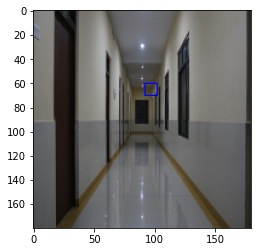

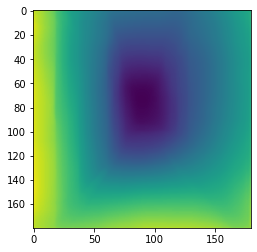

(64.58796537699703, 35.57253102513477)
88 (64.58796537699703, 35.57253102513477) turn left 0.20833333333333334 0.09792019999997592 0.5655963999998903 correct
(71.77959629024112, 36.77905073650106)
89 (71.77959629024112, 36.77905073650106) turn left 0.1875 0.09796910000000025 0.6178097999999181 correct
(74.7414738124159, 88.99025578561738)
90 (74.7414738124159, 88.99025578561738) turn left 0.4875 0.09512159999997039 0.4581334000000652 correct
(85.71886792453701, 31.932614555259097)
91 (85.71886792453701, 31.932614555259097) turn left 0.1575 0.09313329999997677 0.7562014999999747 correct
(72.48639129043404, 136.9097822606644)
(0.0, 179.0)
92 (72.48639129043404, 136.9097822606644) turn right 0.7758333333333334 0.09145739999996749 0.6640231000000085 correct
(80.50952796113963, 29.15107734462519)
93 (80.50952796113963, 29.15107734462519) turn left 0.15416666666666667 0.09181330000001253 0.5073670000000448 correct
(70.86057747613145, 88.48084665823174)
94 (70.86057747613145, 88.4808466582317

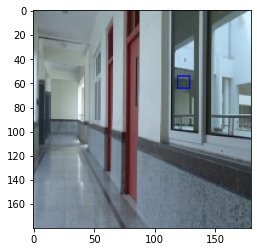

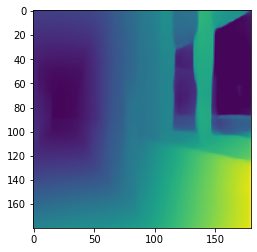

(72.6210608729743, 145.89019377569997)
98 (72.6210608729743, 145.89019377569997) turn right 0.7916666666666666 0.09214879999990444 0.5849759000000176 correct
(73.44270191553872, 41.91766550913039)
(93.0, 1.0)
99 (73.44270191553872, 41.91766550913039) turn left 0.2808333333333333 0.0909467000000177 0.5346531999999797 correct
(75.30355135985816, 34.11811643065921)
100 (75.30355135985816, 34.11811643065921) turn left 0.20833333333333334 0.09121589999995194 0.533752800000002 correct
(67.00854016546276, 85.49893247931251)
101 (67.00854016546276, 85.49893247931251) turn left 0.49583333333333335 0.09039899999993395 0.483195099999989 correct
(80.04083238612367, 145.8714697910445)
102 (80.04083238612367, 145.8714697910445) turn right 0.8033333333333333 0.09027200000002722 0.7613390000000209 correct
(79.77641347801908, 146.240719588818)
103 (79.77641347801908, 146.240719588818) turn right 0.8258333333333333 0.045924900000045454 0.5509425999999849 correct
(54.86453999075519, 168.21174294961304)
(

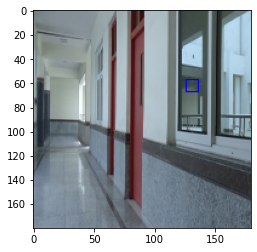

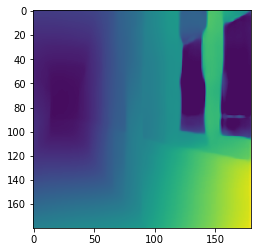

(76.70430939226743, 27.84795580110578)
105 (76.70430939226743, 27.84795580110578) turn left 0.1675 0.09757580000007238 0.5460133000000269 correct
(78.89187238342058, 144.16991482603063)
106 (78.89187238342058, 144.16991482603063) turn right 0.805 0.09615850000000137 0.4714212999999745 correct
(62.17178314826664, 148.65055519267833)
107 (62.17178314826664, 148.65055519267833) turn right 0.8025 0.09387980000008156 0.4970356000000038 correct
(58.69610016173518, 72.31707901514463)
108 (58.69610016173518, 72.31707901514463) turn left 0.48833333333333334 0.09253309999996873 0.9537200999999413 correct
(57.27754269306647, 109.27920507783654)
(96.93689320388339, 147.25242718446572)
109 (57.27754269306647, 109.27920507783654) turn right 0.4708333333333333 0.09072830000002341 0.6975300000000288 wrong


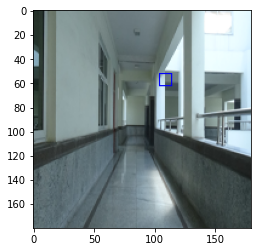

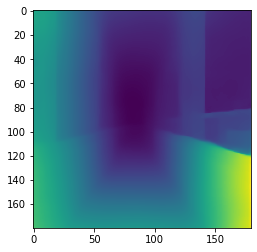

(70.72399150743125, 86.47416843595217)
110 (70.72399150743125, 86.47416843595217) turn left 0.4875 0.09028430000000753 0.5202467999999953 correct
(75.46001008573333, 146.84629349471385)
111 (75.46001008573333, 146.84629349471385) turn right 0.8025 0.04581329999996342 0.5237107000000378 correct
(79.33357204238844, 143.7738470352216)
112 (79.33357204238844, 143.7738470352216) turn right 0.805 0.04610990000003312 0.42266800000004423 correct
(66.55859815190544, 33.14525580347151)
113 (66.55859815190544, 33.14525580347151) turn left 0.1875 0.07897760000003018 0.6593414999999823 correct
(72.79813966402374, 86.06872136609176)
114 (72.79813966402374, 86.06872136609176) turn left 0.4841666666666667 0.09783140000001822 0.48367610000002514 correct
(52.79171817058226, 14.472187886279666)
(70.76019536019433, 87.06874236874101)
115 (70.76019536019433, 87.06874236874101) turn left 0.5033333333333333 0.09500869999999395 0.6314105999999811 wrong


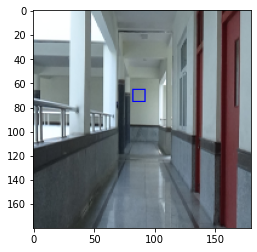

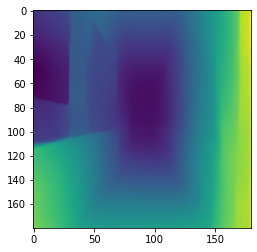

(57.62465735543179, 77.70186659704355)
116 (57.62465735543179, 77.70186659704355) turn left 0.49916666666666665 0.09310870000001614 0.76292669999998 correct
(68.3132991133975, 140.91544563696903)
117 (68.3132991133975, 140.91544563696903) turn right 0.8008333333333333 0.09145260000002509 0.6025903000000881 correct
(74.13070740970386, 133.54623333040234)
118 (74.13070740970386, 133.54623333040234) turn right 0.7225 0.09127929999999651 0.7615359999999782 correct
(64.22951320005426, 100.65649320920556)
119 (64.22951320005426, 100.65649320920556) turn right 0.5466666666666666 0.09036439999999857 0.45248370000001614 correct
(58.464202965709156, 82.06823447636762)
120 (58.464202965709156, 82.06823447636762) turn left 0.48833333333333334 0.04596030000004703 0.4815461000000596 correct
(65.22852532273966, 29.19451340615641)
121 (65.22852532273966, 29.19451340615641) turn left 0.14333333333333334 0.04625959999998486 0.461314399999992 correct
(81.27653631285712, 145.87718507840634)
122 (81.276536

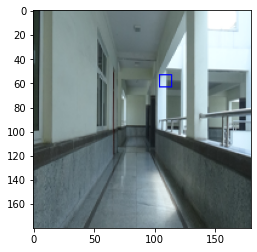

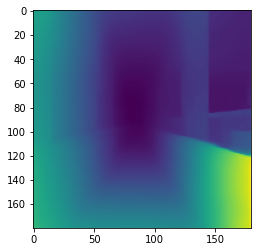

(70.49328585961723, 34.16124109867948)
137 (70.49328585961723, 34.16124109867948) turn left 0.20833333333333334 0.057904899999925874 0.5384275000000116 correct
(85.64137863699108, 146.55106424527457)
138 (85.64137863699108, 146.55106424527457) turn right 0.7958333333333333 0.09775569999999334 0.5931858000000148 correct
(62.97856600910951, 39.14766691957825)
139 (62.97856600910951, 39.14766691957825) turn left 0.20833333333333334 0.0949119999999084 0.596435999999926 correct
(88.76802973977303, 138.36992227103184)
140 (88.76802973977303, 138.36992227103184) turn right 0.8 0.0931071999998494 0.8828275999999278 correct
(62.51323468111956, 101.47717799083429)
141 (62.51323468111956, 101.47717799083429) turn right 0.4975 0.09275170000000799 0.5632545999999365 wrong


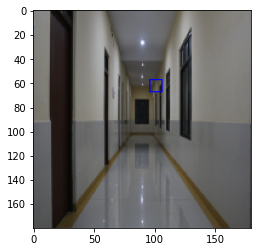

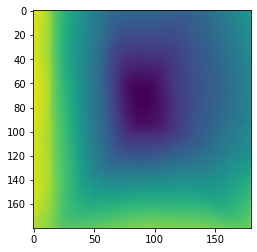

(68.82056005895286, 150.1858265782338)
142 (68.82056005895286, 150.1858265782338) turn right 0.8283333333333334 0.09108439999999973 0.510324300000093 correct
(75.99117235440077, 29.59199052643018)
143 (75.99117235440077, 29.59199052643018) turn left 0.175 0.09137779999991835 0.552250999999842 correct
(75.96924098252072, 28.114737773844592)
144 (75.96924098252072, 28.114737773844592) turn left 0.175 0.09069119999981012 0.5406866999999238 correct
(69.90247406224141, 101.16009577013752)
145 (69.90247406224141, 101.16009577013752) turn right 0.5466666666666666 0.04656669999985752 0.399545900000021 correct
(65.6516445963282, 91.28235796668427)
(40.789110429448996, 171.55368098159988)
(98.34482758620676, 170.96934865900346)
(106.5, 178.0)
146 (65.6516445963282, 91.28235796668427) turn right 0.4708333333333333 0.046236200000066674 0.7009250999999495 wrong


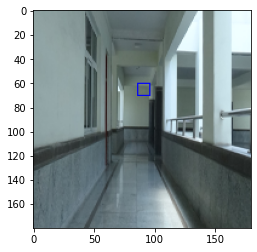

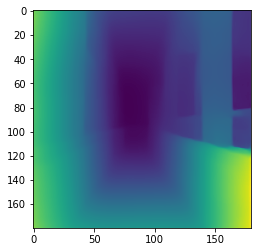

(75.86759277249416, 144.64445307947358)
(0.0, 179.0)
147 (75.86759277249416, 144.64445307947358) turn right 0.7958333333333333 0.09789969999997084 0.5940534999999727 correct
(67.21752121429398, 29.217999282897072)
148 (67.21752121429398, 29.217999282897072) turn left 0.195 0.09488440000018272 0.5230581000000711 correct
(82.83466693339255, 29.79365873174826)
149 (82.83466693339255, 29.79365873174826) turn left 0.20833333333333334 0.09435599999983424 0.5811125999998694 correct
(86.46468287445937, 39.06081754736104)
150 (86.46468287445937, 39.06081754736104) turn left 0.225 0.09247340000001714 0.6831306000001405 correct
(65.06996424314649, 42.63396901072688)
151 (65.06996424314649, 42.63396901072688) turn left 0.2808333333333333 0.09255209999992076 0.6579796999999417 correct
(71.39521019632404, 31.934731215954105)
152 (71.39521019632404, 31.934731215954105) turn left 0.15416666666666667 0.09236209999994571 0.5656042999999045 correct
(71.28626747261627, 144.43520967133742)
153 (71.28626747

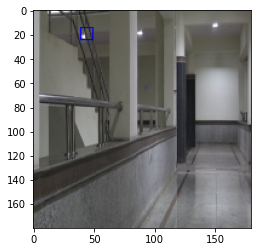

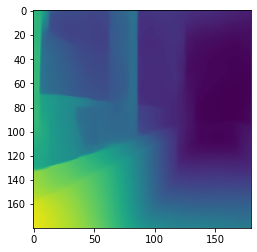

(71.366103067737, 140.71458945024577)
156 (71.366103067737, 140.71458945024577) turn right 0.8008333333333333 0.05625210000016523 0.6739638999999897 correct
(79.28915769027829, 145.27953381601304)
157 (79.28915769027829, 145.27953381601304) turn right 0.8 0.09804819999999381 0.6287292999998044 correct
(64.42687981053867, 30.670219064535335)
158 (64.42687981053867, 30.670219064535335) turn left 0.17416666666666666 0.09692010000003393 0.5256807000000663 correct
(65.15367067607102, 90.27944836167981)
159 (65.15367067607102, 90.27944836167981) turn right 0.49583333333333335 0.09786149999990812 0.5713475999998536 wrong


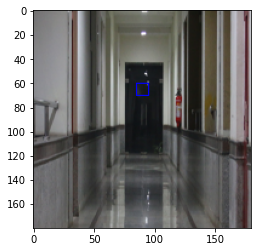

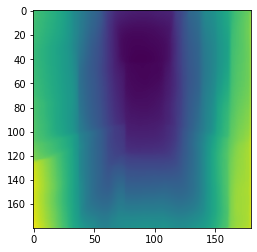

(61.76410460639549, 84.01061993893148)
160 (61.76410460639549, 84.01061993893148) turn left 0.4766666666666667 0.09450470000001587 0.49129390000007334 correct
(71.63085091518356, 83.44432024590736)
161 (71.63085091518356, 83.44432024590736) turn left 0.4841666666666667 0.093692400000009 0.4761602999999468 correct
(68.98395501919522, 83.62232583652809)
162 (68.98395501919522, 83.62232583652809) turn left 0.4766666666666667 0.09219169999983023 0.6156821999998101 correct
(91.85947641713871, 150.88241021203459)
163 (91.85947641713871, 150.88241021203459) turn right 0.8275 0.09103509999999915 0.5498432000001685 correct
(68.76270362265923, 149.93326039387128)
164 (68.76270362265923, 149.93326039387128) turn right 0.8283333333333334 0.04640400000016598 0.46693130000016936 correct
(70.31052311435909, 145.9641119221495)
165 (70.31052311435909, 145.9641119221495) turn right 0.7916666666666666 0.04666369999995368 0.5235185999999885 correct
(68.98880342712961, 143.68571706748162)
(36.8668094218428

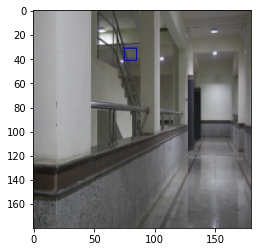

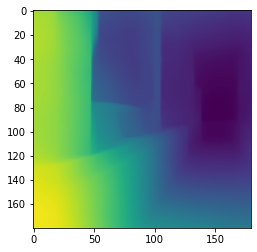

(66.0958270864554, 86.00499750124766)
167 (66.0958270864554, 86.00499750124766) turn left 0.48083333333333333 0.09388930000000073 0.5059542999999849 correct
(62.78588714813178, 97.01031715704728)
168 (62.78588714813178, 97.01031715704728) turn right 0.4975 0.0921670999998696 0.6352547999999842 wrong


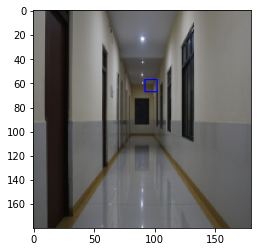

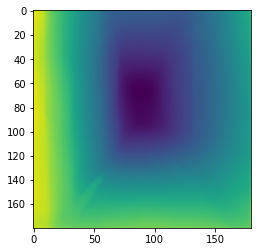

(66.59726126780319, 38.73419787793961)
169 (66.59726126780319, 38.73419787793961) turn left 0.1975 0.09207369999990078 0.6138475000000199 correct
(94.0264058679786, 148.96009779952098)
170 (94.0264058679786, 148.96009779952098) turn right 0.8275 0.09063500000002023 0.5827336999998352 correct
(61.95969125214595, 36.3933319039465)
171 (61.95969125214595, 36.3933319039465) turn left 0.23416666666666666 0.04609529999993356 0.5065756999999849 correct
(72.0179529508908, 32.34822534048869)
172 (72.0179529508908, 32.34822534048869) turn left 0.16 0.04602649999992536 0.5228062999999565 correct
(86.85551274452057, 37.20183758150726)
173 (86.85551274452057, 37.20183758150726) turn left 0.21833333333333332 0.09802930000000742 0.8436598000000686 correct
(65.24275284518156, 143.74210865364503)
(0.0, 179.0)
174 (65.24275284518156, 143.74210865364503) turn right 0.7916666666666666 0.09769630000005236 0.5562890000001062 correct
(67.84400656814056, 137.1191844553827)
175 (67.84400656814056, 137.11918445

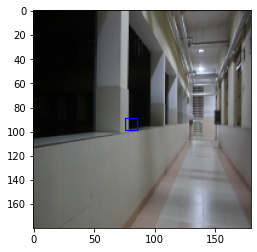

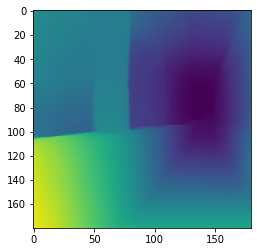

(74.70970528943656, 33.926754343863635)
180 (74.70970528943656, 33.926754343863635) turn left 0.16 0.09607950000008714 0.5949486000001798 correct
(79.40780002616715, 96.9697029184583)
181 (79.40780002616715, 96.9697029184583) turn right 0.49583333333333335 0.09826090000001386 0.7716972999999143 wrong


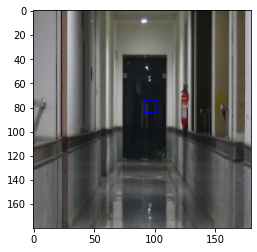

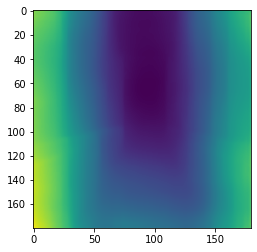

(70.79594286400224, 27.550234065538262)
182 (70.79594286400224, 27.550234065538262) turn left 0.175 0.09641309999983605 0.5209062999999787 correct
(61.616569304298785, 85.40334572490315)
183 (61.616569304298785, 85.40334572490315) turn left 0.48083333333333333 0.09368859999995038 0.632388199999923 correct
(60.8980968080358, 125.43713472202103)
184 (60.8980968080358, 125.43713472202103) turn right 0.7183333333333334 0.09244399999988673 0.6933200000000852 correct
(58.355374557926815, 79.74043510877999)
185 (58.355374557926815, 79.74043510877999) turn left 0.48833333333333334 0.09089059999996607 0.5525179999999636 correct
(82.80174911175965, 124.38021317296989)
186 (82.80174911175965, 124.38021317296989) turn right 0.7758333333333334 0.09072209999999359 0.8678511000000526 correct
(63.40884989878018, 96.14624505929527)
187 (63.40884989878018, 96.14624505929527) turn right 0.4975 0.04628649999995105 0.5471773000001576 wrong


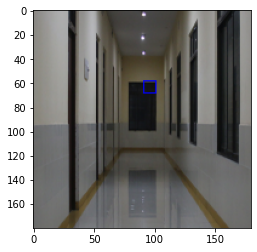

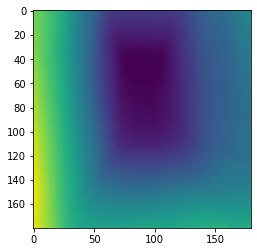

(83.0723474135647, 30.527871544569905)
188 (83.0723474135647, 30.527871544569905) turn left 0.23416666666666666 0.09783870000001116 0.6171205999999074 correct
(71.90091989268491, 81.95045994634532)
189 (71.90091989268491, 81.95045994634532) turn left 0.455 0.09391560000017307 0.5967087000001357 correct
(75.63939539347405, 26.144433781189957)
190 (75.63939539347405, 26.144433781189957) turn left 0.1675 0.09265660000005482 0.5190600000000813 correct
(89.37314162754959, 150.1973787167553)
191 (89.37314162754959, 150.1973787167553) turn right 0.8708333333333333 0.0909558000000743 0.5835787000000892 correct
(58.75584505220208, 128.42291433009717)
(0.0, 179.0)
192 (58.75584505220208, 128.42291433009717) turn right 0.7183333333333334 0.09041049999996176 0.7696846999999707 correct
(69.2455317902081, 101.62598886609037)
193 (69.2455317902081, 101.62598886609037) turn right 0.5466666666666666 0.04567599999995764 0.41817130000004 correct
(65.61164628206674, 91.25392358480663)
(50.86992187500178, 

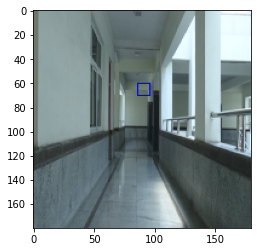

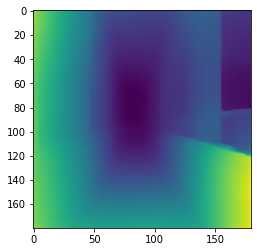

(73.15877974823749, 36.268032711571806)
195 (73.15877974823749, 36.268032711571806) turn left 0.16 0.09915490000003047 0.6385616000000027 correct
(70.75378307137079, 143.02499267793613)
196 (70.75378307137079, 143.02499267793613) turn right 0.8008333333333333 0.09750680000001921 0.6049853000001804 correct
(72.37131992149105, 151.30998527968364)
197 (72.37131992149105, 151.30998527968364) turn right 0.8708333333333333 0.09663610000006884 0.5250424999999268 correct
(63.868613138691806, 40.867010859893576)
198 (63.868613138691806, 40.867010859893576) turn left 0.20833333333333334 0.09378890000016327 0.789929900000061 correct
(63.816201700725195, 100.73937043113975)
199 (63.816201700725195, 100.73937043113975) turn right 0.5466666666666666 0.09368679999988672 0.4662020999999186 correct
(57.63361735088813, 35.05499612703216)
200 (57.63361735088813, 35.05499612703216) turn left 0.23416666666666666 0.09792640000000574 0.5049011000000974 correct
(68.39922545882327, 94.73682438119684)
201 (68.3

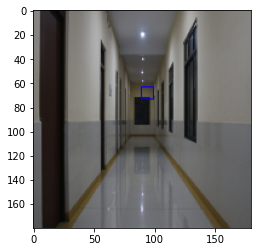

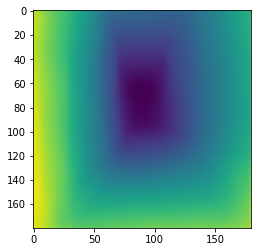

(83.30729455217755, 147.64192059096362)
202 (83.30729455217755, 147.64192059096362) turn right 0.7958333333333333 0.09513560000004873 0.6093003999999382 correct
(76.95263688277014, 29.202440936066075)
203 (76.95263688277014, 29.202440936066075) turn left 0.1575 0.09317850000002181 0.5390629999999419 correct
(77.73576950103396, 89.15190010268671)
204 (77.73576950103396, 89.15190010268671) turn left 0.49083333333333334 0.09322629999996934 1.016902200000004 correct
(56.77294769656407, 26.290439903010316)
(0.0, 179.0)
(65.42414334292116, 145.34266283023203)
205 (65.42414334292116, 145.34266283023203) turn right 0.82 0.091454800000065 0.6998036999998476 correct
(69.47383019778039, 85.08309213699873)
206 (69.47383019778039, 85.08309213699873) turn left 0.4816666666666667 0.09075140000004467 0.5165690999999697 correct
(14.320158102766927, 49.673913043478635)
(68.97887586773398, 133.54445025006308)
207 (14.320158102766927, 49.673913043478635) turn left 0.8383333333333334 0.04596029999993334 0.

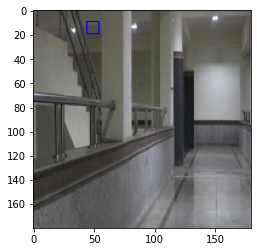

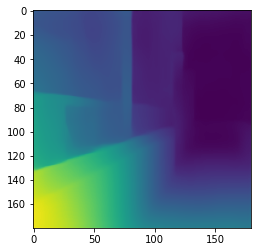

(66.42500371636086, 100.98632376987212)
208 (66.42500371636086, 100.98632376987212) turn right 0.5466666666666666 0.046186599999828104 0.4148054999998294 correct
(87.4812443643001, 34.52885482416929)
209 (87.4812443643001, 34.52885482416929) turn left 0.225 0.0983414999998331 0.7606276999999864 correct
(74.56784083496711, 30.186453576865524)
210 (74.56784083496711, 30.186453576865524) turn left 0.14333333333333334 0.09790469999984452 0.5532424000000447 correct
(85.96064638784003, 35.57404942966073)
211 (85.96064638784003, 35.57404942966073) turn left 0.225 0.09429470000009132 0.595872399999962 correct
(60.645079766222125, 42.733375454109115)
212 (60.645079766222125, 42.733375454109115) turn left 0.23416666666666666 0.09267290000002504 0.44673139999986233 correct
(66.82081492390674, 29.147766323023696)
213 (66.82081492390674, 29.147766323023696) turn left 0.14333333333333334 0.09249419999991915 0.508395599999858 correct
(34.75933806146682, 14.636406619385832)
(55.60066384342507, 89.4102

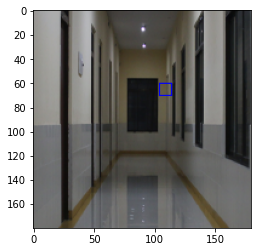

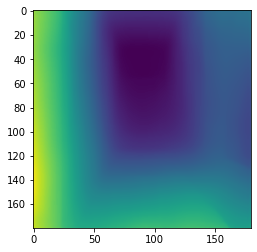

(64.50842406876866, 31.982578796562095)
218 (64.50842406876866, 31.982578796562095) turn left 0.1575 0.0950534000000971 0.5327589999999418 correct
(72.19109746739097, 38.773087746230935)
219 (72.19109746739097, 38.773087746230935) turn left 0.1825 0.09288059999994402 0.783056199999919 correct
(67.93842887472663, 95.31864826608914)
220 (67.93842887472663, 95.31864826608914) turn right 0.4975 0.09221649999994952 0.42270379999990837 wrong


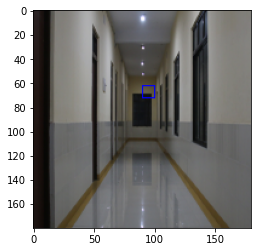

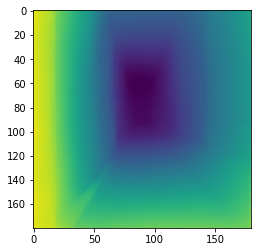

(56.33049535603928, 156.88235294118218)
(66.57688338492501, 24.92432060543208)
221 (66.57688338492501, 24.92432060543208) turn left 0.1375 0.09137839999993957 0.5268427999999403 correct
(72.18551686014614, 148.0396904367093)
222 (72.18551686014614, 148.0396904367093) turn right 0.8025 0.046450800000002346 0.5163236000000779 correct
(65.88214783821833, 80.33901175533458)
223 (65.88214783821833, 80.33901175533458) turn left 0.4841666666666667 0.04595150000000103 0.5312934000000951 correct
(66.19185832000913, 88.83913417783674)
224 (66.19185832000913, 88.83913417783674) turn left 0.4975 0.0979671000000053 0.5161195999999109 correct
(63.91402057245205, 34.970594812165494)
225 (63.91402057245205, 34.970594812165494) turn left 0.23416666666666666 0.09422799999993003 0.5485861999998178 correct
(67.24411055463322, 140.8262845483332)
226 (67.24411055463322, 140.8262845483332) turn right 0.8008333333333333 0.09355830000004062 0.7486450999999761 correct
(66.3061510719333, 35.19745541975781)
227 (

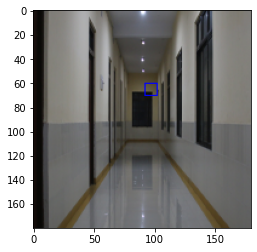

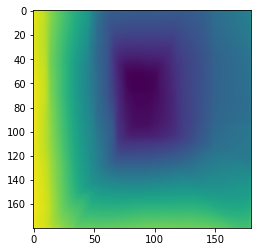

(87.20234869016228, 148.54706413732168)
249 (87.20234869016228, 148.54706413732168) turn right 0.7958333333333333 0.046409699999912846 0.5694028999998864 correct
(71.19811103432899, 135.8774475927318)
250 (71.19811103432899, 135.8774475927318) turn right 0.8008333333333333 0.04674169999998412 0.645636100000047 correct
(83.36421507332174, 139.17585540525306)
251 (83.36421507332174, 139.17585540525306) turn right 0.7958333333333333 0.0978735000001052 0.5382501000001412 correct
(67.00467821469076, 88.37678594006616)
252 (67.00467821469076, 88.37678594006616) turn left 0.4975 0.09780349999982718 0.5068083999999544 correct
(81.33148164222743, 86.92925961288945)
253 (81.33148164222743, 86.92925961288945) turn left 0.4841666666666667 0.09521640000002662 0.7720930000000408 correct
(60.97098715530876, 73.31698553849583)
(66.83161512027475, 175.46735395188963)
(44.916666666666664, 174.0833333333333)
254 (60.97098715530876, 73.31698553849583) turn left 0.5033333333333333 0.09343599999988328 0.633

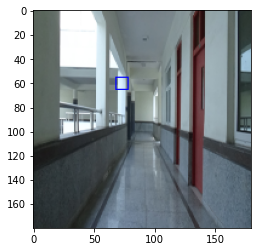

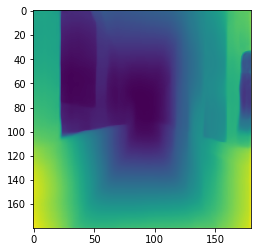

(78.04001576976601, 141.54928050464113)
255 (78.04001576976601, 141.54928050464113) turn right 0.7958333333333333 0.0915512999999919 0.580112999999983 correct
(0.0, 179.0)
(91.20808301475529, 148.237757145471)
256 (91.20808301475529, 148.237757145471) turn right 0.8275 0.09046340000008968 0.6082547000000886 correct
(0.0, 179.0)
(62.903531321874944, 148.35840887565132)
257 (62.903531321874944, 148.35840887565132) turn right 0.8025 0.09031449999997676 0.4824076999998397 correct
(64.97262112467811, 27.030331499126305)
258 (64.97262112467811, 27.030331499126305) turn left 0.175 0.046417399999882036 0.5818154999999479 correct
(66.70088175446617, 88.53719195116591)
259 (66.70088175446617, 88.53719195116591) turn left 0.49583333333333335 0.046533899999985806 0.49219719999996414 correct
(66.78216418666193, 35.45905456018029)
260 (66.78216418666193, 35.45905456018029) turn left 0.20833333333333334 0.09810520000019096 0.5791659000001346 correct
(87.6281677704289, 31.185342163358595)
261 (87.6281

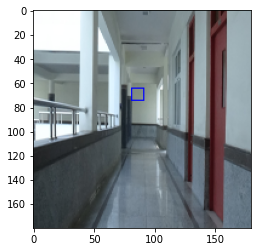

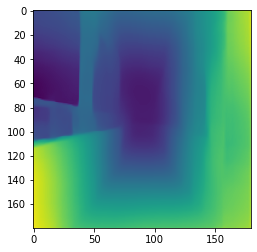

(60.14341421143353, 152.35831889080183)
267 (60.14341421143353, 152.35831889080183) turn right 0.8008333333333333 0.09290539999983594 0.4687573999999586 correct
(76.05930689532029, 26.700011909015107)
268 (76.05930689532029, 26.700011909015107) turn left 0.1675 0.09154249999983222 0.5192721999999321 correct
(71.95687839485865, 148.700809222928)
269 (71.95687839485865, 148.700809222928) turn right 0.8683333333333333 0.09043449999990116 0.5402027000000089 correct
(81.8964559493414, 151.53716253749937)
270 (81.8964559493414, 151.53716253749937) turn right 0.8708333333333333 0.09046910000006392 0.6771866999999929 correct
(66.13052847614493, 86.47593637763384)
271 (66.13052847614493, 86.47593637763384) turn left 0.4816666666666667 0.04549840000004224 0.523149900000135 correct
(74.87894328819777, 90.69473433119177)
272 (74.87894328819777, 90.69473433119177) turn right 0.49083333333333334 0.04583079999997608 0.7712867000000188 wrong


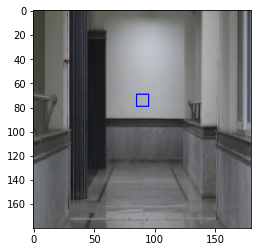

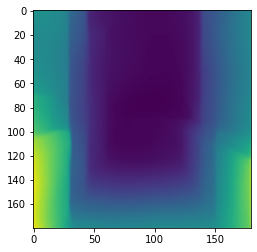

(67.9425273240812, 28.697531622251876)
273 (67.9425273240812, 28.697531622251876) turn left 0.14333333333333334 0.0980855000000247 0.5182147000000441 correct
(86.79835022858859, 27.59282448817517)
274 (86.79835022858859, 27.59282448817517) turn left 0.1675 0.09548829999994268 0.5792630000000827 correct
(69.77543975011365, 84.26286371854893)
275 (69.77543975011365, 84.26286371854893) turn left 0.4841666666666667 0.09506620000001931 0.5763409000001047 correct
(81.05004112969114, 75.53797641897013)
276 (81.05004112969114, 75.53797641897013) turn left 0.455 0.0933986999998524 0.4835505999999441 correct
(75.42383612662826, 144.0194909993761)
277 (75.42383612662826, 144.0194909993761) turn right 0.8 0.09153009999999995 0.5078538999998727 correct
(71.14169915863276, 146.41781243587863)
278 (71.14169915863276, 146.41781243587863) turn right 0.8683333333333333 0.09073880000005374 0.5661344000000099 correct
(74.5664062500021, 105.4765625000023)
279 (74.5664062500021, 105.4765625000023) turn righ

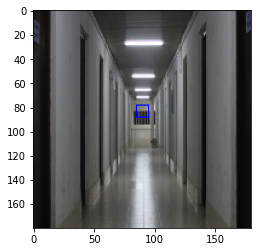

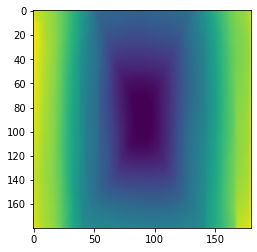

(57.32326152956006, 89.42663004191807)
284 (57.32326152956006, 89.42663004191807) turn left 0.4975 0.09256009999990056 0.46789570000009917 correct
(73.91181494661843, 133.1054804270469)
285 (73.91181494661843, 133.1054804270469) turn right 0.8008333333333333 0.09105589999990116 0.7160627999999178 correct
(74.15291644771753, 87.39674198634115)
286 (74.15291644771753, 87.39674198634115) turn left 0.4875 0.09041260000003604 0.6943025000000489 correct
(75.18361355752015, 142.67760875368344)
287 (75.18361355752015, 142.67760875368344) turn right 0.7916666666666666 0.09031210000011924 0.617278400000032 correct
(73.86509562840658, 87.69228142075423)
288 (73.86509562840658, 87.69228142075423) turn left 0.495 0.09294650000015281 0.43167300000004616 correct
(75.71068291300097, 89.78605837346994)
289 (75.71068291300097, 89.78605837346994) turn left 0.4875 0.09520999999995183 0.4739108999999644 correct
(64.28568016242656, 32.86050400095547)
290 (64.28568016242656, 32.86050400095547) turn left 0.17

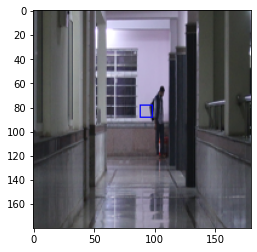

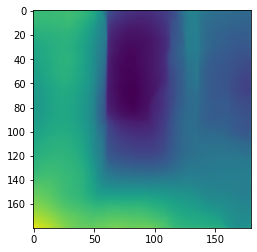

(88.52464163822222, 138.72737201364737)
5 (88.52464163822222, 138.72737201364737) turn right 0.8033333333333333 0.09145890000013424 0.8787827000001016 correct
(73.73260788691097, 87.16927083334065)
6 (73.73260788691097, 87.16927083334065) turn left 0.495 0.09045799999989868 0.6009956999998849 correct
(67.74593271205798, 91.63117990839741)
7 (67.74593271205798, 91.63117990839741) turn right 0.4766666666666667 0.045977899999797955 0.6261936999999307 wrong


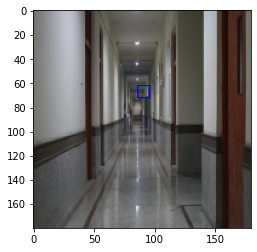

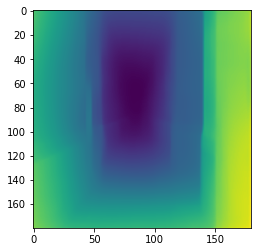

(79.39252255379051, 34.73447258848393)
8 (79.39252255379051, 34.73447258848393) turn left 0.1575 0.045970199999828765 0.5881894999999986 correct
(83.74092705711915, 46.663432746429564)
9 (83.74092705711915, 46.663432746429564) turn left 0.1975 0.09813170000006721 0.9598652000001948 correct
(85.26832451741107, 138.13478051796005)
10 (85.26832451741107, 138.13478051796005) turn right 0.7916666666666666 0.09765310000011596 0.7395286000000851 correct
(81.77676434438673, 132.79649395173223)
11 (81.77676434438673, 132.79649395173223) turn right 0.7225 0.0951978999999028 0.7720659999999953 correct
(71.44823476833793, 74.9038681165672)
12 (71.44823476833793, 74.9038681165672) turn left 0.49083333333333334 0.09508690000006936 1.07349279999994 correct
(73.54572713643545, 88.83118440780092)
13 (73.54572713643545, 88.83118440780092) turn left 0.49583333333333335 0.09280349999994542 0.6950193000000127 correct
(75.44686440678835, 85.21008474577204)
14 (75.44686440678835, 85.21008474577204) turn left

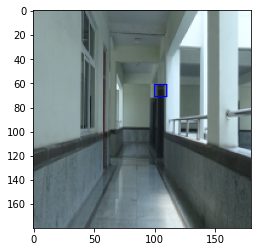

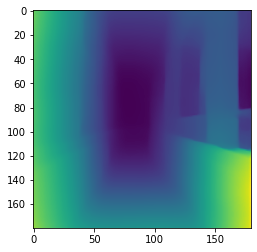

(64.11723486340317, 130.3061963625054)
(0.0, 179.0)
(61.62409420289944, 19.037137681159717)
44 (64.11723486340317, 130.3061963625054) turn right 0.7758333333333334 0.09048099999995429 0.9300597999999809 correct
(80.84487881157895, 140.23072713058525)
45 (80.84487881157895, 140.23072713058525) turn right 0.8033333333333333 0.046101200000066456 0.6295658999999887 correct
(72.24670392662648, 84.34393809114418)
46 (72.24670392662648, 84.34393809114418) turn left 0.48083333333333333 0.04617569999982152 0.6743769999998221 correct
(77.4616926503368, 41.77119524870282)
47 (77.4616926503368, 41.77119524870282) turn left 0.1975 0.09810299999980998 0.7033216999998331 correct
(70.65536645621499, 130.47385396650753)
48 (70.65536645621499, 130.47385396650753) turn right 0.7916666666666666 0.09709019999991142 0.8780067000000145 correct
(98.34239598841471, 92.80568831780306)
49 (98.34239598841471, 92.80568831780306) turn right 0.495 0.0943525000000136 0.6779214000000593 wrong


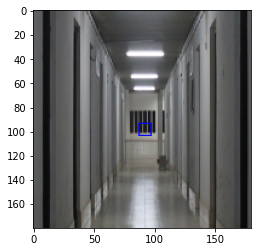

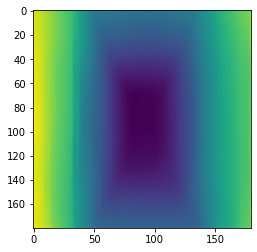

(72.02031063322187, 136.8906411788301)
50 (72.02031063322187, 136.8906411788301) turn right 0.8258333333333333 0.09259340000016891 0.6648978000000625 correct
(75.58058291866013, 147.37371788362756)
51 (75.58058291866013, 147.37371788362756) turn right 0.8283333333333334 0.0945168000000649 0.5721752000001743 correct
(71.40010487677307, 31.76067121132816)
(61.600657894738745, 139.01447368421475)
(53.78485181119764, 172.53018660812643)
52 (61.600657894738745, 139.01447368421475) turn right 0.1375 0.0980074000001423 0.7867945000000418 wrong


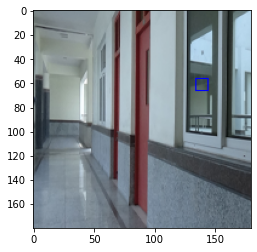

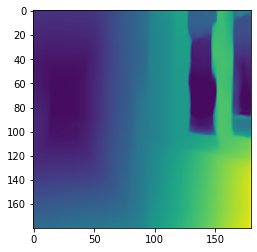

(64.08293325803004, 88.12858891086061)
53 (64.08293325803004, 88.12858891086061) turn left 0.4975 0.09485770000014782 0.6005751000000146 correct
(78.60269587195518, 35.8390901432224)
54 (78.60269587195518, 35.8390901432224) turn left 0.15833333333333333 0.09633810000013909 0.6487493000001905 correct
(79.52970953355327, 80.75979269614302)
55 (79.52970953355327, 80.75979269614302) turn left 0.48083333333333333 0.09790310000016689 0.9563585000000785 correct
(76.31845464537119, 37.2894581114254)
56 (76.31845464537119, 37.2894581114254) turn left 0.1575 0.09832310000001598 0.6459867000000941 correct
(96.35059695349096, 35.81630300535637)
57 (96.35059695349096, 35.81630300535637) turn left 0.15416666666666667 0.09497319999991305 0.6517696999999316 correct
(86.31747534517771, 144.01956607496672)
58 (86.31747534517771, 144.01956607496672) turn right 0.8275 0.09298819999980878 0.6705387999998038 correct
(87.9323215115464, 35.41164627536334)
59 (87.9323215115464, 35.41164627536334) turn left 0.1

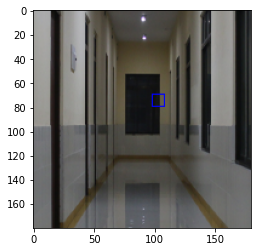

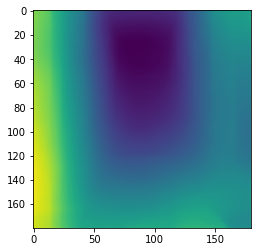

(77.20623392344204, 41.55560599183216)
62 (77.20623392344204, 41.55560599183216) turn left 0.2808333333333333 0.045651300000145056 0.6424341000001732 correct
(73.66611510791385, 134.44165467626127)
(41.879476975555704, 11.09550881182525)
63 (73.66611510791385, 134.44165467626127) turn right 0.8258333333333333 0.09807729999988624 0.9228235999999015 correct
(72.16185807653922, 110.70901027073722)
64 (72.16185807653922, 110.70901027073722) turn right 0.7183333333333334 0.09791819999986728 0.9889963999999054 correct
(83.82511684004693, 38.508668777327856)
65 (83.82511684004693, 38.508668777327856) turn left 0.14333333333333334 0.09479669999996077 0.6964926999999079 correct
(82.98425735798025, 36.98516997490566)
66 (82.98425735798025, 36.98516997490566) turn left 0.195 0.0980339999998705 0.6947539999998753 correct
(0.3333333333333333, 39.33333333333333)
(68.00166362988918, 131.41337241544733)
(0.0, 179.0)
(2.0, 38.0)
(65.16240995416041, 47.36542239685793)
(70.1941544885182, 15.2025052192067

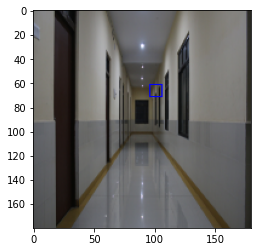

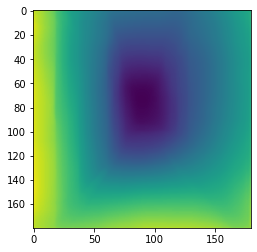

(72.60405224877772, 43.094775122459986)
88 (72.60405224877772, 43.094775122459986) turn left 0.20833333333333334 0.09845340000015312 0.7078589000000193 correct
(78.88913410358863, 46.8212384785111)
89 (78.88913410358863, 46.8212384785111) turn left 0.1875 0.09428810000008525 0.9130686000000878 correct
(73.37753904487391, 92.24564412747982)
90 (73.37753904487391, 92.24564412747982) turn right 0.4875 0.09834599999999227 0.6223039999999855 wrong


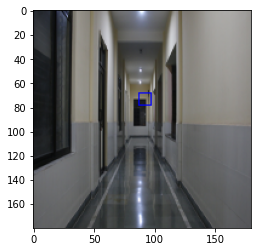

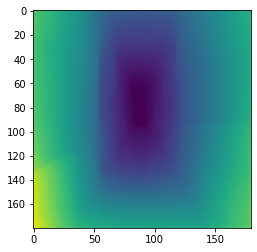

(90.90955903684626, 37.86843632143989)
91 (90.90955903684626, 37.86843632143989) turn left 0.1575 0.09446469999988949 0.7104127000000062 correct
(77.15431472080257, 130.11389593907293)
92 (77.15431472080257, 130.11389593907293) turn right 0.7758333333333334 0.09388570000010077 0.7820574000002125 correct
(82.13475788386215, 34.299414096160966)
93 (82.13475788386215, 34.299414096160966) turn left 0.15416666666666667 0.09224099999983082 0.7715587999998661 correct
(76.56844995177205, 87.95711211694372)
94 (76.56844995177205, 87.95711211694372) turn left 0.4875 0.0927004999998644 0.6968782999999803 correct
(62.10384041757787, 97.6321308724492)
95 (62.10384041757787, 97.6321308724492) turn right 0.8683333333333333 0.09088029999998071 0.9725606999998035 correct
(74.88159361070497, 143.99052748886834)
96 (74.88159361070497, 143.99052748886834) turn right 0.8283333333333334 0.09788350000007995 0.7431050000000141 correct
(68.2381168978861, 30.71810325221795)
(49.77799530148976, 163.9616288175470

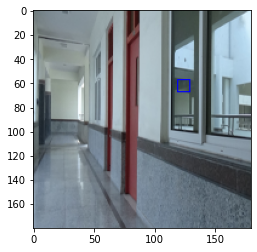

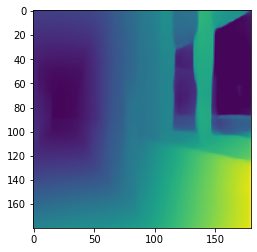

(84.00162498233665, 139.58690122933396)
98 (84.00162498233665, 139.58690122933396) turn right 0.7916666666666666 0.09777589999998781 0.7283598000001348 correct
(78.44565539739291, 41.89175563464018)
99 (78.44565539739291, 41.89175563464018) turn left 0.2808333333333333 0.09476979999999458 0.7025903999999628 correct
(81.42279101847525, 38.51452218561112)
100 (81.42279101847525, 38.51452218561112) turn left 0.20833333333333334 0.09242889999995896 0.8251973000001271 correct
(63.90019085318324, 75.4294903513109)
101 (63.90019085318324, 75.4294903513109) turn left 0.49583333333333335 0.09422989999984566 0.7272087999999712 correct
(86.83140308838617, 137.55138445153617)
102 (86.83140308838617, 137.55138445153617) turn right 0.8033333333333333 0.09812200000010307 0.7620366000001013 correct
(86.36109260493288, 140.23510252424973)
103 (86.36109260493288, 140.23510252424973) turn right 0.8258333333333333 0.09502760000009403 0.7010769000000892 correct
(68.31209686545337, 30.80027158538024)
(55.99

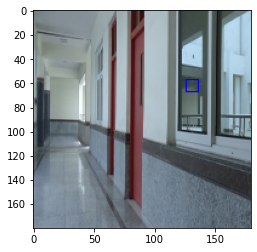

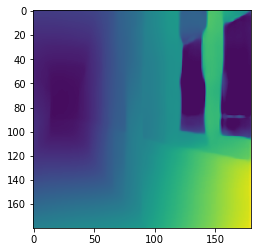

(85.76665580714554, 34.27113536407019)
105 (85.76665580714554, 34.27113536407019) turn left 0.1675 0.0978708000000097 0.6617453999999725 correct
(0.0, 179.0)
(79.96661994043222, 141.67995444192775)
106 (79.96661994043222, 141.67995444192775) turn right 0.805 0.09800939999990987 0.6320106999999098 correct
(69.54291044776565, 143.041928515328)
107 (69.54291044776565, 143.041928515328) turn right 0.8025 0.09721530000001621 0.5893682999999328 correct
(68.16017590785086, 79.71229088268383)
(0.0, 179.0)
108 (68.16017590785086, 79.71229088268383) turn left 0.48833333333333334 0.09728569999992942 1.1410126999999193 correct
(64.56635503362062, 106.4654543381394)
109 (64.56635503362062, 106.4654543381394) turn right 0.4708333333333333 0.09448680000014065 0.8400207000001956 wrong


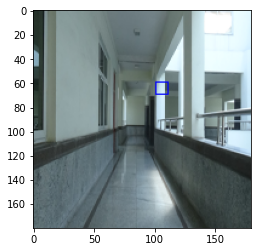

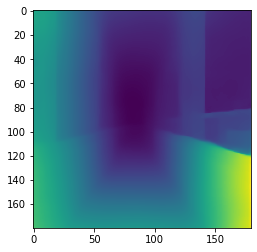

(75.97816065896328, 86.41192473362612)
110 (75.97816065896328, 86.41192473362612) turn left 0.4875 0.09257800000000316 0.6911731000000145 correct
(83.81539760516466, 141.0698495548169)
111 (83.81539760516466, 141.0698495548169) turn right 0.8025 0.09132030000000668 0.6783000000000357 correct
(0.0, 179.0)
(80.07250702248, 141.51544943821656)
112 (80.07250702248, 141.51544943821656) turn right 0.805 0.09028340000008939 0.761708100000078 correct
(73.78518390606894, 38.23225695044449)
113 (73.78518390606894, 38.23225695044449) turn left 0.1875 0.04575610000006236 0.5853262000000541 correct
(71.02801637634285, 85.38757325199737)
114 (71.02801637634285, 85.38757325199737) turn left 0.4841666666666667 0.046158399999967514 0.6207925000001069 correct
(67.11754606843168, 70.73532104840085)
115 (67.11754606843168, 70.73532104840085) turn left 0.5033333333333333 0.09787190000020018 0.8464045000000624 wrong


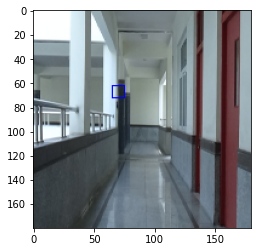

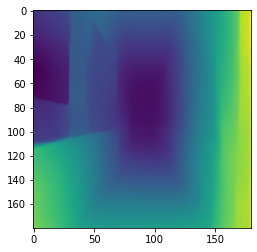

(68.48293696826902, 80.8278228924721)
116 (68.48293696826902, 80.8278228924721) turn left 0.49916666666666665 0.09812409999994998 1.0982817999999952 correct
(74.81650618981786, 133.0751719394735)
117 (74.81650618981786, 133.0751719394735) turn right 0.8008333333333333 0.09790930000008302 0.7450992999999926 correct
(83.22943047843755, 132.3483874992051)
118 (83.22943047843755, 132.3483874992051) turn right 0.7225 0.0979830999999649 0.7995571000001291 correct
(68.97701391818082, 102.20908899199092)
119 (68.97701391818082, 102.20908899199092) turn right 0.5466666666666666 0.09518049999996947 0.7032054999999673 correct
(66.54657214645233, 83.20450466619585)
120 (66.54657214645233, 83.20450466619585) turn left 0.48833333333333334 0.09330250000016349 0.6202786999999716 correct
(71.51617606853802, 36.096509614511724)
121 (71.51617606853802, 36.096509614511724) turn left 0.14333333333333334 0.09144250000008469 0.6100705999999718 correct
(88.51207865168429, 139.6996488764035)
122 (88.5120786516

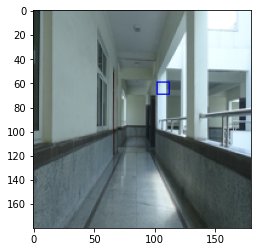

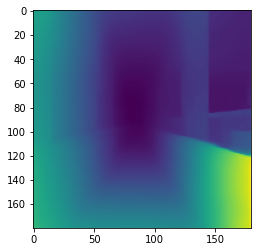

(79.7393246517309, 39.19995457298867)
137 (79.7393246517309, 39.19995457298867) turn left 0.20833333333333334 0.09450719999995272 0.6911786999999094 correct
(84.62707302880624, 140.73516147803693)
138 (84.62707302880624, 140.73516147803693) turn right 0.7958333333333333 0.09279209999999694 0.7059380999999121 correct
(68.19256929715648, 46.506838294450326)
139 (68.19256929715648, 46.506838294450326) turn left 0.20833333333333334 0.09105660000000171 0.8410160999999334 correct
(89.30792502074667, 132.6680507770575)
140 (89.30792502074667, 132.6680507770575) turn right 0.8 0.09267190000014125 0.8209833000000799 correct
(66.86932921950493, 108.31636384411124)
(0.0, 179.0)
141 (66.86932921950493, 108.31636384411124) turn right 0.4975 0.09790619999989758 0.849091099999896 wrong


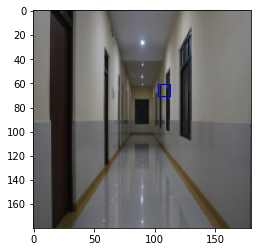

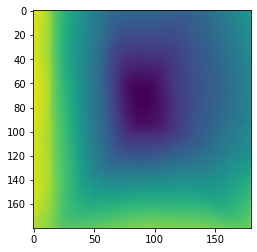

(76.78263689429035, 144.6443991476083)
142 (76.78263689429035, 144.6443991476083) turn right 0.8283333333333334 0.09621600000014041 0.7439008000001195 correct
(84.09514220992679, 34.280560449706236)
143 (84.09514220992679, 34.280560449706236) turn left 0.175 0.09441479999986768 0.6437959999998384 correct
(85.81195371681689, 34.01290268875792)
144 (85.81195371681689, 34.01290268875792) turn left 0.175 0.09282650000000103 0.6496010999999271 correct
(71.68323442136796, 102.79800763035607)
145 (71.68323442136796, 102.79800763035607) turn right 0.5466666666666666 0.09126600000013241 0.5571804000001066 correct
(66.30726635081771, 105.0708176951812)
146 (66.30726635081771, 105.0708176951812) turn right 0.4708333333333333 0.09044340000014017 0.9312996000001021 wrong


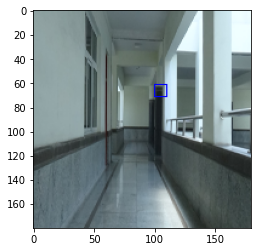

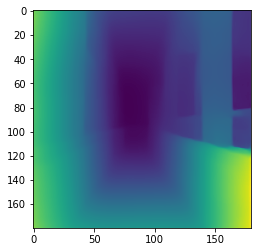

(83.79912002308255, 140.2473312175442)
147 (83.79912002308255, 140.2473312175442) turn right 0.7958333333333333 0.09789169999999103 0.7178576999999677 correct
(72.33645301569888, 34.38684061259499)
148 (72.33645301569888, 34.38684061259499) turn left 0.195 0.09382929999992484 0.5993271999998342 correct
(88.944039833536, 36.95399821641082)
149 (88.944039833536, 36.95399821641082) turn left 0.20833333333333334 0.09221690000003946 0.6936385999999857 correct
(90.3038268736879, 44.993275461541906)
150 (90.3038268736879, 44.993275461541906) turn left 0.225 0.09081579999997302 0.9343125999998847 correct
(71.14677669628864, 46.24425165749735)
151 (71.14677669628864, 46.24425165749735) turn left 0.2808333333333333 0.046376200000167955 0.6790910000001986 correct
(85.46539348884015, 43.11561138169291)
152 (85.46539348884015, 43.11561138169291) turn left 0.15416666666666667 0.07264370000007148 0.7574403000000984 correct
(73.88176761432892, 129.23714462297525)
(50.50000000000001, 1.0)
153 (73.88176

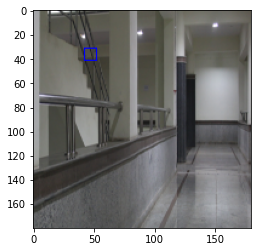

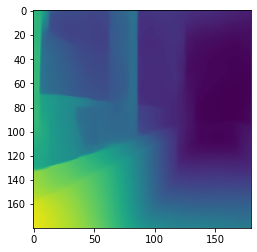

(79.38147178592324, 137.2200407213534)
156 (79.38147178592324, 137.2200407213534) turn right 0.8008333333333333 0.0976900000000569 0.8553205999999136 correct
(87.34068164322076, 139.68864161242746)
157 (87.34068164322076, 139.68864161242746) turn right 0.8 0.09496280000007573 0.7314703000001828 correct
(69.88850116318507, 39.58009305417545)
158 (69.88850116318507, 39.58009305417545) turn left 0.17416666666666666 0.09301269999991746 0.6484662000000299 correct
(78.60044515102435, 89.31847376787626)
159 (78.60044515102435, 89.31847376787626) turn left 0.49583333333333335 0.0928068999999141 0.9160356999998385 correct
(65.42425283408394, 87.81080384748465)
160 (65.42425283408394, 87.81080384748465) turn left 0.4766666666666667 0.09798799999998664 0.638753799999904 correct
(69.30943304404953, 82.628761456738)
161 (69.30943304404953, 82.628761456738) turn left 0.4841666666666667 0.09503670000003694 0.6643790999999055 correct
(73.52240307242789, 84.48070592539152)
162 (73.52240307242789, 84.48

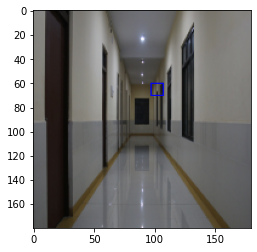

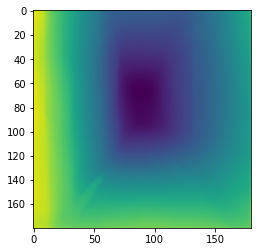

(75.07407908076594, 45.67881040891986)
169 (75.07407908076594, 45.67881040891986) turn left 0.1975 0.09422109999991335 0.7492358999998032 correct
(90.41533976228368, 142.3090379008823)
170 (90.41533976228368, 142.3090379008823) turn right 0.8275 0.09763400000019828 0.7025460000002113 correct
(70.95106200887535, 43.57963121450678)
171 (70.95106200887535, 43.57963121450678) turn left 0.23416666666666666 0.09548580000000584 0.8190443999999388 correct
(78.23695023589002, 39.7261451833844)
172 (78.23695023589002, 39.7261451833844) turn left 0.16 0.09436269999991964 0.6889443999998548 correct
(88.36950146626623, 43.10620935865946)
173 (88.36950146626623, 43.10620935865946) turn left 0.21833333333333332 0.09244639999997162 0.7767813000000388 correct
(70.53438917391877, 133.71826901629052)
174 (70.53438917391877, 133.71826901629052) turn right 0.7916666666666666 0.09260020000010627 0.6994450000001962 correct
(65.2836905733173, 128.2119706296874)
(0.0, 179.0)
175 (65.2836905733173, 128.21197062

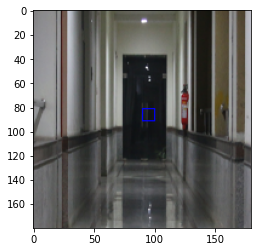

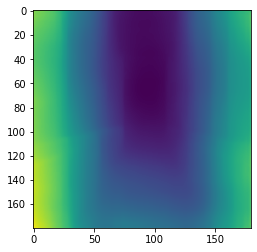

(79.2448749294782, 31.83063757758403)
(79.76923076923077, 71.53846153846153)
182 (79.76923076923077, 71.53846153846153) turn left 0.175 0.09789410000007592 0.6052979999999479 correct
(64.52660522035958, 92.10146386802809)
183 (64.52660522035958, 92.10146386802809) turn right 0.48083333333333333 0.09809060000020509 0.6872874000000593 wrong


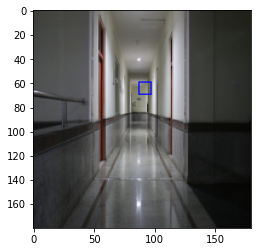

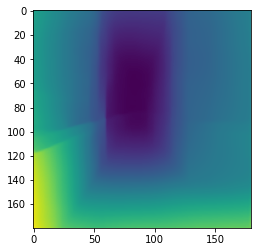

(70.71130934912739, 121.55584247899692)
184 (70.71130934912739, 121.55584247899692) turn right 0.7183333333333334 0.09471290000010413 0.8271608000000015 correct
(66.25397861748901, 80.58059250796663)
185 (66.25397861748901, 80.58059250796663) turn left 0.48833333333333334 0.09256669999990663 0.7988107999999556 correct
(87.90680111747935, 115.5295093416709)
186 (87.90680111747935, 115.5295093416709) turn right 0.7758333333333334 0.0913420000001679 1.0343582000000424 correct
(70.05900133696282, 106.75515898387879)
187 (70.05900133696282, 106.75515898387879) turn right 0.4975 0.09030039999993278 0.8330038999999942 wrong


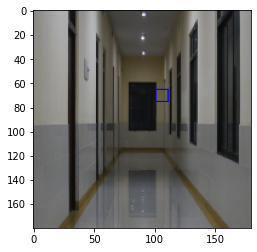

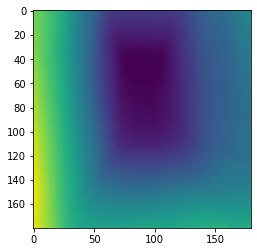

(84.63196340294014, 37.5483656754977)
188 (84.63196340294014, 37.5483656754977) turn left 0.23416666666666666 0.045824300000049334 0.7953610000001845 correct
(81.10685960762255, 82.08731042159282)
189 (81.10685960762255, 82.08731042159282) turn left 0.455 0.09770129999992605 0.7435586999999941 correct
(82.24646120767676, 32.02974377352043)
190 (82.24646120767676, 32.02974377352043) turn left 0.1675 0.0979331999999431 0.6206990000000587 correct
(92.64741913797526, 142.13027564055471)
191 (92.64741913797526, 142.13027564055471) turn right 0.8708333333333333 0.09447150000005422 0.8375759000000471 correct
(68.4332861857578, 125.93129925236795)
192 (68.4332861857578, 125.93129925236795) turn right 0.7183333333333334 0.09255089999987831 0.7505629999998291 correct
(73.61141524736803, 103.5530210867861)
193 (73.61141524736803, 103.5530210867861) turn right 0.5466666666666666 0.09118260000013834 0.5712559000000965 correct
(66.50929496401642, 108.85640287767802)
194 (66.50929496401642, 108.85640

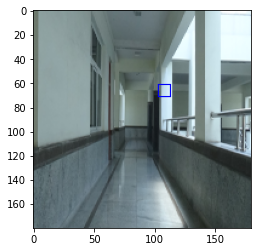

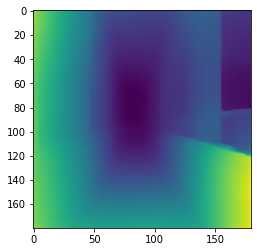

(79.71809551416831, 42.16160591347288)
195 (79.71809551416831, 42.16160591347288) turn left 0.16 0.09066100000018196 0.8471518000001197 correct
(78.26939188213267, 136.6459627329218)
196 (78.26939188213267, 136.6459627329218) turn right 0.8008333333333333 0.045880800000077215 0.6713105000001178 correct
(79.6662908681015, 146.0586245772387)
197 (79.6662908681015, 146.0586245772387) turn right 0.8708333333333333 0.045873000000028696 0.5523301999999148 correct
(70.51417033244422, 45.8431528088275)
198 (70.51417033244422, 45.8431528088275) turn left 0.20833333333333334 0.09805449999998928 0.7217023000000609 correct
(68.98921385604982, 101.91557768098404)
199 (68.98921385604982, 101.91557768098404) turn right 0.5466666666666666 0.09714439999993374 0.7058766000000105 correct
(65.88448460988417, 40.48917322835032)
200 (65.88448460988417, 40.48917322835032) turn left 0.23416666666666666 0.0945771000001514 0.621163900000056 correct
(65.56567890314615, 98.47695709863831)
201 (65.56567890314615, 

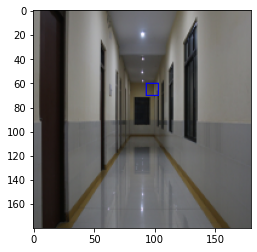

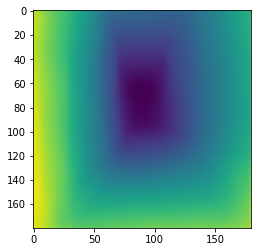

(85.38831149269974, 142.28438017774658)
202 (85.38831149269974, 142.28438017774658) turn right 0.7958333333333333 0.09225790000004963 0.6935402000001432 correct
(82.0750289208492, 35.93381259296415)
203 (82.0750289208492, 35.93381259296415) turn left 0.1575 0.09125069999981861 0.7915332999998554 correct
(85.6042884989887, 91.48956302790168)
(0.0, 179.0)
204 (85.6042884989887, 91.48956302790168) turn right 0.49083333333333334 0.0908375999999862 1.0955865999999332 wrong


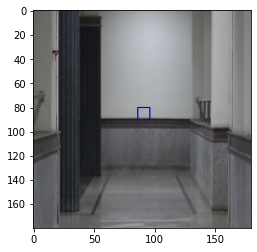

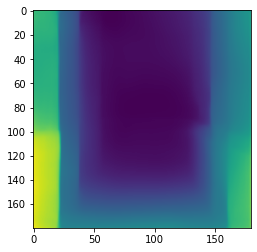

(56.919837398366724, 26.913170731703733)
(66.9746895142335, 135.39718597706243)
205 (66.9746895142335, 135.39718597706243) turn right 0.82 0.046534000000065134 0.8484075999999732 correct
(70.52530138413715, 84.4592945378815)
206 (70.52530138413715, 84.4592945378815) turn left 0.4816666666666667 0.09782499999982974 0.8460370000000239 correct
(68.00074637307027, 108.57825255395879)
207 (68.00074637307027, 108.57825255395879) turn right 0.8383333333333334 0.09817820000012034 0.9887962000000243 correct
(71.01959970963723, 102.82329150679736)
208 (71.01959970963723, 102.82329150679736) turn right 0.5466666666666666 0.09775519999993776 0.5702936999998656 correct
(92.43436463339894, 40.71721616681155)
209 (92.43436463339894, 40.71721616681155) turn left 0.225 0.09499669999991056 0.7491962999999942 correct
(80.74074967825962, 37.41803410553889)
210 (80.74074967825962, 37.41803410553889) turn left 0.14333333333333334 0.09344910000004347 0.7990828000001784 correct
(91.2988842019283, 40.435841611

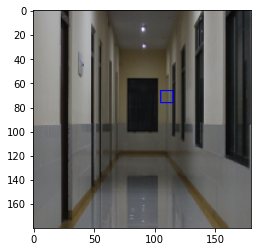

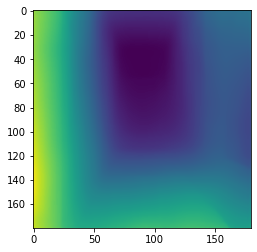

(72.10783142809207, 38.84448046408889)
218 (72.10783142809207, 38.84448046408889) turn left 0.1575 0.09795699999995122 0.643972500000018 correct
(80.83465222823568, 43.13695682354478)
219 (80.83465222823568, 43.13695682354478) turn left 0.1825 0.09516329999996742 0.7371021999999812 correct
(62.652365339582936, 98.78501170960988)
220 (62.652365339582936, 98.78501170960988) turn right 0.4975 0.09317780000014864 0.6030410000000757 wrong


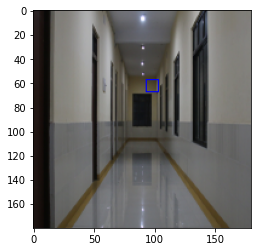

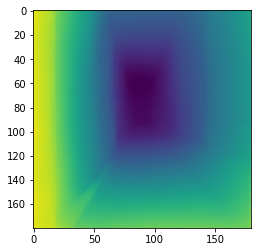

(67.57554880896828, 30.37599252685683)
(57.1919493104754, 156.83078643310284)
(47.18181818181807, 118.978056426332)
(66.5, 120.0)
(77.4054054054053, 115.37837837837826)
(83.6, 117.19999999999999)
221 (77.4054054054053, 115.37837837837826) turn right 0.1375 0.09798959999989165 0.641106900000068 wrong


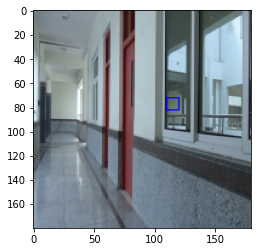

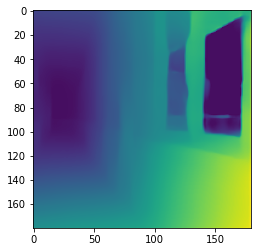

(80.01832942752826, 142.44476062941027)
222 (80.01832942752826, 142.44476062941027) turn right 0.8025 0.0942968000001656 0.6486283000001549 correct
(72.81764051194867, 66.21981079575616)
223 (72.81764051194867, 66.21981079575616) turn left 0.4841666666666667 0.09243590000005497 0.8586705000000165 correct
(72.41624908130697, 94.3589229638482)
224 (72.41624908130697, 94.3589229638482) turn right 0.4975 0.09100109999985762 0.8887829000000238 wrong


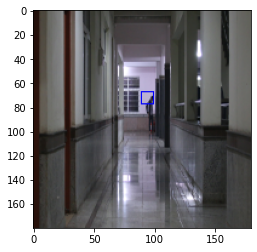

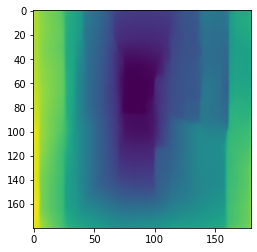

(70.60867450345334, 41.96157276044296)
225 (70.60867450345334, 41.96157276044296) turn left 0.23416666666666666 0.09040150000009817 0.6586601000001338 correct
(73.41935935095631, 132.8692124772681)
226 (73.41935935095631, 132.8692124772681) turn right 0.8008333333333333 0.04573110000001179 0.6889905999998973 correct
(74.75121771217916, 43.006494464946364)
227 (74.75121771217916, 43.006494464946364) turn left 0.23416666666666666 0.04639600000018618 0.6598329000000831 correct
(73.44555647528361, 42.07931371811514)
(38.15909923104648, 143.85426583667368)
(93.88045738045953, 136.54885654885965)
228 (93.88045738045953, 136.54885654885965) turn right 0.1275 0.09798580000006041 1.0659312000000227 wrong


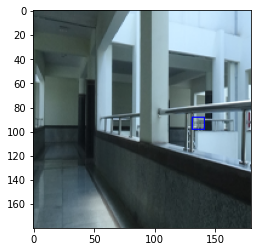

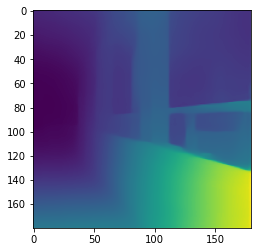

(90.46999933699591, 41.45236358814301)
229 (90.46999933699591, 41.45236358814301) turn left 0.225 0.09775460000014391 0.7622893000000204 correct
(74.45235061363508, 47.987190664607475)
230 (74.45235061363508, 47.987190664607475) turn left 0.2808333333333333 0.0979935000000296 0.9014950999999201 correct
(67.34101867275116, 41.88831419304363)
231 (67.34101867275116, 41.88831419304363) turn left 0.23416666666666666 0.0954040999999961 0.6290041999998266 correct
(66.75961086883149, 69.34491781281068)
232 (66.75961086883149, 69.34491781281068) turn left 0.47333333333333333 0.09437670000011167 0.7510547000001679 correct
(75.5693879061527, 42.37110502553654)
233 (75.5693879061527, 42.37110502553654) turn left 0.1975 0.09249469999986104 0.7025671999999759 correct
(89.46578610993822, 142.70115040478788)
234 (89.46578610993822, 142.70115040478788) turn right 0.805 0.09117289999994682 0.6373951999999008 correct
(67.09603392365162, 79.2303816412832)
235 (67.09603392365162, 79.2303816412832) turn le

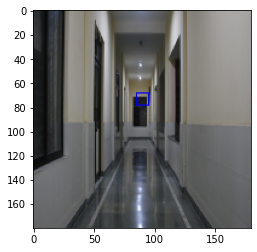

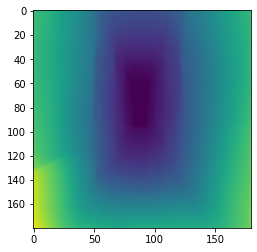

(64.68527118199137, 83.65223867520321)
238 (64.68527118199137, 83.65223867520321) turn left 0.48833333333333334 0.09487269999999626 0.6268646000000899 correct
(65.03275316456413, 91.8693037974791)
239 (65.03275316456413, 91.8693037974791) turn right 0.48083333333333333 0.09414609999998902 0.6728631999999379 wrong


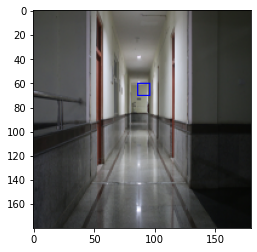

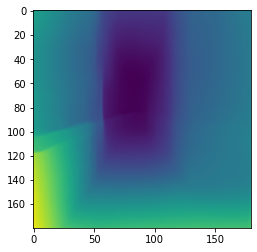

(62.145256087325976, 75.8185634684431)
240 (62.145256087325976, 75.8185634684431) turn left 0.48833333333333334 0.0939459999999599 0.6894741999999496 correct
(63.58549646034306, 90.51896895989248)
241 (63.58549646034306, 90.51896895989248) turn right 0.4975 0.097917999999936 0.7616792999999689 wrong


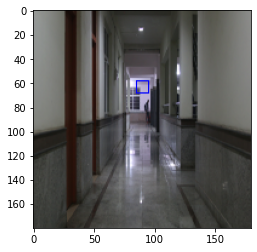

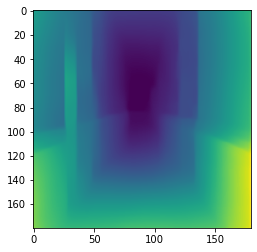

(70.09482116244973, 36.84249254843838)
242 (70.09482116244973, 36.84249254843838) turn left 0.1975 0.09480250000001433 0.6017910000000484 correct
(74.76446029399708, 36.522397147085734)
243 (74.76446029399708, 36.522397147085734) turn left 0.1575 0.09402070000010099 0.6327197000000524 correct
(65.19704990185127, 69.0485933503723)
244 (65.19704990185127, 69.0485933503723) turn left 0.49083333333333334 0.09218959999998333 0.8182520000000295 correct
(85.03075730163735, 145.000861549081)
245 (85.03075730163735, 145.000861549081) turn right 0.8708333333333333 0.090999199999942 0.7753093999999692 correct
(75.07929405916882, 136.61512967107353)
246 (75.07929405916882, 136.61512967107353) turn right 0.7958333333333333 0.0904957000000195 0.647019999999884 correct
(85.69241215411539, 48.92372545690177)
247 (85.69241215411539, 48.92372545690177) turn left 0.1275 0.09058030000005601 0.8458358000000317 correct
(61.70084156013014, 104.24672277068719)
248 (61.70084156013014, 104.24672277068719) turn 

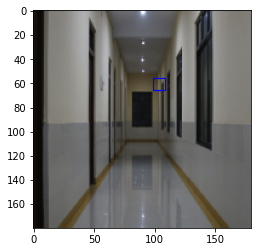

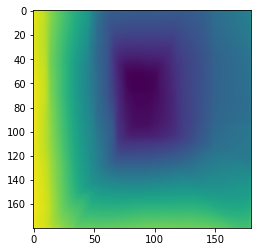

(86.8220037052874, 140.33361835542334)
249 (86.8220037052874, 140.33361835542334) turn right 0.7958333333333333 0.09779560000015408 0.8675041999999848 correct
(78.15898805951934, 123.26099994544839)
250 (78.15898805951934, 123.26099994544839) turn right 0.8008333333333333 0.09456159999990632 0.8746447999999418 correct
(82.34765326403361, 136.78321357591565)
251 (82.34765326403361, 136.78321357591565) turn right 0.7958333333333333 0.09249810000005709 0.6873298000000432 correct
(75.57969901720425, 88.77902334153062)
252 (75.57969901720425, 88.77902334153062) turn left 0.4975 0.09111619999998766 0.6857969999998659 correct
(82.82564701302978, 85.26529156125602)
253 (82.82564701302978, 85.26529156125602) turn left 0.4841666666666667 0.09041839999986223 0.8998414999998658 correct
(67.06939719689387, 80.30813716151503)
(65.19959677419399, 175.20766129032398)
254 (67.06939719689387, 80.30813716151503) turn left 0.5033333333333333 0.09794309999983852 0.7680006000000503 wrong


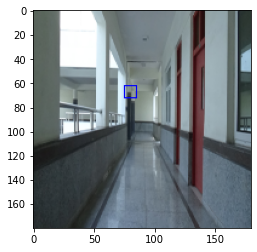

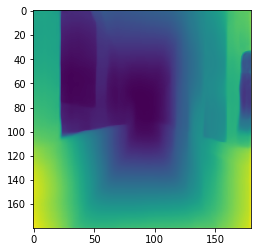

(85.1340916925172, 138.6814891416715)
255 (85.1340916925172, 138.6814891416715) turn right 0.7958333333333333 0.09798469999986992 0.739846999999827 correct
(89.80686502286386, 142.40957805591756)
256 (89.80686502286386, 142.40957805591756) turn right 0.8275 0.09571469999991677 0.840946699999904 correct
(69.20971892320286, 143.1843824228122)
257 (69.20971892320286, 143.1843824228122) turn right 0.8025 0.09359310000013465 0.5802906999999777 correct
(69.66603908912234, 37.419670073519875)
258 (69.66603908912234, 37.419670073519875) turn left 0.175 0.0934856999999738 0.6186307000000397 correct
(70.48538484136498, 85.890055816689)
259 (70.48538484136498, 85.890055816689) turn left 0.49583333333333335 0.09828340000012759 0.7140052000002015 correct
(75.35040218328065, 42.930910657857424)
260 (75.35040218328065, 42.930910657857424) turn left 0.20833333333333334 0.09525339999981952 0.7167733999999655 correct
(88.73223966767503, 38.98465113004264)
261 (88.73223966767503, 38.98465113004264) turn 

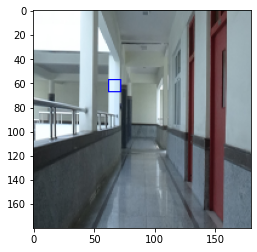

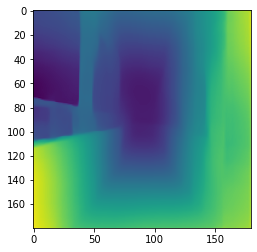

(75.65969257046079, 141.13680614860644)
267 (75.65969257046079, 141.13680614860644) turn right 0.8008333333333333 0.09782759999984592 0.6435675999998693 correct
(82.03163398693715, 33.3064052287617)
268 (82.03163398693715, 33.3064052287617) turn left 0.1675 0.09374759999991511 0.7709562000000005 correct
(74.12911075062866, 136.71147323404165)
269 (74.12911075062866, 136.71147323404165) turn right 0.8683333333333333 0.09234190000006492 0.7025264999999763 correct
(89.90858995138923, 144.88306320909425)
270 (89.90858995138923, 144.88306320909425) turn right 0.8708333333333333 0.09219970000003741 0.6621050999999625 correct
(71.49217861205825, 88.63993174061443)
271 (71.49217861205825, 88.63993174061443) turn left 0.4816666666666667 0.09083160000000134 0.7204552000000604 correct
(80.93929450366149, 94.49922523011872)
(0.0, 179.0)
272 (80.93929450366149, 94.49922523011872) turn right 0.49083333333333334 0.04631419999986974 1.094552799999974 wrong


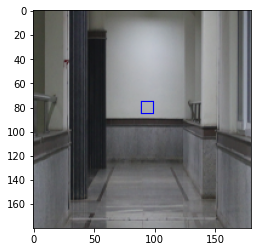

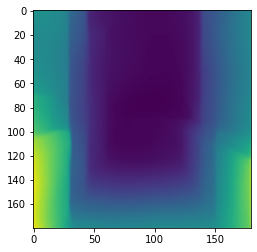

(74.22023105613337, 35.306376785230256)
273 (74.22023105613337, 35.306376785230256) turn left 0.14333333333333334 0.09784430000013344 0.6197004000000561 correct
(87.6020780456961, 34.593274111679186)
274 (87.6020780456961, 34.593274111679186) turn left 0.1675 0.09500309999998535 0.6709309000000303 correct
(66.89602502760967, 83.17694147957998)
275 (66.89602502760967, 83.17694147957998) turn left 0.4841666666666667 0.09443460000011328 0.6121951000000081 correct
(74.59402321914823, 73.45427834312773)
276 (74.59402321914823, 73.45427834312773) turn left 0.455 0.09255069999994703 0.8624629999999343 correct
(81.69184522892651, 140.5997379374254)
277 (81.69184522892651, 140.5997379374254) turn right 0.8 0.09309320000011212 0.6819441000000097 correct
(74.92452049123479, 134.43417966054602)
278 (74.92452049123479, 134.43417966054602) turn right 0.8683333333333333 0.09701660000018819 0.7389067999999952 correct
(79.59654579684897, 108.3400998608623)
279 (79.59654579684897, 108.3400998608623) tur

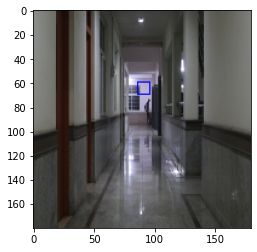

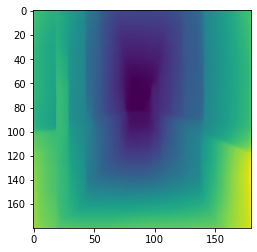

(82.38687518266914, 118.82251778228809)
285 (82.38687518266914, 118.82251778228809) turn right 0.8008333333333333 0.0969399999999041 0.9568663000000015 correct
(79.84662742709817, 88.26324335294888)
286 (79.84662742709817, 88.26324335294888) turn left 0.4875 0.0975449000000026 0.7532031999999163 correct
(83.54993026499089, 137.6795676429544)
287 (83.54993026499089, 137.6795676429544) turn right 0.7916666666666666 0.09501879999993434 0.8729475000000093 correct
(70.99040458997399, 87.1800375902718)
288 (70.99040458997399, 87.1800375902718) turn left 0.495 0.09796619999997347 0.5855917000001227 correct
(75.4311796581995, 92.35356398500437)
289 (75.4311796581995, 92.35356398500437) turn right 0.4875 0.09440479999989293 0.6440207999999075 wrong


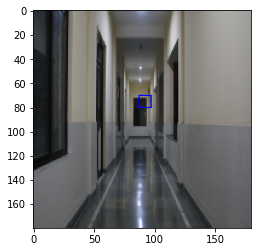

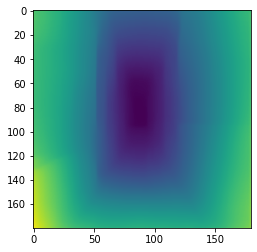

(68.41554168073641, 40.46810664867148)
290 (68.41554168073641, 40.46810664867148) turn left 0.17416666666666666 0.09427679999998873 0.6432443999999577 correct
(63.26263620386557, 72.72590509665991)
291 (63.26263620386557, 72.72590509665991) turn left 0.4891666666666667 0.09778019999998833 0.8741477999999461 correct
(41.7429130009785, 6.689149560117454)
(70.25198481187192, 128.49589230237822)
292 (70.25198481187192, 128.49589230237822) turn right 0.7183333333333334 0.09804840000015247 0.7770408000001225 correct
(86.88624028165138, 140.96846119994655)
293 (86.88624028165138, 140.96846119994655) turn right 0.8025 0.09790029999999206 0.7072032999999465 correct
(66.26420595532629, 121.73802729527014)
294 (66.26420595532629, 121.73802729527014) turn right 0.8258333333333333 0.09454689999984112 0.7958060999999361 correct
(72.92440295998063, 139.44500504542458)
(73.84074074074249, 66.08981481481642)
295 (73.84074074074249, 66.08981481481642) turn left 0.8258333333333333 0.09430160000010801 0.8

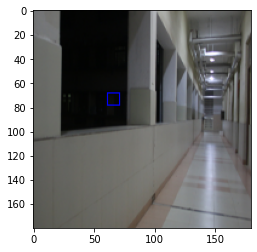

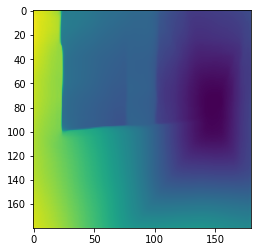

(71.68406049569207, 40.65777179507949)
296 (71.68406049569207, 40.65777179507949) turn left 0.17416666666666666 0.09286850000012237 0.6726215999999567 correct
(70.41955680040302, 40.91556141363029)
297 (70.41955680040302, 40.91556141363029) turn left 0.1575 0.09147329999996145 0.6513400999999703 correct
(64.33400209351586, 43.802599441735296)
298 (64.33400209351586, 43.802599441735296) turn left 0.23416666666666666 0.0914288999999826 0.6274492000000009 correct
(66.68413053196844, 81.80384443451806)
299 (66.68413053196844, 81.80384443451806) turn left 0.4891666666666667 0.09708579999983158 0.7627901999999267 correct
(79.54892326094762, 83.34062553406363)
300 (79.54892326094762, 83.34062553406363) turn left 0.4816666666666667 0.09570869999993192 1.0541944999999942 correct
theta_AOI:  300
theta_y:  0
Number of Frames:  300
Predicted count:  300
Unable to Predict count:  0
Correct Decision count:  262
Average Inference Time(s) 0.7457962953333299
Mean Squared Error:  0.01138829168565375
Mea

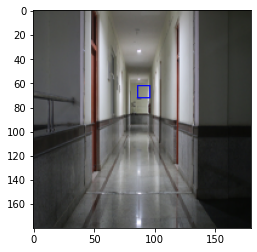

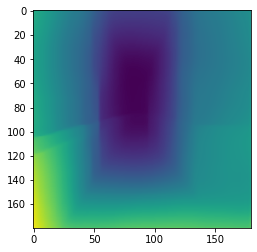

(59.43349533820911, 85.66102955760147)
(0.0, 179.0)
16 (59.43349533820911, 85.66102955760147) turn left 0.47333333333333333 0.09814970000002177 0.9437331999999969 correct
(72.02193784274775, 99.9492992077574)
17 (72.02193784274775, 99.9492992077574) turn right 0.82 0.0949247999999443 1.0981567999999697 correct
(65.94327850253889, 71.20657969368969)
18 (65.94327850253889, 71.20657969368969) turn left 0.4891666666666667 0.09794749999991836 0.99271490000001 correct
(90.33292145694581, 51.222090899310366)
19 (90.33292145694581, 51.222090899310366) turn left 0.21833333333333332 0.09519329999989168 0.8844280999999228 correct
(69.45723708318194, 106.20029314767623)
20 (69.45723708318194, 106.20029314767623) turn right 0.5466666666666666 0.09772399999997106 0.7100480999999945 correct
(84.37382268942012, 46.216625144309035)
21 (84.37382268942012, 46.216625144309035) turn left 0.16 0.09530470000004243 0.944643699999915 correct
(86.04341486046972, 41.78511301119897)
22 (86.04341486046972, 41.7851

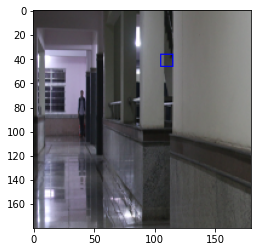

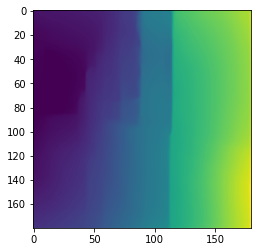

(89.08693492298929, 44.24894436164395)
26 (89.08693492298929, 44.24894436164395) turn left 0.1675 0.09797589999993761 0.7977574999999888 correct
(79.2850038481897, 49.57936179029427)
27 (79.2850038481897, 49.57936179029427) turn left 0.20833333333333334 0.0977012000000741 0.9654639000000316 correct
(82.23288623941905, 91.36413313459758)
28 (82.23288623941905, 91.36413313459758) turn right 0.48083333333333333 0.09648010000000795 0.9432696000001215 wrong


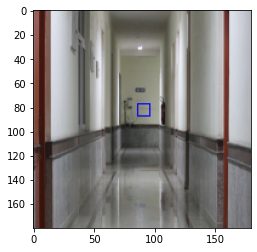

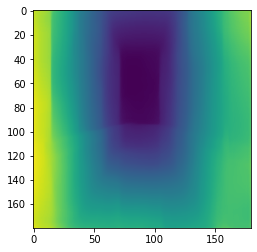

(80.8311330744782, 106.0607836216013)
29 (80.8311330744782, 106.0607836216013) turn right 0.5466666666666666 0.09387720000017907 0.723839800000178 correct
(84.9566398441665, 54.20316744399037)
30 (84.9566398441665, 54.20316744399037) turn left 0.1975 0.09340380000003279 1.0451207000000977 correct
(72.86845790754788, 70.83899579851811)
31 (72.86845790754788, 70.83899579851811) turn left 0.49083333333333334 0.0979466000001139 0.9137015999999676 correct
(83.562831762519, 71.944805546511)
32 (83.562831762519, 71.944805546511) turn left 0.455 0.09799390000011954 1.0260723999999755 correct
(73.03124703648618, 112.0069227121491)
(59.49999999999994, 16.999999999999982)
33 (73.03124703648618, 112.0069227121491) turn right 0.8258333333333333 0.09496119999994335 0.974782199999936 correct
(80.80227568269761, 87.40578673601314)
34 (80.80227568269761, 87.40578673601314) turn left 0.495 0.09321840000006887 0.7735568000000512 correct
(72.51396352077845, 103.02618633164954)
35 (72.51396352077845, 103.0

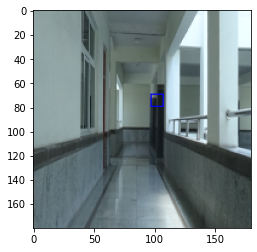

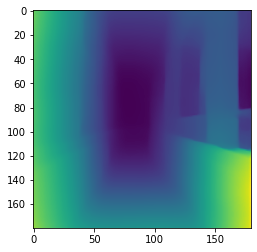

(50.81242727483964, 20.152897370257133)
(69.9107372119693, 129.25062504222703)
44 (69.9107372119693, 129.25062504222703) turn right 0.7758333333333334 0.09162049999986266 1.03344919999995 correct
(86.43233924141198, 132.82850402272612)
45 (86.43233924141198, 132.82850402272612) turn right 0.8033333333333333 0.0904054999998607 0.8042527000000064 correct
(79.93720866463701, 84.7734576363941)
46 (79.93720866463701, 84.7734576363941) turn left 0.48083333333333333 0.04618010000012873 0.8215007999999671 correct
(84.57675633943492, 47.59486905397427)
47 (84.57675633943492, 47.59486905397427) turn left 0.1975 0.06246699999996963 0.9248033000001215 correct
(76.42962857546985, 111.57805606940926)
48 (76.42962857546985, 111.57805606940926) turn right 0.7916666666666666 0.09826060000000325 0.975026600000092 correct
(91.32644191235339, 92.39927170208661)
49 (91.32644191235339, 92.39927170208661) turn right 0.495 0.09497600000008788 0.8269103000000086 wrong


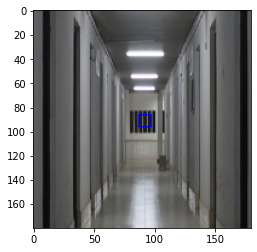

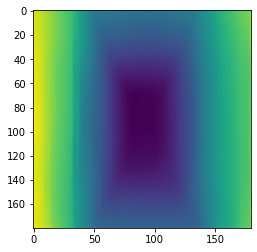

(73.43631337365042, 118.79809096596126)
50 (73.43631337365042, 118.79809096596126) turn right 0.8258333333333333 0.09784030000014354 1.0444470000002184 correct
(81.58086340207204, 142.2277706185751)
51 (81.58086340207204, 142.2277706185751) turn right 0.8283333333333334 0.09792139999990468 0.6681667999998808 correct
(78.48194874237217, 38.01642466079952)
(46.222599830077584, 172.39762107052235)
(58.02392065344406, 138.83138856476506)
52 (58.02392065344406, 138.83138856476506) turn right 0.1375 0.09781520000001365 0.7803736999999273 wrong


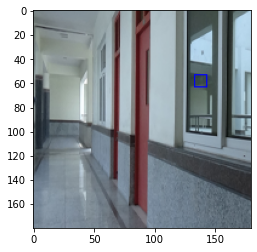

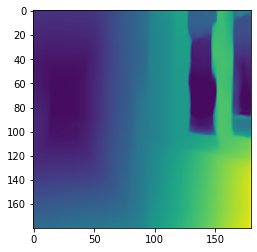

(70.93720149734703, 91.59126113333352)
53 (70.93720149734703, 91.59126113333352) turn right 0.4975 0.0956536999999571 0.9190583999998125 wrong


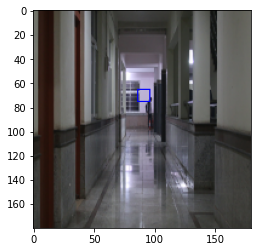

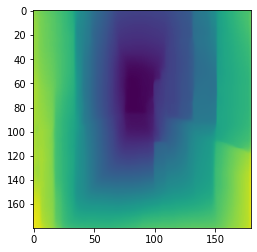

(85.7511602511569, 40.60763035762876)
54 (85.7511602511569, 40.60763035762876) turn left 0.15833333333333333 0.09451719999992747 0.7410107999999127 correct
(85.36235326357122, 79.1702370620466)
55 (85.36235326357122, 79.1702370620466) turn left 0.48083333333333333 0.09789860000000772 1.0004285999998501 correct
(82.57283652316715, 45.50422839701962)
56 (82.57283652316715, 45.50422839701962) turn left 0.1575 0.09533889999988787 0.9273345999999947 correct
(90.99709583735842, 42.59232010325542)
57 (90.99709583735842, 42.59232010325542) turn left 0.15416666666666667 0.09299299999997857 0.772423599999911 correct
(89.66214934272567, 138.48861634367256)
58 (89.66214934272567, 138.48861634367256) turn right 0.8275 0.0916959000001043 0.7454698999999891 correct
(88.14235997110093, 41.83689014380161)
59 (88.14235997110093, 41.83689014380161) turn left 0.14416666666666667 0.09061219999989589 0.7610774999998284 correct
(73.17524792826629, 82.11017524792439)
60 (73.17524792826629, 82.11017524792439) 

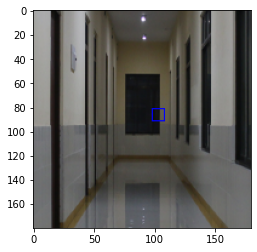

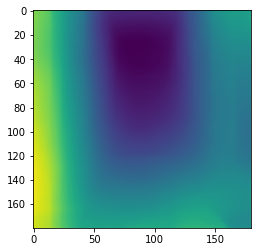

(84.63277231181463, 57.18423812613757)
62 (84.63277231181463, 57.18423812613757) turn left 0.2808333333333333 0.09800119999999879 1.0756579999999758 correct
(47.864628820958394, 20.21130519165358)
(82.21244041662716, 129.5816512681472)
63 (82.21244041662716, 129.5816512681472) turn right 0.8258333333333333 0.09803270000020348 0.976428000000169 correct
(78.08066128408653, 103.1921953094493)
64 (78.08066128408653, 103.1921953094493) turn right 0.7183333333333334 0.09522420000007514 1.2845230000000356 correct
(88.32501047840053, 45.975630201777335)
65 (88.32501047840053, 45.975630201777335) turn left 0.14333333333333334 0.09820119999994859 0.8192552999998952 correct
(86.86002759311647, 43.95679167188768)
66 (86.86002759311647, 43.95679167188768) turn left 0.195 0.0990954999999758 0.8004601999998613 correct
(50.804119193691314, 47.88957055214875)
(75.4427173643689, 125.92661629921582)
(72.47923322683859, 13.74547390841353)
67 (75.4427173643689, 125.92661629921582) turn right 0.7225 0.09825

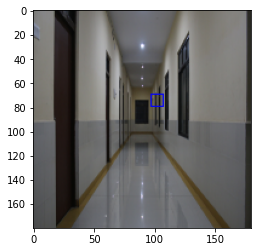

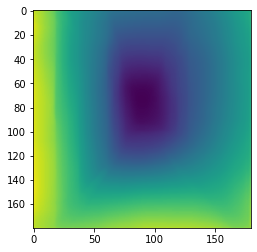

(80.49325055531753, 50.44369767043464)
88 (80.49325055531753, 50.44369767043464) turn left 0.20833333333333334 0.09529280000015206 0.8590700000002016 correct
(84.61349345426034, 54.732398721765776)
89 (84.61349345426034, 54.732398721765776) turn left 0.1875 0.09371200000009594 0.9109981999999945 correct
(77.38970042088518, 95.56963357265407)
90 (77.38970042088518, 95.56963357265407) turn right 0.4875 0.09169940000015231 0.9502933999999641 wrong


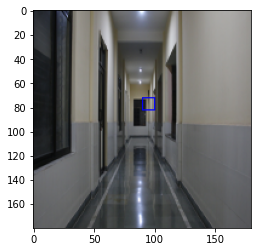

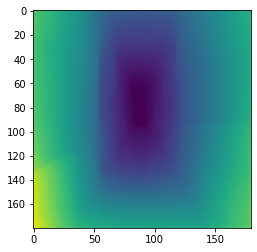

(90.5896409278581, 43.24804575786035)
91 (90.5896409278581, 43.24804575786035) turn left 0.1575 0.09052329999985886 0.7753200999998171 correct
(81.05733380229654, 121.25863021955166)
92 (81.05733380229654, 121.25863021955166) turn right 0.7758333333333334 0.09392939999997907 0.9331091999999899 correct
(88.89759076571558, 41.096302261591035)
93 (88.89759076571558, 41.096302261591035) turn left 0.15416666666666667 0.09803979999992407 0.9003849999999147 correct
(83.74769534677576, 89.69479806846067)
94 (83.74769534677576, 89.69479806846067) turn left 0.4875 0.0952586999999312 0.8907881999998608 correct
(68.60198858866198, 98.26875314646095)
95 (68.60198858866198, 98.26875314646095) turn right 0.8683333333333333 0.09317030000011073 1.066830100000061 correct
(82.47977773088414, 136.942392909896)
96 (82.47977773088414, 136.942392909896) turn right 0.8283333333333334 0.0914817000000312 0.865571300000056 correct
(73.83780508915437, 37.00571230742999)
(54.0986013986033, 164.02237762238312)
(61.

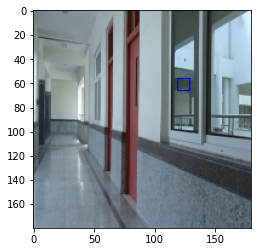

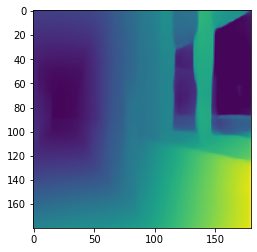

(86.14165152667996, 131.8884135263211)
98 (86.14165152667996, 131.8884135263211) turn right 0.7916666666666666 0.09831099999996695 0.8347515999998905 correct
(85.79933804553227, 50.331874789622475)
99 (85.79933804553227, 50.331874789622475) turn left 0.2808333333333333 0.09775969999986955 1.0373511999998755 correct
(87.16693865214707, 45.87029313991479)
100 (87.16693865214707, 45.87029313991479) turn left 0.20833333333333334 0.09874169999989135 0.8377175999999054 correct
(70.74254980515344, 75.28637286645547)
101 (70.74254980515344, 75.28637286645547) turn left 0.49583333333333335 0.09894119999989925 0.8849479000000429 correct
(88.79047514897576, 128.67483186611997)
102 (88.79047514897576, 128.67483186611997) turn right 0.8033333333333333 0.09872410000002674 1.0225981999999476 correct
(89.45596693025176, 133.10064701651453)
103 (89.45596693025176, 133.10064701651453) turn right 0.8258333333333333 0.09805750000009539 0.8398958000000221 correct
(74.43525335643899, 36.728020788223965)
(50

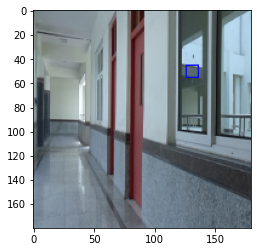

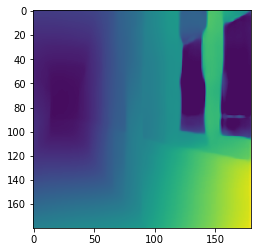

(87.89583467042303, 42.85135742249771)
105 (87.89583467042303, 42.85135742249771) turn left 0.1675 0.09808760000009897 0.9366465000000517 correct
(85.84650342534994, 136.7053516923225)
106 (85.84650342534994, 136.7053516923225) turn right 0.805 0.09800709999990431 0.7577558999998928 correct
(76.13798940241583, 135.52987930527428)
107 (76.13798940241583, 135.52987930527428) turn right 0.8025 0.09594979999997122 0.7481725000000097 correct
(78.04617384840415, 85.55516344721056)
108 (78.04617384840415, 85.55516344721056) turn left 0.48833333333333334 0.09518529999991188 1.3537463999998636 correct
(70.96639057784802, 100.20395461288498)
109 (70.96639057784802, 100.20395461288498) turn right 0.4708333333333333 0.0938520999998218 1.0047884999999042 wrong


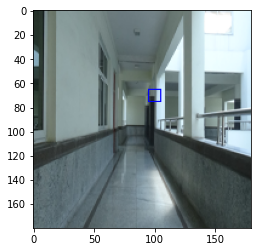

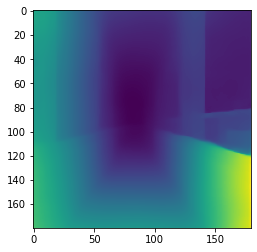

(85.05391571402419, 86.58442814080072)
110 (85.05391571402419, 86.58442814080072) turn left 0.4875 0.09232199999996737 1.0096759000000475 correct
(89.24182383945183, 135.71956563153503)
111 (89.24182383945183, 135.71956563153503) turn right 0.8025 0.09197969999991074 0.8062646999999288 correct
(85.37541038525424, 136.06485762143345)
112 (85.37541038525424, 136.06485762143345) turn right 0.805 0.09763060000000223 0.7740860000001248 correct
(79.65250450209518, 45.511438671377505)
113 (79.65250450209518, 45.511438671377505) turn left 0.1875 0.09625379999988581 0.9026228999998693 correct
(77.31618503843862, 84.57259380096373)
114 (77.31618503843862, 84.57259380096373) turn left 0.4841666666666667 0.09376259999999093 0.839600899999823 correct
(76.55439050299977, 76.88539886366179)
115 (76.55439050299977, 76.88539886366179) turn left 0.5033333333333333 0.09244399999988673 0.9951869999999872 wrong


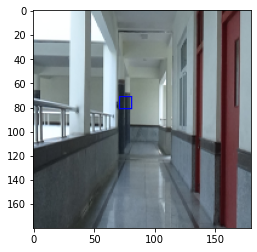

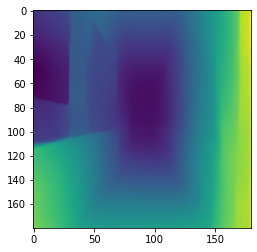

(76.24806803615873, 88.59951069857333)
116 (76.24806803615873, 88.59951069857333) turn left 0.49916666666666665 0.09109719999992194 1.2798691999998937 correct
(81.09280017844375, 126.90363058387808)
117 (81.09280017844375, 126.90363058387808) turn right 0.8008333333333333 0.09038690000011229 0.8574249999999211 correct
(87.79407898194037, 126.59546721351353)
118 (87.79407898194037, 126.59546721351353) turn right 0.7225 0.04561239999998179 0.9856485000000248 correct
(74.56808856546269, 103.86962917086893)
119 (74.56808856546269, 103.86962917086893) turn right 0.5466666666666666 0.09789570000020831 0.6891957000000275 correct
(71.61997589848899, 83.47806053732153)
120 (71.61997589848899, 83.47806053732153) turn left 0.48833333333333334 0.0954946999997901 0.7265390000000025 correct
(77.07558809571835, 44.614399023792984)
121 (77.07558809571835, 44.614399023792984) turn left 0.14333333333333334 0.09303380000005745 0.7485916000000543 correct
(88.87064705538661, 131.6211848148125)
122 (88.8706

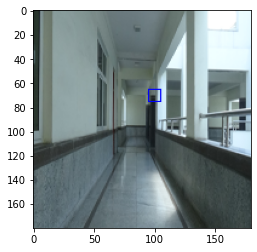

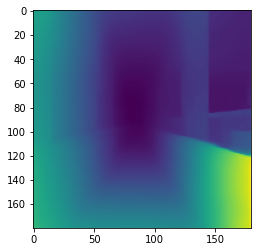

(84.0557982994655, 47.247224846472996)
137 (84.0557982994655, 47.247224846472996) turn left 0.20833333333333334 0.0904845000000023 0.8203459999999723 correct
(86.81686412905454, 135.1567935467463)
138 (86.81686412905454, 135.1567935467463) turn right 0.7958333333333333 0.09612609999999222 0.9264565000000857 correct
(70.52370878693652, 63.17444920280963)
139 (70.52370878693652, 63.17444920280963) turn left 0.20833333333333334 0.09425409999994372 0.9194228999999723 correct
(89.65958128602753, 127.48392437510181)
140 (89.65958128602753, 127.48392437510181) turn right 0.8 0.0986840000000484 0.8875201000000743 correct
(76.5438127666605, 104.54264902370855)
141 (76.5438127666605, 104.54264902370855) turn right 0.4975 0.09441050000009454 1.1837789000001067 wrong


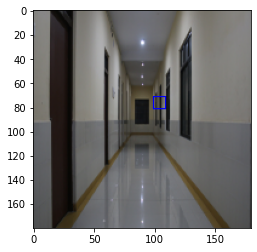

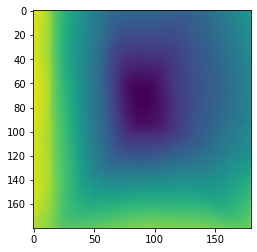

(84.71846409758548, 137.51705018020257)
142 (84.71846409758548, 137.51705018020257) turn right 0.8283333333333334 0.09425779999992301 0.7390583999999762 correct
(88.90185455302985, 39.51677432798409)
143 (88.90185455302985, 39.51677432798409) turn left 0.175 0.09254059999989295 0.8738631999999598 correct
(88.15581395346955, 48.59217243334242)
144 (88.15581395346955, 48.59217243334242) turn left 0.175 0.09829360000003362 0.8512301999999181 correct
(76.66669236700685, 103.65543562067126)
145 (76.66669236700685, 103.65543562067126) turn right 0.5466666666666666 0.09784679999984291 0.6884203999998135 correct
(73.05468361972574, 103.45947154064717)
146 (73.05468361972574, 103.45947154064717) turn right 0.4708333333333333 0.0981750999999349 1.0821972999999616 wrong


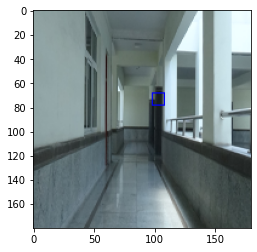

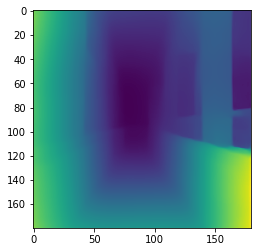

(86.35826130526311, 134.80389577851415)
147 (86.35826130526311, 134.80389577851415) turn right 0.7958333333333333 0.09446890000003805 0.7960884999999962 correct
(73.25109527234078, 48.1479108088631)
148 (73.25109527234078, 48.1479108088631) turn left 0.195 0.09247700000014447 0.7662990000001173 correct
(89.30758663751647, 44.01654698719449)
149 (89.30758663751647, 44.01654698719449) turn left 0.20833333333333334 0.09115810000002966 0.9302834000000075 correct
(91.12408798865259, 50.569312860708855)
150 (91.12408798865259, 50.569312860708855) turn left 0.225 0.098212999999987 0.8800246000000698 correct
(80.57912438044329, 50.312721265037325)
151 (80.57912438044329, 50.312721265037325) turn left 0.2808333333333333 0.09646810000003825 0.82685749999996 correct
(84.37432002460895, 54.210971979867416)
152 (84.37432002460895, 54.210971979867416) turn left 0.15416666666666667 0.09280159999980242 1.0561655999999857 correct
(29.26400924321289, 14.376083188908625)
(81.56430718773674, 127.139382344

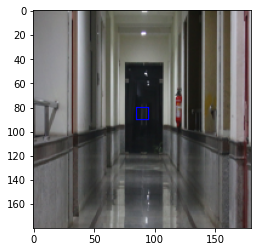

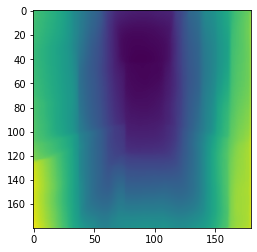

(74.91758771182462, 88.01139262028445)
160 (74.91758771182462, 88.01139262028445) turn left 0.4766666666666667 0.09490520000008473 0.8495432000001983 correct
(75.41041423030839, 82.78617590938757)
161 (75.41041423030839, 82.78617590938757) turn left 0.4841666666666667 0.09286999999994805 0.9393863999998757 correct
(79.0401248920421, 85.68710556034766)
162 (79.0401248920421, 85.68710556034766) turn left 0.4766666666666667 0.0914812000000893 0.7571769000001041 correct
(88.20778814247986, 135.09228072370584)
163 (88.20778814247986, 135.09228072370584) turn right 0.8275 0.09802829999989626 0.7962496000000101 correct
(82.93858505454966, 136.62938310573978)
164 (82.93858505454966, 136.62938310573978) turn right 0.8283333333333334 0.09407639999994899 0.8770574000000124 correct
(86.40290171794969, 133.53111151579483)
165 (86.40290171794969, 133.53111151579483) turn right 0.7916666666666666 0.09243450000008124 0.8079084000000876 correct
(79.31329065298704, 122.70668373876238)
166 (79.3132906529

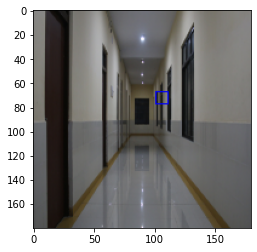

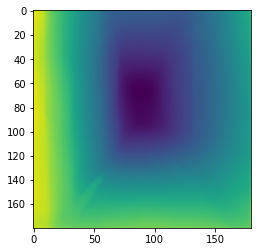

(83.08149378480545, 52.3261894556233)
169 (83.08149378480545, 52.3261894556233) turn left 0.1975 0.09500739999998586 0.889209499999879 correct
(89.75837441536093, 135.54481102261238)
170 (89.75837441536093, 135.54481102261238) turn right 0.8275 0.09300650000000132 0.9247699000000011 correct
(77.35737129239624, 49.66012416127868)
171 (77.35737129239624, 49.66012416127868) turn left 0.23416666666666666 0.09153760000003786 0.7911844000000201 correct
(84.75146806947673, 45.58166136529846)
172 (84.75146806947673, 45.58166136529846) turn left 0.16 0.09789760000012393 0.8098658000001251 correct
(89.78431259377246, 47.64042479509684)
173 (89.78431259377246, 47.64042479509684) turn left 0.21833333333333332 0.09442839999996977 0.9810315999998238 correct
(74.5024211053428, 123.12873601600309)
174 (74.5024211053428, 123.12873601600309) turn right 0.7916666666666666 0.09274709999999686 0.8632158000000345 correct
(70.08561643834518, 124.51363747552085)
175 (70.08561643834518, 124.51363747552085) tur

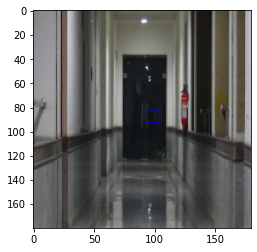

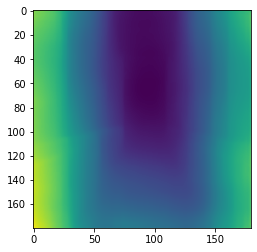

(85.17411510057619, 44.025528393171236)
182 (85.17411510057619, 44.025528393171236) turn left 0.175 0.09797209999987899 0.9244618000000173 correct
(71.03580551196164, 102.27900515344736)
183 (71.03580551196164, 102.27900515344736) turn right 0.48083333333333333 0.09806239999988975 1.019559500000014 wrong


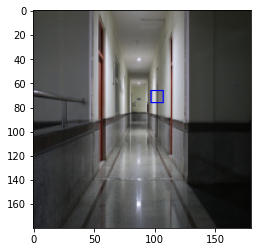

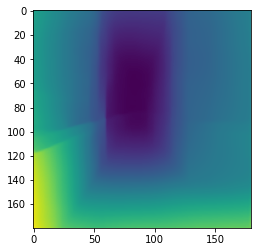

(79.2260395163424, 118.62739604832709)
184 (79.2260395163424, 118.62739604832709) turn right 0.7183333333333334 0.09492629999999735 1.0868920999998863 correct
(72.28039451222476, 80.4513498134829)
185 (72.28039451222476, 80.4513498134829) turn left 0.48833333333333334 0.0934290999998666 0.7850263000000268 correct
(88.93400546422998, 107.25847539149366)
186 (88.93400546422998, 107.25847539149366) turn right 0.7758333333333334 0.0921118999999635 1.1711301999998796 correct
(78.47165841038627, 107.84393494362706)
187 (78.47165841038627, 107.84393494362706) turn right 0.4975 0.0981075999998211 1.1723437999999078 wrong


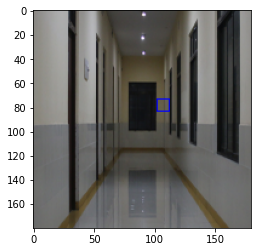

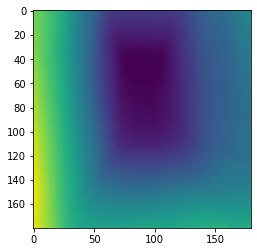

(83.8127384795863, 47.44484884061422)
188 (83.8127384795863, 47.44484884061422) turn left 0.23416666666666666 0.09557699999982106 0.8297597999999198 correct
(85.72001065811833, 81.47167599251894)
189 (85.72001065811833, 81.47167599251894) turn left 0.455 0.0934161000000131 1.0279673000000003 correct
(87.7977666594175, 37.98223479080645)
190 (87.7977666594175, 37.98223479080645) turn left 0.1675 0.09151469999983419 0.7112372999999934 correct
(92.25574262593872, 136.79731140693315)
191 (92.25574262593872, 136.79731140693315) turn right 0.8708333333333333 0.09084349999989172 0.7628248999999414 correct
(77.89274100202091, 123.85101692109936)
192 (77.89274100202091, 123.85101692109936) turn right 0.7183333333333334 0.04633049999983996 0.8214266999998472 correct
(78.2122035391749, 104.75211102137011)
193 (78.2122035391749, 104.75211102137011) turn right 0.5466666666666666 0.0499217999999928 0.8033907000001363 correct
(73.68575412277038, 102.40290398573627)
194 (73.68575412277038, 102.4029039

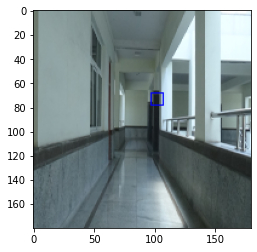

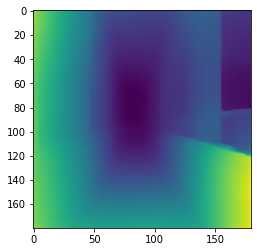

(85.82092847595759, 48.510836093187464)
195 (85.82092847595759, 48.510836093187464) turn left 0.16 0.0975573999999142 0.9797673999999006 correct
(84.783216374253, 131.0609356724921)
196 (84.783216374253, 131.0609356724921) turn right 0.8008333333333333 0.09509570000000167 0.8319366000000628 correct
(86.78586768271354, 138.15067544163196)
(179.0, 178.0)
197 (86.78586768271354, 138.15067544163196) turn right 0.8708333333333333 0.09283879999998135 0.7342137000000548 correct
(71.76295133435785, 65.10645604393531)
198 (71.76295133435785, 65.10645604393531) turn left 0.20833333333333334 0.09293370000000323 0.944252699999879 correct
(74.68440603442208, 103.4747934197624)
199 (74.68440603442208, 103.4747934197624) turn right 0.5466666666666666 0.09147970000003625 0.8255536000001484 correct
(71.88655783257781, 47.845988190342965)
200 (71.88655783257781, 47.845988190342965) turn left 0.23416666666666666 0.09786659999986114 0.7399980999998661 correct
(71.03058392866403, 101.78502686424434)
201 (7

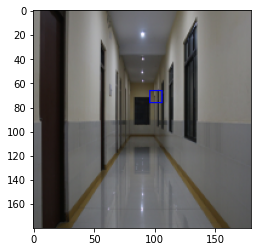

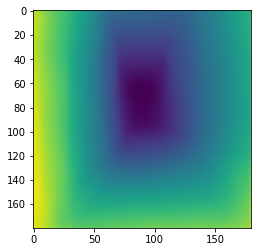

(85.50457307322448, 135.6972177806075)
202 (85.50457307322448, 135.6972177806075) turn right 0.7958333333333333 0.09490440000013223 0.917816700000003 correct
(88.47047143222274, 42.99634896233258)
203 (88.47047143222274, 42.99634896233258) turn left 0.1575 0.0929265000002033 0.7680963000000247 correct
(86.6875526113139, 97.01284631990421)
204 (86.6875526113139, 97.01284631990421) turn right 0.49083333333333334 0.09775480000007519 1.33443699999998 wrong


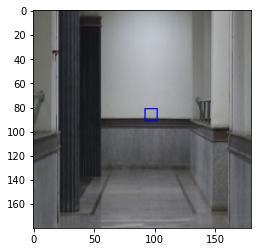

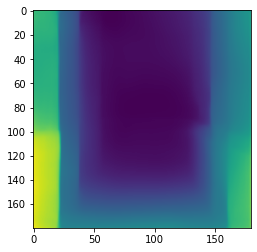

(68.86138197710788, 98.8178799596101)
205 (68.86138197710788, 98.8178799596101) turn right 0.82 0.09453450000000885 1.0693418000000747 correct
(75.46836359583847, 84.89656900967299)
206 (75.46836359583847, 84.89656900967299) turn left 0.4816666666666667 0.09799459999999272 0.8608292000001256 correct
(76.07028462693837, 104.04027590576564)
207 (76.07028462693837, 104.04027590576564) turn right 0.8383333333333334 0.09768290000010893 1.267897400000038 correct
(76.40535782625882, 104.12292384233427)
208 (76.40535782625882, 104.12292384233427) turn right 0.5466666666666666 0.09764719999998306 0.6917637999999897 correct
(91.82824427479406, 46.17664599235916)
209 (91.82824427479406, 46.17664599235916) turn left 0.225 0.09500570000000153 0.8209215000001677 correct
(87.17010502624566, 44.37003000749684)
210 (87.17010502624566, 44.37003000749684) turn left 0.14333333333333334 0.09287799999992785 0.9240248000000975 correct
(90.91782400735893, 47.74223477207653)
211 (90.91782400735893, 47.74223477

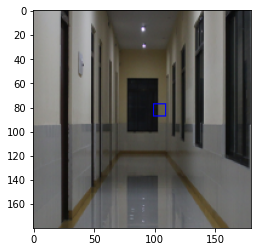

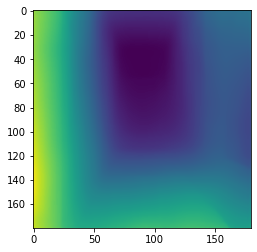

(77.84717863318203, 47.61179786075253)
218 (77.84717863318203, 47.61179786075253) turn left 0.1575 0.09180400000013833 0.9135508000001664 correct
(89.00779341629148, 47.34227055948911)
219 (89.00779341629148, 47.34227055948911) turn left 0.1825 0.09090360000004694 0.8292234000000462 correct
(67.83587910301544, 103.88891777704653)
220 (67.83587910301544, 103.88891777704653) turn right 0.4975 0.04628479999996671 0.7213168999999198 wrong


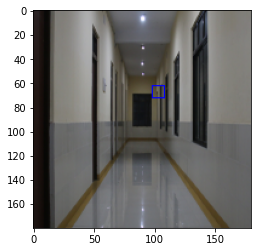

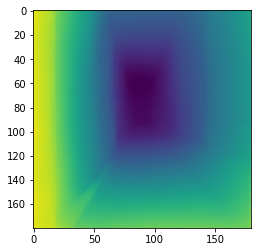

(73.0383761215314, 36.526872168432234)
(57.45494028230388, 156.90843286283587)
(60.59413202934113, 118.38875305623696)
221 (60.59413202934113, 118.38875305623696) turn right 0.1375 0.09809319999999389 0.895122800000081 wrong


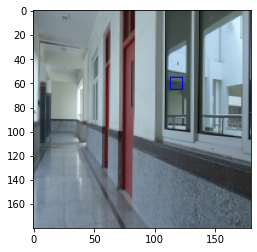

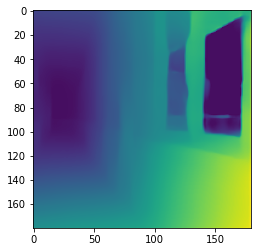

(88.31244147156659, 137.44943143811957)
222 (88.31244147156659, 137.44943143811957) turn right 0.8025 0.09807850000015605 0.7586115000001428 correct
(84.85135077091448, 65.16282266028381)
223 (84.85135077091448, 65.16282266028381) turn left 0.4841666666666667 0.0979651999998623 1.2031827999999223 correct
(84.90692033290864, 97.45312722945663)
224 (84.90692033290864, 97.45312722945663) turn right 0.4975 0.09511280000015176 0.9723063999999795 wrong


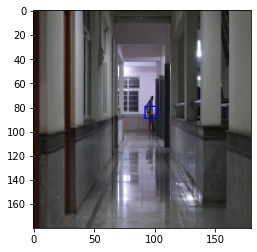

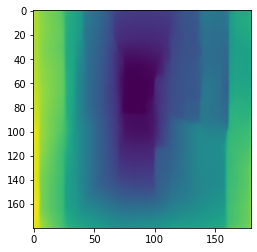

(75.95524621088146, 48.5548038769232)
225 (75.95524621088146, 48.5548038769232) turn left 0.23416666666666666 0.09291989999996986 0.7669165999998313 correct
(79.96697257787845, 125.05880090121954)
226 (79.96697257787845, 125.05880090121954) turn right 0.8008333333333333 0.0975623000001633 1.0181329000001824 correct
(83.33896835716226, 46.66604743327195)
227 (83.33896835716226, 46.66604743327195) turn left 0.23416666666666666 0.09506310000006124 0.7965903000001617 correct
(73.12475286671442, 80.26852510870279)
228 (73.12475286671442, 80.26852510870279) turn left 0.1275 0.09299750000013773 1.1191306000000623 correct
(91.29322884364025, 48.8721317020816)
229 (91.29322884364025, 48.8721317020816) turn left 0.225 0.09793559999980062 0.993171699999948 correct
(81.88089586755414, 48.23954719736403)
230 (81.88089586755414, 48.23954719736403) turn left 0.2808333333333333 0.09518590000016047 0.8088529000001472 correct
(74.13049403747442, 47.78201022146337)
231 (74.13049403747442, 47.782010221463

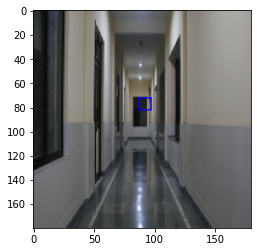

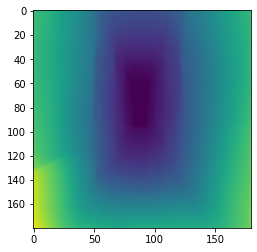

(70.46235600657862, 82.27907295666166)
238 (70.46235600657862, 82.27907295666166) turn left 0.48833333333333334 0.09493049999991854 0.7411608999998407 correct
(71.68341686252728, 102.43970372994892)
239 (71.68341686252728, 102.43970372994892) turn right 0.48083333333333333 0.09306570000012471 1.0247114000001147 wrong


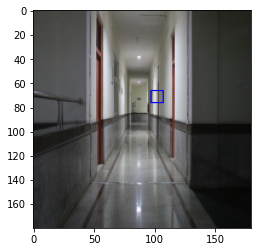

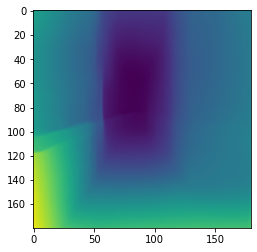

(68.8425317698954, 78.25514150652747)
240 (68.8425317698954, 78.25514150652747) turn left 0.48833333333333334 0.09796920000007958 0.9484917000002042 correct
(68.8216942957776, 88.54137841012191)
(63.33733493397483, 19.94597839135694)
241 (68.8216942957776, 88.54137841012191) turn left 0.4975 0.09479440000018258 0.8001107000000047 correct
(77.06505248640546, 40.713661788372015)
242 (77.06505248640546, 40.713661788372015) turn left 0.1975 0.09335110000006352 0.6883061000000907 correct
(81.08809048568953, 43.850898203590134)
243 (81.08809048568953, 43.850898203590134) turn left 0.1575 0.09351729999980307 0.7601104999998824 correct
(72.16643209005572, 72.76043028046519)
244 (72.16643209005572, 72.76043028046519) turn left 0.49083333333333334 0.09297620000006646 1.0686368000001494 correct
(92.75391742743814, 138.5023845210469)
245 (92.75391742743814, 138.5023845210469) turn right 0.8708333333333333 0.09129209999991872 0.7432134000000588 correct
(79.434909090903, 131.31947107437105)
246 (79.

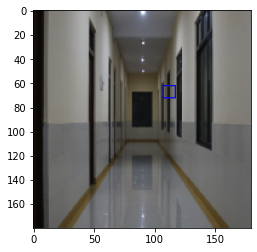

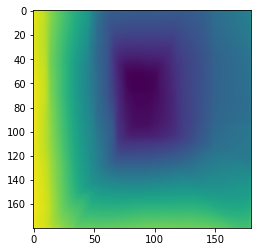

(86.86795980367621, 131.78534704367888)
249 (86.86795980367621, 131.78534704367888) turn right 0.7958333333333333 0.09482789999992747 0.9731010999998944 correct
(84.49448506103138, 112.68858555546352)
250 (84.49448506103138, 112.68858555546352) turn right 0.8008333333333333 0.09281940000005307 1.0583945000000767 correct
(86.45605570144714, 132.61326574236253)
251 (86.45605570144714, 132.61326574236253) turn right 0.7958333333333333 0.09123369999997522 0.7986985999998524 correct
(82.58585751976692, 94.26263852240348)
252 (82.58585751976692, 94.26263852240348) turn right 0.4975 0.09097410000003947 1.0281583999999384 wrong


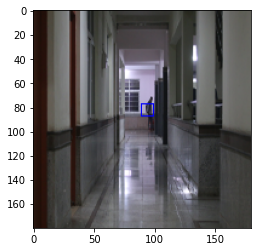

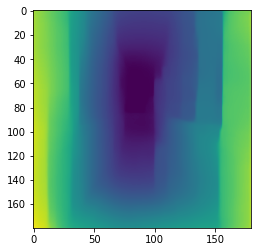

(85.47402796201287, 82.99316256758563)
253 (85.47402796201287, 82.99316256758563) turn left 0.4841666666666667 0.09771569999998064 0.916614299999992 correct
(74.67182599896678, 89.77344461302425)
(68.91734197731051, 174.79578606159097)
254 (74.67182599896678, 89.77344461302425) turn left 0.5033333333333333 0.09780589999991207 1.096313499999951 wrong


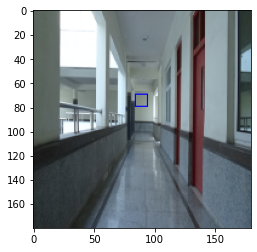

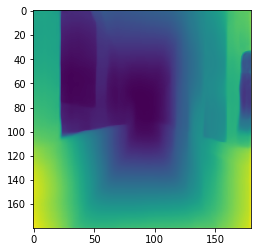

(87.55439766567967, 132.70999821352044)
255 (87.55439766567967, 132.70999821352044) turn right 0.7958333333333333 0.09491339999999582 0.8192265000000134 correct
(89.32882999352769, 136.43936651582544)
256 (89.32882999352769, 136.43936651582544) turn right 0.8275 0.09321790000012697 0.7663649000000987 correct
(75.43859252562136, 136.28767329717553)
257 (75.43859252562136, 136.28767329717553) turn right 0.8025 0.0912737000001016 0.6911887999999635 correct
(77.53679207921626, 38.816792079212405)
258 (77.53679207921626, 38.816792079212405) turn left 0.175 0.09139879999997902 0.8059665000000678 correct
(75.43286462639522, 84.1573200992367)
259 (75.43286462639522, 84.1573200992367) turn left 0.49583333333333335 0.09690450000016426 0.8703404000000319 correct
(82.5790977864769, 50.34861305686788)
260 (82.5790977864769, 50.34861305686788) turn left 0.20833333333333334 0.09781130000010307 0.8597549000000981 correct
(89.79343665682563, 43.772918366061546)
261 (89.79343665682563, 43.77291836606154

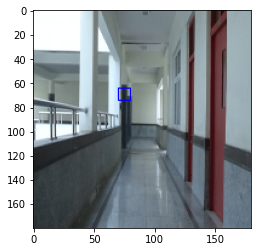

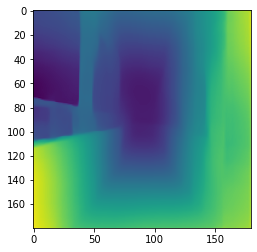

(83.52799030858603, 133.10979342003293)
267 (83.52799030858603, 133.10979342003293) turn right 0.8008333333333333 0.09110699999996541 0.9159395000001496 correct
(87.82645495243281, 39.35079742585271)
268 (87.82645495243281, 39.35079742585271) turn left 0.1675 0.09798419999992802 0.73838939999996 correct
(79.9695089522995, 130.21863735742173)
(89.54398148148157, 4.891203703703703)
(71.0, 35.0)
(72.0, 36.0)
(93.6019736842103, 31.26644736842097)
269 (79.9695089522995, 130.21863735742173) turn right 0.8683333333333333 0.09501530000011371 0.8478081000000657 correct
(91.75384195068283, 138.7236527559543)
270 (91.75384195068283, 138.7236527559543) turn right 0.8708333333333333 0.09612839999999778 0.8790203999999449 correct
(76.61376623374548, 88.42566233763897)
271 (76.61376623374548, 88.42566233763897) turn left 0.4816666666666667 0.09743319999984124 0.9082165999998324 correct
(82.09518115938106, 93.76565217386761)
272 (82.09518115938106, 93.76565217386761) turn right 0.49083333333333334 0.0

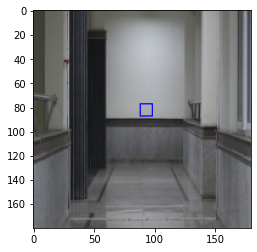

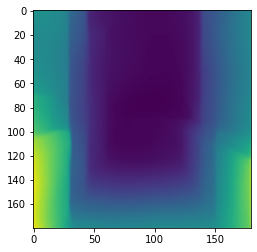

(80.19917447880026, 42.322722820763325)
273 (80.19917447880026, 42.322722820763325) turn left 0.14333333333333334 0.09491140000000087 0.7300055999999131 correct
(87.93862623844132, 41.320234058113)
274 (87.93862623844132, 41.320234058113) turn left 0.1675 0.098109999999906 0.7588968999998542 correct
(72.42239698863537, 82.97230624453393)
275 (72.42239698863537, 82.97230624453393) turn left 0.4841666666666667 0.09447989999989659 0.8901255000000674 correct
(83.01343995372899, 69.95428488845977)
(0.0, 179.0)
(53.0072342793561, 170.01725097385017)
276 (83.01343995372899, 69.95428488845977) turn left 0.455 0.09820620000004965 1.0289854000000105 correct
(87.78616235015326, 134.70219241039268)
277 (87.78616235015326, 134.70219241039268) turn right 0.8 0.09466139999994994 0.7937220999999681 correct
(25.06391478029339, 6.403462050599316)
(80.60296522975752, 124.86640637362927)
278 (80.60296522975752, 124.86640637362927) turn right 0.8683333333333333 0.09798109999996996 1.0611116000000038 correc

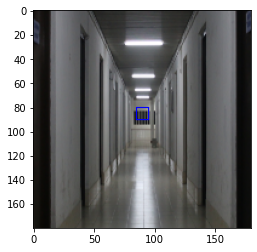

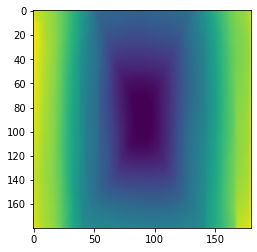

(72.5175533351288, 90.94045368619584)
284 (72.5175533351288, 90.94045368619584) turn right 0.4975 0.09132710000017141 0.8861765999999989 wrong


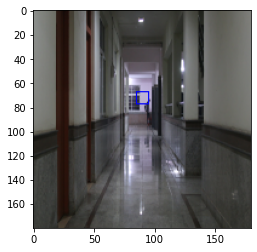

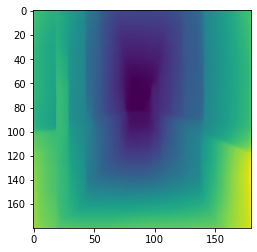

(84.30853932580463, 104.21850187261101)
285 (84.30853932580463, 104.21850187261101) turn right 0.8008333333333333 0.09043719999999666 1.1594009999998889 correct
(87.26067065243419, 89.80863010135403)
286 (87.26067065243419, 89.80863010135403) turn left 0.4875 0.04589069999997264 0.8567264000000705 correct
(88.75821946415407, 132.85941881971755)
287 (88.75821946415407, 132.85941881971755) turn right 0.7916666666666666 0.09795499999995627 0.9597234000000299 correct
(77.92605659154738, 87.49946000432094)
288 (77.92605659154738, 87.49946000432094) turn left 0.495 0.0977994000002127 0.7169373000001542 correct
(79.27142051858424, 94.25197294248348)
289 (79.27142051858424, 94.25197294248348) turn right 0.4875 0.09491810000008627 0.8528208000000177 wrong


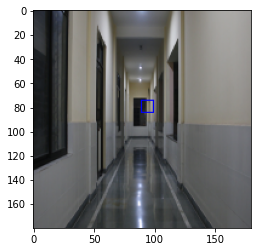

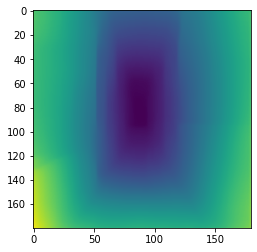

(75.30189902131552, 48.00602761034013)
290 (75.30189902131552, 48.00602761034013) turn left 0.17416666666666666 0.09789939999996022 0.9107175000001462 correct
(70.3981393881873, 72.4755597603091)
291 (70.3981393881873, 72.4755597603091) turn left 0.4891666666666667 0.09822399999984555 0.9034692000000177 correct
(50.39005235602242, 7.6714659685866184)
(80.25775738455515, 127.16747920846427)
292 (80.25775738455515, 127.16747920846427) turn right 0.7183333333333334 0.09505890000014006 1.0359075000001212 correct
(89.75740282796556, 135.6475810030929)
293 (89.75740282796556, 135.6475810030929) turn right 0.8025 0.09323739999990721 0.7823808999999073 correct
(71.92742140279304, 115.95855553859339)
294 (71.92742140279304, 115.95855553859339) turn right 0.8258333333333333 0.09142240000005586 0.9402036999999837 correct
(71.97437137328464, 112.46982591872688)
295 (71.97437137328464, 112.46982591872688) turn right 0.8258333333333333 0.09040359999994507 1.09482150000008 correct
(78.22749136654043,

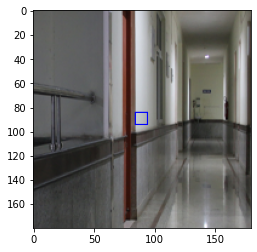

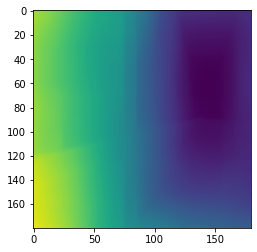

(88.96940583895717, 90.14143581128566)
11 (88.96940583895717, 90.14143581128566) turn right 0.7225 0.135460299999977 1.4034327999997913 correct
(89.49999999994905, 89.49999999994951)
12 (89.49999999994905, 89.49999999994951) turn left 0.49083333333333334 0.09848629999987679 1.5169094999998833 correct
(89.49999999994905, 89.49999999994951)
13 (89.49999999994905, 89.49999999994951) turn left 0.49583333333333335 0.09534460000008949 1.5166097000001173 correct
(89.49999999994905, 89.49999999994951)
14 (89.49999999994905, 89.49999999994951) turn left 0.4891666666666667 0.09312490000002072 1.3703649999999925 correct
(89.49999999994905, 89.49999999994951)
15 (89.49999999994905, 89.49999999994951) turn left 0.48083333333333333 0.09825169999999162 1.5184494999998606 correct
(89.31371092535936, 89.25184153507824)
16 (89.31371092535936, 89.25184153507824) turn left 0.47333333333333333 0.09465849999992315 1.3723170999999184 correct
(89.10514228961833, 89.97933153332643)
17 (89.10514228961833, 89.97

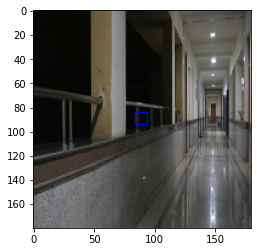

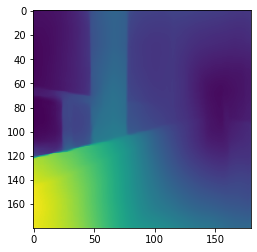

(89.49999999994905, 89.49999999994951)
18 (89.49999999994905, 89.49999999994951) turn left 0.4891666666666667 0.09665990000007696 1.5201792000000296 correct
(89.49999999994905, 89.49999999994951)
19 (89.49999999994905, 89.49999999994951) turn left 0.21833333333333332 0.13562709999996514 1.4143549999998868 correct
(88.90958177273433, 90.48414481892644)
20 (88.90958177273433, 90.48414481892644) turn right 0.5466666666666666 0.09779449999996359 1.5004742000000988 correct
(88.89884075267605, 87.93701108976875)
(0.0, 179.0)
21 (88.89884075267605, 87.93701108976875) turn left 0.16 0.09816270000010263 1.500511799999913 correct
(88.2441810498749, 77.15952875452655)
22 (88.2441810498749, 77.15952875452655) turn left 0.15833333333333333 0.09444559999997182 1.2150111999999353 correct
(89.49999999994905, 89.49999999994951)
23 (89.49999999994905, 89.49999999994951) turn left 0.455 0.0924552000001313 1.5182836999999836 correct
(89.49999999994905, 89.49999999994951)
24 (89.49999999994905, 89.49999999

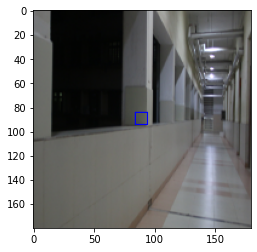

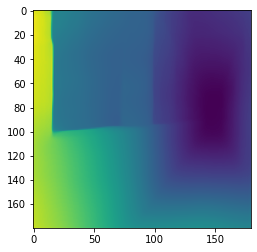

(89.49999999994905, 89.49999999994951)
34 (89.49999999994905, 89.49999999994951) turn left 0.495 0.13524929999994129 1.5600859999999557 correct
(89.20335670405079, 89.95712601595754)
35 (89.20335670405079, 89.95712601595754) turn left 0.5466666666666666 0.1355829999999969 1.3984447000000273 wrong


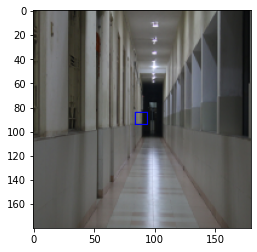

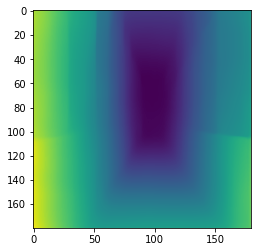

(89.49999999994905, 89.49999999994951)
36 (89.49999999994905, 89.49999999994951) turn left 0.48833333333333334 0.09821549999992385 1.5166532000000643 correct
(88.97719170463984, 71.97274504539132)
37 (88.97719170463984, 71.97274504539132) turn left 0.15416666666666667 0.1354127999998127 1.3348465999999917 correct
(89.59712989338205, 100.5204881994508)
38 (89.59712989338205, 100.5204881994508) turn right 0.8283333333333334 0.09780909999994947 1.2377767000000404 correct
(89.49999999994905, 89.49999999994951)
39 (89.49999999994905, 89.49999999994951) turn left 0.4816666666666667 0.09553019999998469 1.5194989999999962 correct
(89.37567299951604, 89.27291292772998)
40 (89.37567299951604, 89.27291292772998) turn left 0.1575 0.09360800000013114 1.391510500000095 correct
(89.72356895493445, 81.3264751815964)
(0.0, 179.0)
41 (89.72356895493445, 81.3264751815964) turn left 0.14416666666666667 0.09801579999998467 1.413408299999901 correct
(88.79592812077095, 86.70493213529858)
42 (88.795928120770

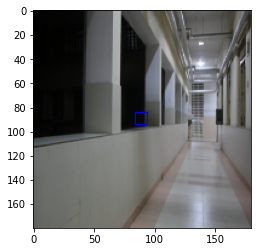

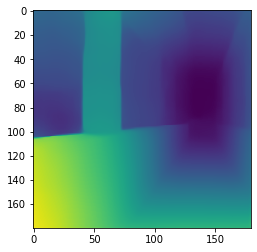

(88.8880994670902, 90.34065625871382)
45 (88.8880994670902, 90.34065625871382) turn right 0.8033333333333333 0.09725639999987834 1.3646278999999595 correct
(89.49999999994905, 89.49999999994951)
46 (89.49999999994905, 89.49999999994951) turn left 0.48083333333333333 0.135580599999912 1.5510741999999027 correct
(89.49999999994905, 89.49999999994951)
47 (89.49999999994905, 89.49999999994951) turn left 0.1975 0.09784340000010161 1.5282609000000775 correct
(88.93416879154114, 90.14954288196961)
48 (88.93416879154114, 90.14954288196961) turn right 0.7916666666666666 0.09821820000001935 1.3657726999999795 correct
(89.49999999994905, 89.49999999994951)
49 (89.49999999994905, 89.49999999994951) turn left 0.495 0.09463130000017372 1.512923600000022 correct
(89.47347946892098, 89.52760111140367)
50 (89.47347946892098, 89.52760111140367) turn left 0.8258333333333333 0.09764570000015738 1.5205065000000104 wrong


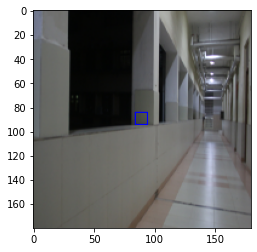

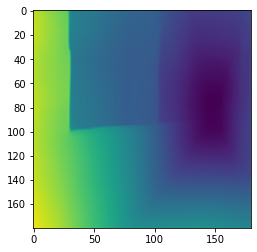

(89.35775877486816, 101.78303338218211)
51 (89.35775877486816, 101.78303338218211) turn right 0.8283333333333334 0.09537759999989248 1.2167773999999554 correct
(85.38832898254236, 84.25536133227462)
52 (85.38832898254236, 84.25536133227462) turn left 0.1375 0.09439550000001873 1.437480700000151 correct
(89.49999999994905, 89.49999999994951)
53 (89.49999999994905, 89.49999999994951) turn left 0.4975 0.09285429999999906 1.372551600000179 correct
(88.28513483881017, 75.58938098366522)
54 (88.28513483881017, 75.58938098366522) turn left 0.15833333333333333 0.09127330000001166 1.3285642000000735 correct
(89.49999999994905, 89.49999999994951)
55 (89.49999999994905, 89.49999999994951) turn left 0.48083333333333333 0.09053770000014083 1.3647759000000406 correct
(89.382221947246, 89.31176543357589)
56 (89.382221947246, 89.31176543357589) turn left 0.1575 0.0459837000000789 1.4587582999999995 correct
(89.40045431790504, 71.64848111497066)
57 (89.40045431790504, 71.64848111497066) turn left 0.154

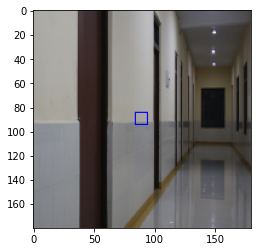

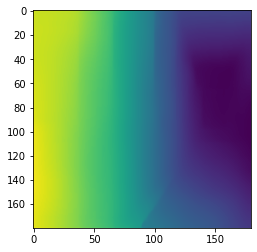

(90.49532710275905, 77.99858397050741)
59 (90.49532710275905, 77.99858397050741) turn left 0.14416666666666667 0.09308329999998932 1.3718447999999626 correct
(89.49999999994905, 89.49999999994951)
60 (89.49999999994905, 89.49999999994951) turn left 0.48833333333333334 0.09156460000008337 1.3684035000001131 correct
(89.49999999994905, 89.49999999994951)
61 (89.49999999994905, 89.49999999994951) turn left 0.4975 0.09799519999978656 1.503563799999938 correct
(89.49999999994905, 89.49999999994951)
62 (89.49999999994905, 89.49999999994951) turn left 0.2808333333333333 0.09490200000004734 1.5039721000000554 correct
(89.49999999994905, 89.49999999994951)
63 (89.49999999994905, 89.49999999994951) turn left 0.8258333333333333 0.09766450000006444 1.3697595000001002 wrong


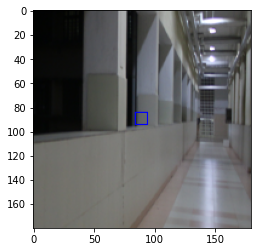

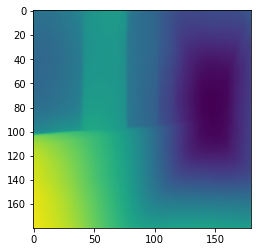

(89.49999999994905, 89.49999999994951)
64 (89.49999999994905, 89.49999999994951) turn left 0.7183333333333334 0.09616370000003371 1.3758052999999109 wrong


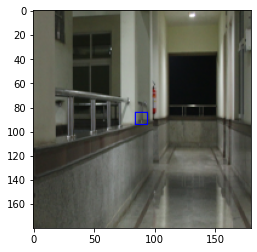

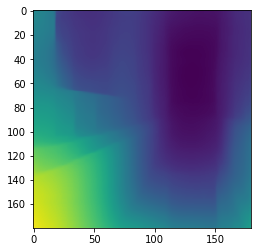

(89.38292147336645, 89.31453932509744)
65 (89.38292147336645, 89.31453932509744) turn left 0.14333333333333334 0.09367930000007618 1.5050381000000925 correct
(89.5488264360207, 89.44478072879454)
66 (89.5488264360207, 89.44478072879454) turn left 0.195 0.09798210000008112 1.3752392999999756 correct
(89.49999999994905, 89.49999999994951)
67 (89.49999999994905, 89.49999999994951) turn left 0.7225 0.09491050000019641 1.5032353000001422 wrong


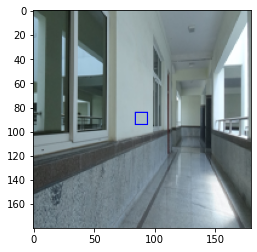

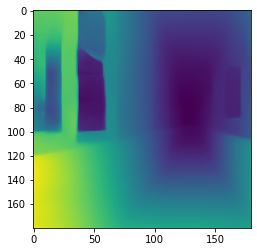

(89.49999999994905, 89.49999999994951)
68 (89.49999999994905, 89.49999999994951) turn left 0.4766666666666667 0.13550030000010338 1.5530702999999448 correct
(89.49999999994905, 89.49999999994951)
69 (89.49999999994905, 89.49999999994951) turn left 0.2808333333333333 0.09810170000014296 1.519421599999987 correct
(88.8628074440722, 88.62804326813149)
70 (88.8628074440722, 88.62804326813149) turn left 0.47333333333333333 0.09496320000016567 1.362660200000164 correct
(89.34148831439272, 103.30947606368315)
71 (89.34148831439272, 103.30947606368315) turn right 0.805 0.09769630000005236 1.339855499999885 correct
(88.26758709258493, 86.06672017975687)
(0.0, 179.0)
72 (88.26758709258493, 86.06672017975687) turn left 0.225 0.09445469999991474 1.3297944999999345 correct
(88.86781566404466, 74.13519952348997)
73 (88.86781566404466, 74.13519952348997) turn left 0.15416666666666667 0.09804809999991448 1.3211867999998503 correct
(89.49999999994905, 89.49999999994951)
74 (89.49999999994905, 89.499999

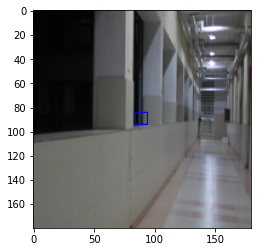

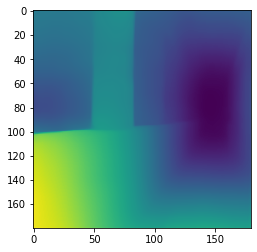

(89.49999999994905, 89.49999999994951)
75 (89.49999999994905, 89.49999999994951) turn left 0.8383333333333334 0.13550839999993514 1.4144698000000062 wrong


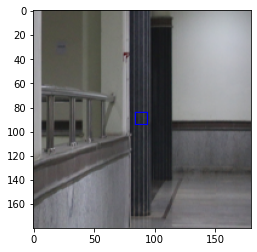

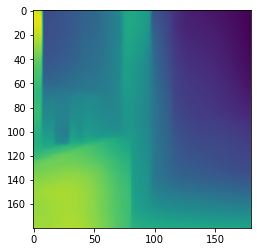

(89.43265785241421, 89.57735079693455)
76 (89.43265785241421, 89.57735079693455) turn left 0.8683333333333333 0.09795080000003509 1.5200353000000177 wrong


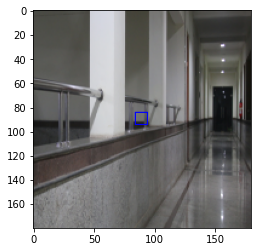

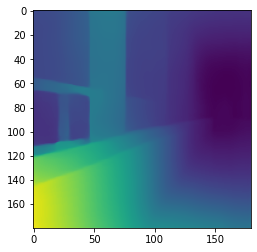

(89.49999999994905, 89.49999999994951)
77 (89.49999999994905, 89.49999999994951) turn left 0.8708333333333333 0.13561890000005405 1.5602991999999176 wrong


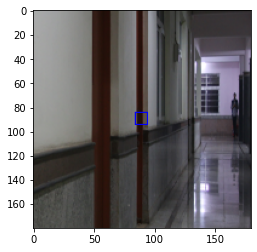

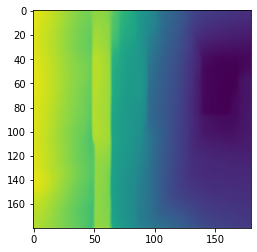

(89.49999999994905, 89.49999999994951)
78 (89.49999999994905, 89.49999999994951) turn left 0.4875 0.09780410000007578 1.3762861000000157 correct
(89.05681264807244, 93.91075544584757)
79 (89.05681264807244, 93.91075544584757) turn right 0.8033333333333333 0.09496230000013384 1.458757500000047 correct
(89.49999999994905, 89.49999999994951)
80 (89.49999999994905, 89.49999999994951) turn left 0.1575 0.0932377000001452 1.369933200000105 correct
(86.43583550698857, 86.378031108058)
81 (86.43583550698857, 86.378031108058) turn left 0.20833333333333334 0.09146699999996599 1.4565359999999146 correct
(88.75768295375066, 74.96035079958043)
82 (88.75768295375066, 74.96035079958043) turn left 0.15833333333333333 0.09771739999996498 1.3270489000001362 correct
(89.49999999994905, 89.49999999994951)
83 (89.49999999994905, 89.49999999994951) turn left 0.1975 0.09797819999994317 1.3689699999999903 correct
(89.49999999994905, 89.49999999994951)
84 (89.49999999994905, 89.49999999994951) turn left 0.195 0

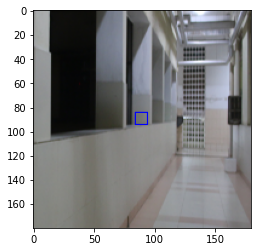

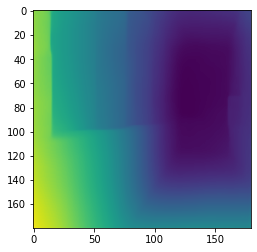

(88.35463233547966, 69.88460627119535)
93 (88.35463233547966, 69.88460627119535) turn left 0.15416666666666667 0.13550159999999778 1.166742799999838 correct
(89.49999999994905, 89.49999999994951)
94 (89.49999999994905, 89.49999999994951) turn left 0.4875 0.097760899999912 1.5140039999998862 correct
(89.49999999994905, 89.49999999994951)
95 (89.49999999994905, 89.49999999994951) turn left 0.8683333333333333 0.1357596000000285 1.5617296000000351 wrong


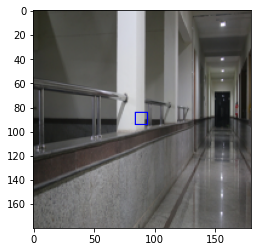

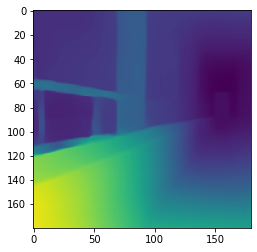

(89.89543028681115, 96.21117411602683)
96 (89.89543028681115, 96.21117411602683) turn right 0.8283333333333334 0.09790570000018306 1.2911561000000802 correct
(86.49002296169505, 85.82794864326988)
97 (86.49002296169505, 85.82794864326988) turn left 0.1375 0.135465700000168 1.503918300000123 correct
(89.49999999994905, 89.49999999994951)
98 (89.49999999994905, 89.49999999994951) turn left 0.7916666666666666 0.09802949999993871 1.5210246000001462 wrong


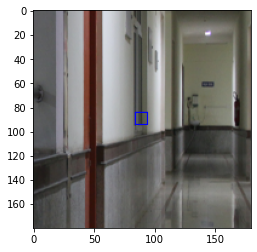

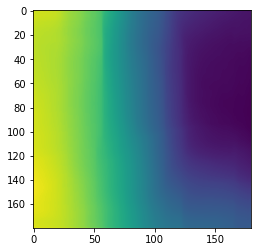

(89.49999999994905, 89.49999999994951)
99 (89.49999999994905, 89.49999999994951) turn left 0.2808333333333333 0.09488000000010288 1.3734834000001683 correct
(89.49999999994905, 89.49999999994951)
100 (89.49999999994905, 89.49999999994951) turn left 0.20833333333333334 0.09388079999985166 1.5196556999999302 correct
(89.49999999994905, 89.49999999994951)
101 (89.49999999994905, 89.49999999994951) turn left 0.49583333333333335 0.09241300000007868 1.375272200000154 correct
(89.49999999994905, 89.49999999994951)
102 (89.49999999994905, 89.49999999994951) turn left 0.8033333333333333 0.09129789999997229 1.5037893999999596 wrong


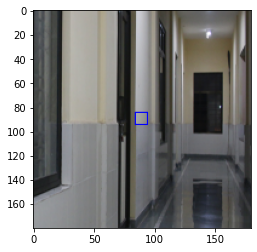

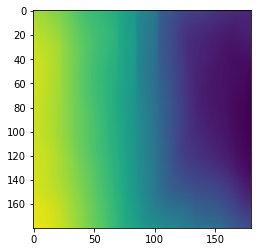

(89.49999999994905, 89.49999999994951)
103 (89.49999999994905, 89.49999999994951) turn left 0.8258333333333333 0.09054990000004182 1.5097228000001905 wrong


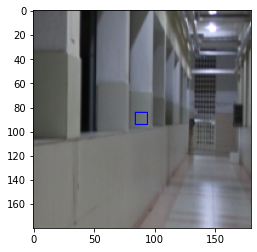

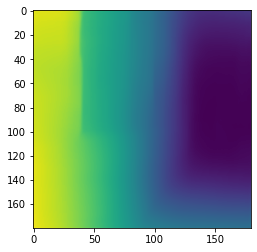

(86.66027211757007, 86.04313902497215)
104 (86.66027211757007, 86.04313902497215) turn left 0.1375 0.046203900000136855 1.2715895999999702 correct
(88.7153665044241, 88.01280803636567)
105 (88.7153665044241, 88.01280803636567) turn left 0.1675 0.09769749999986743 1.5011944000000312 correct
(90.02213162488117, 98.40213779158407)
106 (90.02213162488117, 98.40213779158407) turn right 0.805 0.1357669999999871 1.4455740000000787 correct
(89.62668787323352, 93.91047779792412)
107 (89.62668787323352, 93.91047779792412) turn right 0.8025 0.09800969999992049 1.3224331999999777 correct
(89.49999999994905, 89.49999999994951)
108 (89.49999999994905, 89.49999999994951) turn left 0.48833333333333334 0.09511619999989307 1.5124269999998887 correct
(89.39611674494053, 89.34504081122847)
109 (89.39611674494053, 89.34504081122847) turn left 0.4708333333333333 0.09306369999990238 1.5213177999999061 correct
(89.49999999994905, 89.49999999994951)
110 (89.49999999994905, 89.49999999994951) turn left 0.4875 0

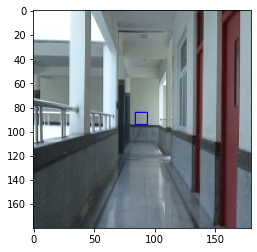

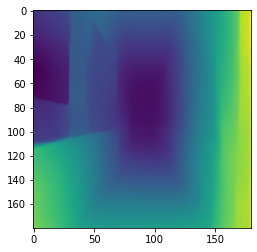

(89.49999999994905, 89.49999999994951)
116 (89.49999999994905, 89.49999999994951) turn left 0.49916666666666665 0.0916548000000148 1.508615799999916 correct
(89.49999999994905, 89.49999999994951)
117 (89.49999999994905, 89.49999999994951) turn left 0.8008333333333333 0.09055929999999535 1.3719573999999284 wrong


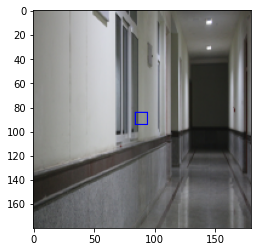

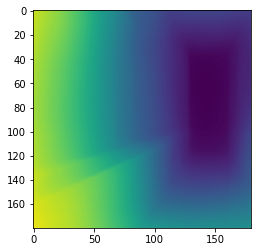

(89.23865990878485, 92.34959038597509)
118 (89.23865990878485, 92.34959038597509) turn right 0.7225 0.09766469999999572 1.4755584999998064 correct
(89.23098083850212, 91.64437488137688)
119 (89.23098083850212, 91.64437488137688) turn right 0.5466666666666666 0.09467270000004646 1.478661000000102 correct
(89.49999999994905, 89.49999999994951)
120 (89.49999999994905, 89.49999999994951) turn left 0.48833333333333334 0.0931502000000819 1.3680421999999908 correct
(89.24938019085057, 89.13679186805452)
121 (89.24938019085057, 89.13679186805452) turn left 0.14333333333333334 0.09149999999999636 1.499731699999984 correct
(88.34592758040843, 91.14823670048749)
122 (88.34592758040843, 91.14823670048749) turn right 0.8033333333333333 0.09038639999994302 1.4891539000000193 correct
(89.49999999994905, 89.49999999994951)
123 (89.49999999994905, 89.49999999994951) turn left 0.8033333333333333 0.04600439999990158 1.3217783000000054 wrong


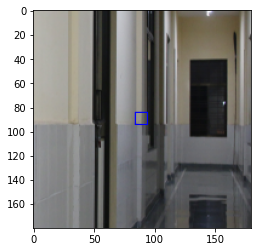

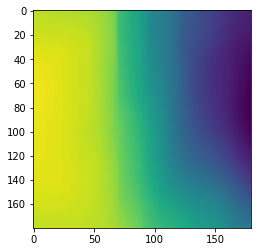

(89.29833322923997, 90.49756539104766)
124 (89.29833322923997, 90.49756539104766) turn right 0.8 0.09768020000001343 1.5066260000000966 correct
(87.74270951575542, 70.55900888555152)
125 (87.74270951575542, 70.55900888555152) turn left 0.15416666666666667 0.09615819999999076 1.1366312000000107 correct
(89.40596618690556, 79.02714126026432)
(0.0, 179.0)
126 (89.40596618690556, 79.02714126026432) turn left 0.16 0.09401410000009491 1.3808301000001393 correct
(89.49999999994905, 89.49999999994951)
127 (89.49999999994905, 89.49999999994951) turn left 0.14416666666666667 0.09810429999993175 1.5211603000000196 correct
(88.80452590937038, 90.9666677128275)
128 (88.80452590937038, 90.9666677128275) turn right 0.8033333333333333 0.09512309999990975 1.3565157000000454 correct
(89.49999999994905, 89.49999999994951)
129 (89.49999999994905, 89.49999999994951) turn left 0.1975 0.09796809999988909 1.5202755000000252 correct
(90.23454201748297, 98.65715758716438)
130 (90.23454201748297, 98.657157587164

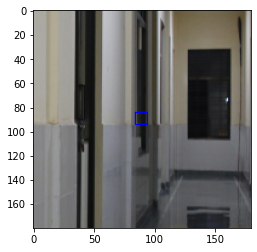

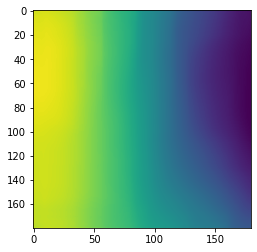

(89.49999999994905, 89.49999999994951)
135 (89.49999999994905, 89.49999999994951) turn left 0.175 0.13066820000017287 1.622013200000083 correct
(88.8356844141565, 88.52927407772289)
136 (88.8356844141565, 88.52927407772289) turn left 0.4708333333333333 0.09779469999989487 1.3810288999998193 correct
(88.56441123126767, 88.39106372329493)
137 (88.56441123126767, 88.39106372329493) turn left 0.20833333333333334 0.09492420000015045 1.4962236000001212 correct
(90.16049872667898, 95.4826206303027)
138 (90.16049872667898, 95.4826206303027) turn right 0.7958333333333333 0.09294529999988299 1.3073329999999714 correct
(85.80989854313715, 85.70912460973503)
139 (85.80989854313715, 85.70912460973503) turn left 0.20833333333333334 0.09136639999996987 1.4470447000001059 correct
(88.57676973782574, 90.9779940354227)
140 (88.57676973782574, 90.9779940354227) turn right 0.8 0.09039219999999659 1.4929469000001063 correct
(89.49999999994905, 89.49999999994951)
141 (89.49999999994905, 89.49999999994951) t

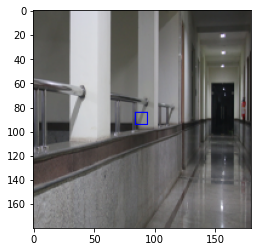

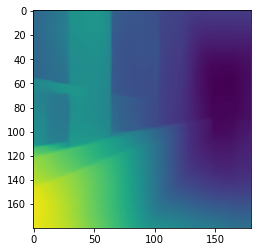

(89.49999999994905, 89.49999999994951)
154 (89.49999999994905, 89.49999999994951) turn left 0.8275 0.13554359999989174 1.4069798000000446 wrong


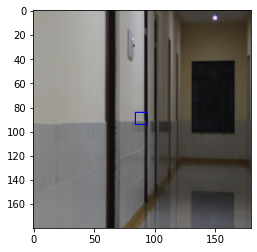

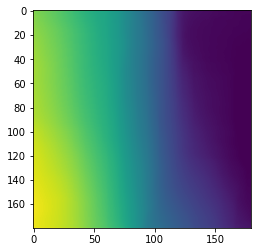

(89.49999999994905, 89.49999999994951)
155 (89.49999999994905, 89.49999999994951) turn left 0.8383333333333334 0.0979671000000053 1.5181078999999045 wrong


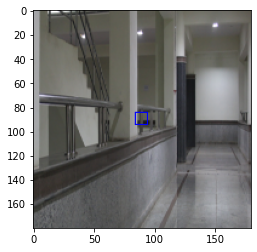

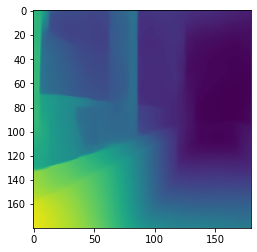

(88.9506487330566, 97.69872970581191)
156 (88.9506487330566, 97.69872970581191) turn right 0.8008333333333333 0.13560510000002068 1.4585482999998476 correct
(89.09210772390718, 90.37513247298762)
157 (89.09210772390718, 90.37513247298762) turn right 0.8 0.09771030000001701 1.3708632000000307 correct
(89.49999999994905, 89.49999999994951)
158 (89.49999999994905, 89.49999999994951) turn left 0.17416666666666666 0.09572019999995973 1.5170627999998487 correct
(89.49999999994905, 89.49999999994951)
159 (89.49999999994905, 89.49999999994951) turn left 0.49583333333333335 0.13575679999985368 1.4205070000000433 correct
(89.49999999994905, 89.49999999994951)
160 (89.49999999994905, 89.49999999994951) turn left 0.4766666666666667 0.09831110000004628 1.5120575999999346 correct
(89.49999999994905, 89.49999999994951)
161 (89.49999999994905, 89.49999999994951) turn left 0.4841666666666667 0.09525440000015806 1.515594000000192 correct
(89.49999999994905, 89.49999999994951)
162 (89.49999999994905, 89.

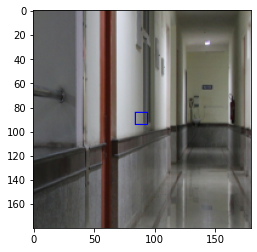

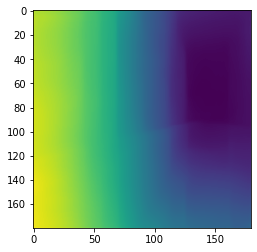

(89.49999999994905, 89.49999999994951)
166 (89.49999999994905, 89.49999999994951) turn left 0.8383333333333334 0.09496969999986504 1.515625499999942 wrong


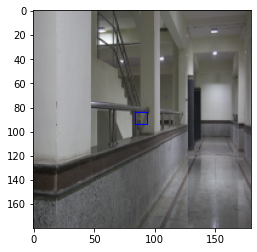

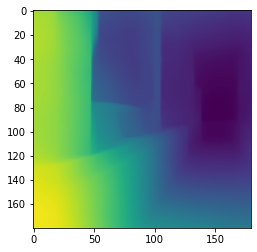

(89.49999999994905, 89.49999999994951)
167 (89.49999999994905, 89.49999999994951) turn left 0.48083333333333333 0.09282509999979993 1.3615274999999656 correct
(89.49999999994905, 89.49999999994951)
168 (89.49999999994905, 89.49999999994951) turn left 0.4975 0.09251340000014352 1.5006883999999445 correct
(89.01261464295277, 88.25849062504854)
169 (89.01261464295277, 88.25849062504854) turn left 0.1975 0.09126719999994748 1.4878087999998115 correct
(89.46731073799329, 91.79043395623734)
170 (89.46731073799329, 91.79043395623734) turn right 0.8275 0.0902665999999499 1.3394379999999728 correct
(89.0382787012079, 88.91660711506552)
171 (89.0382787012079, 88.91660711506552) turn left 0.23416666666666666 0.04638319999980922 1.455889099999922 correct
(88.5746826873802, 81.59922152644226)
(0.0, 179.0)
172 (88.5746826873802, 81.59922152644226) turn left 0.16 0.09815030000004299 1.4175330000000486 correct
(89.61824763314006, 89.28401707810086)
173 (89.61824763314006, 89.28401707810086) turn left 

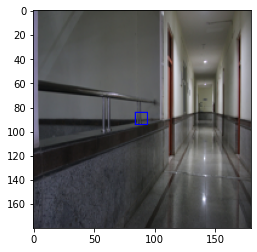

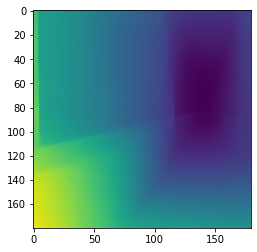

(89.47900716221136, 89.52210422321451)
175 (89.47900716221136, 89.52210422321451) turn left 0.7758333333333334 0.1341287000000193 1.5634529999999813 wrong


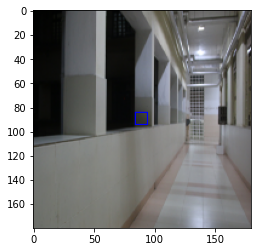

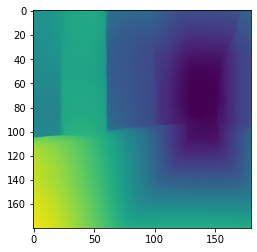

(89.49999999994905, 89.49999999994951)
176 (89.49999999994905, 89.49999999994951) turn left 0.15416666666666667 0.09795749999989312 1.377283000000034 correct
(88.62538689907339, 87.48133409129083)
177 (88.62538689907339, 87.48133409129083) turn left 0.1875 0.09502659999998286 1.4882340000001477 correct
(89.49999999994905, 89.49999999994951)
178 (89.49999999994905, 89.49999999994951) turn left 0.4891666666666667 0.09284969999998793 1.5122501999999258 correct
(89.3827893174566, 89.63186201775368)
179 (89.3827893174566, 89.63186201775368) turn left 0.7758333333333334 0.09151180000003478 1.5194389000000683 wrong


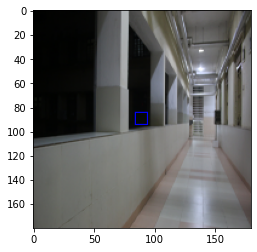

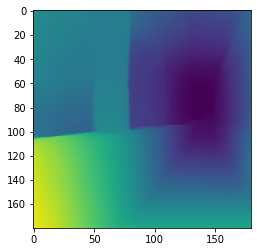

(88.77462634241076, 86.68418368968065)
(0.0, 179.0)
180 (88.77462634241076, 86.68418368968065) turn left 0.16 0.09772470000007161 1.3424084999999195 correct
(89.49999999994905, 89.49999999994951)
181 (89.49999999994905, 89.49999999994951) turn left 0.49583333333333335 0.09755530000006729 1.5202893999999105 correct
(88.99029974106844, 88.57010074540413)
182 (88.99029974106844, 88.57010074540413) turn left 0.175 0.09516329999996742 1.364216899999974 correct
(89.49999999994905, 89.49999999994951)
183 (89.49999999994905, 89.49999999994951) turn left 0.48083333333333333 0.09785759999977017 1.5114997999999105 correct
(89.49999999994905, 89.49999999994951)
184 (89.49999999994905, 89.49999999994951) turn left 0.7183333333333334 0.09593200000017532 1.5149399000001722 wrong


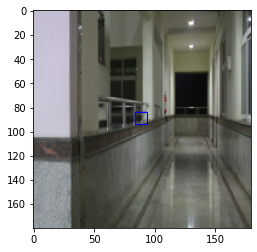

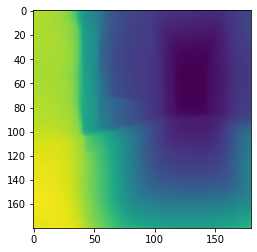

(89.49999999994905, 89.49999999994951)
185 (89.49999999994905, 89.49999999994951) turn left 0.48833333333333334 0.1356393000000935 1.4100493999999344 correct
(89.49999999994905, 89.49999999994951)
186 (89.49999999994905, 89.49999999994951) turn left 0.7758333333333334 0.0976357999998072 1.5160271999998258 wrong


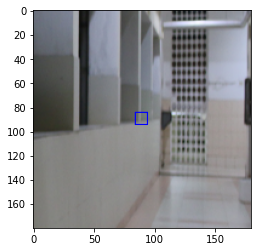

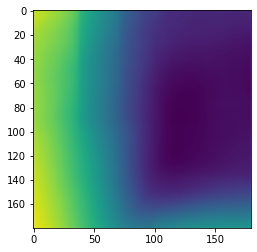

(89.49999999994905, 89.49999999994951)
187 (89.49999999994905, 89.49999999994951) turn left 0.4975 0.13553369999999632 1.5660354000001462 correct
(89.49999999994905, 89.49999999994951)
188 (89.49999999994905, 89.49999999994951) turn left 0.23416666666666666 0.09804409999969721 1.3784963999996762 correct
(89.49999999994905, 89.49999999994951)
189 (89.49999999994905, 89.49999999994951) turn left 0.455 0.09803499999998166 1.514361700000336 correct
(88.1109502636302, 80.16982042528468)
(0.0, 179.0)
190 (88.1109502636302, 80.16982042528468) turn left 0.1675 0.09440419999964433 1.4039120999996157 correct
(88.47859172713805, 91.48721187238394)
191 (88.47859172713805, 91.48721187238394) turn right 0.8708333333333333 0.09785140000030879 1.356819500000256 correct
(89.49999999994905, 89.49999999994951)
192 (89.49999999994905, 89.49999999994951) turn left 0.7183333333333334 0.09541089999993346 1.5126884000001155 wrong


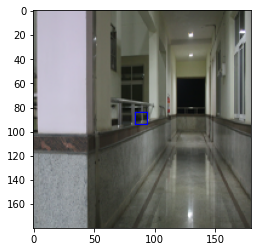

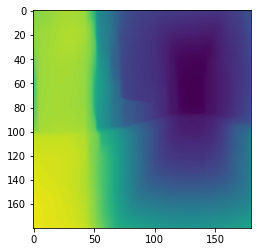

(89.4799701649743, 90.11874941723512)
193 (89.4799701649743, 90.11874941723512) turn right 0.5466666666666666 0.09291279999979452 1.3724367999998321 correct
(89.49999999994905, 89.49999999994951)
194 (89.49999999994905, 89.49999999994951) turn left 0.4708333333333333 0.09132449999970049 1.5121276999998372 correct
(88.62835224945525, 87.90127959249352)
195 (88.62835224945525, 87.90127959249352) turn left 0.16 0.09062070000027234 1.4920958000002429 correct
(89.49999999994905, 89.49999999994951)
196 (89.49999999994905, 89.49999999994951) turn left 0.8008333333333333 0.046620099999927334 1.3208786000000146 wrong


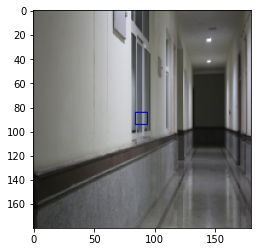

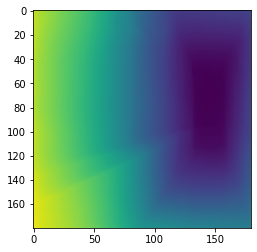

(89.17803418516247, 95.46374847087242)
197 (89.17803418516247, 95.46374847087242) turn right 0.8708333333333333 0.09830080000028829 1.4408548000001247 correct
(86.74484660015067, 86.64652325837578)
198 (86.74484660015067, 86.64652325837578) turn left 0.20833333333333334 0.0979458000001614 1.4776001999998698 correct
(88.6955860451373, 91.81377736932114)
199 (88.6955860451373, 91.81377736932114) turn right 0.5466666666666666 0.0984321999999338 1.3488164999998844 correct
(88.16379554682808, 87.79485402949155)
200 (88.16379554682808, 87.79485402949155) turn left 0.23416666666666666 0.0944339000002401 1.4944107000001168 correct
(89.49999999994905, 89.49999999994951)
201 (89.49999999994905, 89.49999999994951) turn left 0.4975 0.09345109999958368 1.3719324999997298 correct
(88.15956742436076, 91.31986001193063)
202 (88.15956742436076, 91.31986001193063) turn right 0.7958333333333333 0.09829760000002352 1.4839083000001665 correct
(89.49999999994905, 89.49999999994951)
203 (89.49999999994905, 8

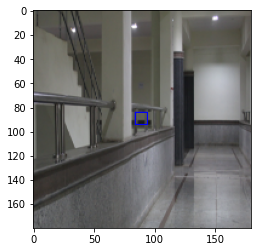

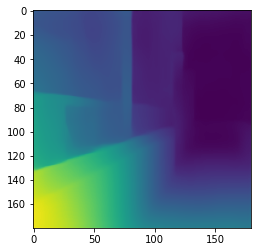

(89.08234440923627, 95.22333201471758)
208 (89.08234440923627, 95.22333201471758) turn right 0.5466666666666666 0.09493350000002465 1.4453221999997368 correct
(89.27117457646423, 78.86906761860737)
(0.0, 179.0)
209 (89.27117457646423, 78.86906761860737) turn left 0.225 0.09312150000005204 1.2385245000000396 correct
(88.43440159443405, 87.35663893190139)
(0.0, 179.0)
210 (88.43440159443405, 87.35663893190139) turn left 0.14333333333333334 0.09163430000035078 1.4781501000002208 correct
(89.50010896293348, 88.72665857222398)
(0.0, 179.0)
211 (89.50010896293348, 88.72665857222398) turn left 0.225 0.0904859000002034 1.503415799999857 correct
(88.16619434468271, 87.80609610172067)
212 (88.16619434468271, 87.80609610172067) turn left 0.23416666666666666 0.04603620000034425 1.3049337000002197 correct
(87.75400457661142, 87.04265191960563)
213 (87.75400457661142, 87.04265191960563) turn left 0.14333333333333334 0.09785110000029817 1.483392300000105 correct
(89.49999999994905, 89.49999999994951)

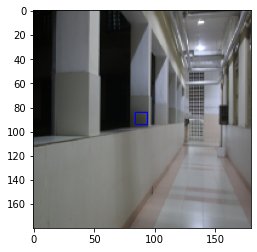

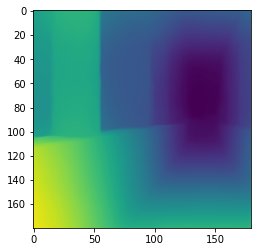

(89.49999999994905, 89.49999999994951)
216 (89.49999999994905, 89.49999999994951) turn left 0.7225 0.09775339999987409 1.5188462000000982 wrong


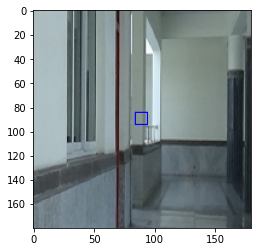

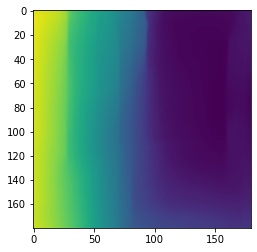

(89.49999999994905, 89.49999999994951)
217 (89.49999999994905, 89.49999999994951) turn left 0.4975 0.09546050000017203 1.3746212999999443 correct
(89.49999999994905, 89.49999999994951)
218 (89.49999999994905, 89.49999999994951) turn left 0.1575 0.09792569999990519 1.5200730000001386 correct
(89.49999999994905, 89.49999999994951)
219 (89.49999999994905, 89.49999999994951) turn left 0.1825 0.09488969999983965 1.510243199999877 correct
(89.49999999994905, 89.49999999994951)
220 (89.49999999994905, 89.49999999994951) turn left 0.4975 0.09458069999982399 1.372349199999917 correct
(87.78388475537312, 87.3811619439122)
221 (87.78388475537312, 87.3811619439122) turn left 0.1375 0.09770410000010088 1.4860899000000245 correct
(88.28070115487863, 98.14562974094643)
222 (88.28070115487863, 98.14562974094643) turn right 0.8025 0.0954609000000346 1.4107954999999492 correct
(89.49999999994905, 89.49999999994951)
223 (89.49999999994905, 89.49999999994951) turn left 0.4841666666666667 0.135706399999889

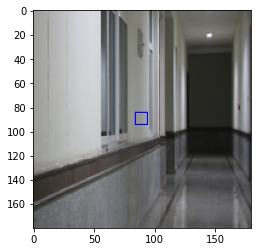

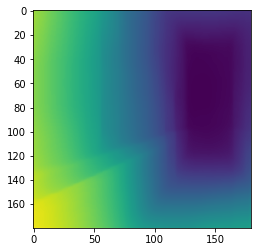

(88.2516268979981, 87.95124021498437)
227 (88.2516268979981, 87.95124021498437) turn left 0.23416666666666666 0.13537220000034722 1.5384093000002395 correct
(89.4061196105194, 89.37552155766873)
228 (89.4061196105194, 89.37552155766873) turn left 0.1275 0.09763750000001892 1.3773587999999108 correct
(89.1367308662921, 76.52138786694609)
229 (89.1367308662921, 76.52138786694609) turn left 0.225 0.09618530000034298 1.3456088000002637 correct
(89.49999999994905, 89.49999999994951)
230 (89.49999999994905, 89.49999999994951) turn left 0.2808333333333333 0.09405800000013187 1.517326900000171 correct
(87.49321761486819, 86.09148183859011)
(0.0, 179.0)
231 (87.49321761486819, 86.09148183859011) turn left 0.23416666666666666 0.09839079999983369 1.3377391999997599 correct
(89.49999999994905, 89.49999999994951)
232 (89.49999999994905, 89.49999999994951) turn left 0.47333333333333333 0.09532089999993332 1.5163760000000366 correct
(89.44843880287694, 89.44195311771111)
233 (89.44843880287694, 89.44

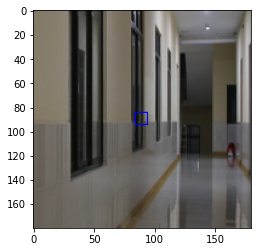

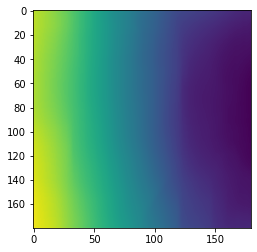

(89.49999999994905, 89.49999999994951)
250 (89.49999999994905, 89.49999999994951) turn left 0.8008333333333333 0.09806909999997515 1.517112300000008 wrong


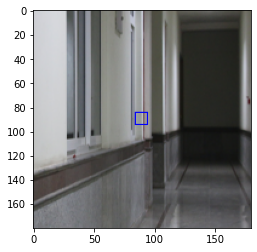

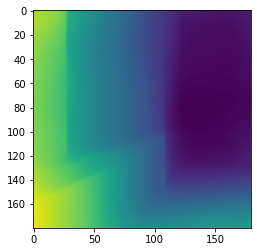

(88.95741869914107, 97.47066395658949)
251 (88.95741869914107, 97.47066395658949) turn right 0.7958333333333333 0.09498980000034862 1.4133919000000787 correct
(89.49999999994905, 89.49999999994951)
252 (89.49999999994905, 89.49999999994951) turn left 0.4975 0.09315420000029917 1.3616547999999966 correct
(89.49999999994905, 89.49999999994951)
253 (89.49999999994905, 89.49999999994951) turn left 0.4841666666666667 0.09155899999996109 1.5102765999999974 correct
(89.49999999994905, 89.49999999994951)
254 (89.49999999994905, 89.49999999994951) turn left 0.5033333333333333 0.09784539999964181 1.5174337999997078 wrong


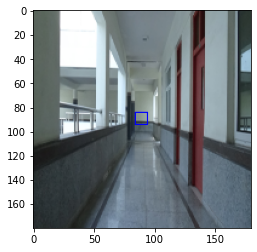

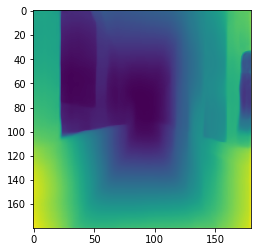

(89.79981795921067, 90.99240450702722)
255 (89.79981795921067, 90.99240450702722) turn right 0.7958333333333333 0.09501890000001367 1.3535698000000593 correct
(89.20858153086654, 92.29114770803744)
256 (89.20858153086654, 92.29114770803744) turn right 0.8275 0.09278439999980037 1.482091500000024 correct
(89.08236749572194, 94.15493553843125)
257 (89.08236749572194, 94.15493553843125) turn right 0.8025 0.0917991000001166 1.311873000000105 correct
(89.49999999994905, 89.49999999994951)
258 (89.49999999994905, 89.49999999994951) turn left 0.175 0.09030389999998079 1.5061242000001585 correct
(89.49999999994905, 89.49999999994951)
259 (89.49999999994905, 89.49999999994951) turn left 0.49583333333333335 0.046121599999878526 1.4705678999998781 correct
(87.38395269728417, 87.15128588226736)
260 (87.38395269728417, 87.15128588226736) turn left 0.20833333333333334 0.13579759999993257 1.3861657999996169 correct
(89.15485011000301, 89.11408376471404)
261 (89.15485011000301, 89.11408376471404) turn

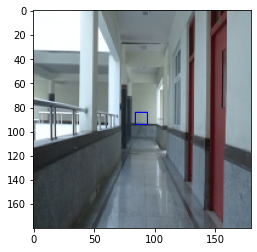

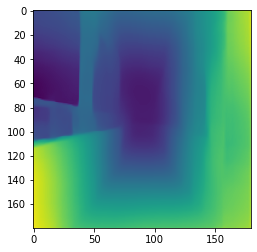

(89.49999999994905, 89.49999999994951)
267 (89.49999999994905, 89.49999999994951) turn left 0.8008333333333333 0.0979341000002023 1.516978999999992 wrong


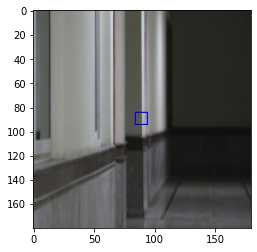

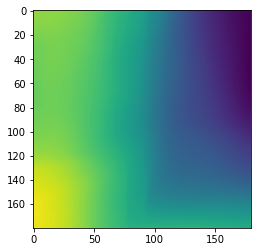

(87.56670992857254, 85.2502595716602)
(0.0, 179.0)
268 (87.56670992857254, 85.2502595716602) turn left 0.1675 0.09772049999992305 1.3160236999997323 correct
(89.46765677581594, 89.53589403150538)
269 (89.46765677581594, 89.53589403150538) turn left 0.8683333333333333 0.13567560000001322 1.5560529999997925 wrong


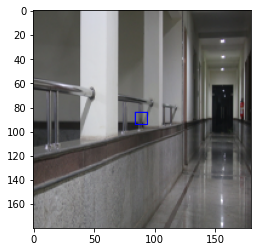

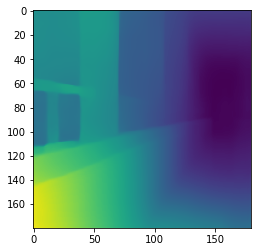

(88.25792277880952, 99.16257265425408)
270 (88.25792277880952, 99.16257265425408) turn right 0.8708333333333333 0.09799680000014632 1.3944574000001921 correct
(89.49999999994905, 89.49999999994951)
271 (89.49999999994905, 89.49999999994951) turn left 0.4816666666666667 0.09634199999982229 1.3717351999998755 correct
(89.49999999994905, 89.49999999994951)
272 (89.49999999994905, 89.49999999994951) turn left 0.49083333333333334 0.09412730000030933 1.5057526999999027 correct
(87.76151890684783, 87.06081982835944)
273 (87.76151890684783, 87.06081982835944) turn left 0.14333333333333334 0.09785969999984445 1.4887555000000248 correct
(87.96851030887186, 78.53528956438194)
(0.0, 179.0)
274 (87.96851030887186, 78.53528956438194) turn left 0.1675 0.09515579999970214 1.2337791999998444 correct
(89.49999999994905, 89.49999999994951)
275 (89.49999999994905, 89.49999999994951) turn left 0.4841666666666667 0.09296979999999166 1.5040052999997897 correct
(89.49999999994905, 89.49999999994951)
276 (89.4

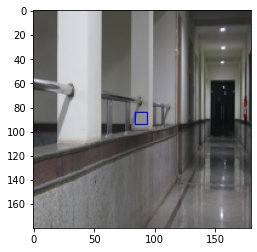

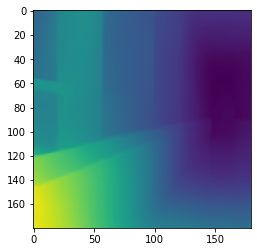

(89.50281099544566, 90.06867526008301)
279 (89.50281099544566, 90.06867526008301) turn right 0.5466666666666666 0.13367440000001807 1.407344799999919 correct
(93.73697303834422, 82.7610098836384)
(0.0, 179.0)
280 (93.73697303834422, 82.7610098836384) turn left 0.14416666666666667 0.09797429999980523 1.4233761000000413 correct
(89.27136115245824, 90.02940263283584)
281 (89.27136115245824, 90.02940263283584) turn right 0.8708333333333333 0.13557859999991706 1.551903399999901 correct
(87.58022872148291, 86.3628792003882)
282 (87.58022872148291, 86.3628792003882) turn left 0.1875 0.1354655999998613 1.3749275000000125 correct
(89.49999999994905, 89.49999999994951)
283 (89.49999999994905, 89.49999999994951) turn left 0.495 0.09762589999991178 1.5103908999999476 correct
(89.49999999994905, 89.49999999994951)
284 (89.49999999994905, 89.49999999994951) turn left 0.4975 0.09786140000005616 1.5163118000000395 correct
(89.49999999994905, 89.49999999994951)
285 (89.49999999994905, 89.49999999994951

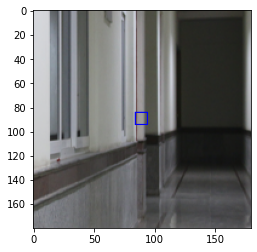

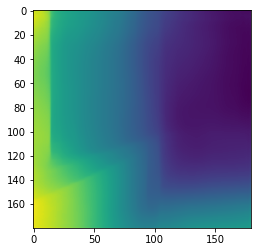

(89.49999999994905, 89.49999999994951)
286 (89.49999999994905, 89.49999999994951) turn left 0.4875 0.09304929999962042 1.516579599999659 correct
(89.36063951505574, 89.67359371612604)
287 (89.36063951505574, 89.67359371612604) turn left 0.7916666666666666 0.09150110000018685 1.5068939000002501 wrong


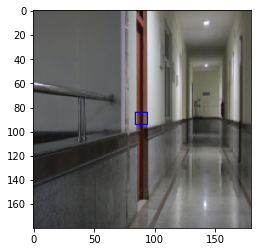

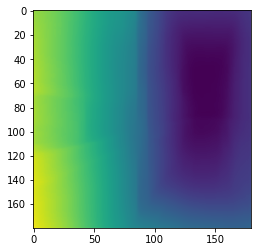

(89.49999999994905, 89.49999999994951)
288 (89.49999999994905, 89.49999999994951) turn left 0.495 0.09786600000006729 1.37428779999982 correct
(89.49999999994905, 89.49999999994951)
289 (89.49999999994905, 89.49999999994951) turn left 0.4875 0.09793460000037157 1.5253319000003103 correct
(89.49999999994905, 89.49999999994951)
290 (89.49999999994905, 89.49999999994951) turn left 0.17416666666666666 0.09494719999975132 1.5225531000000956 correct
(89.49999999994905, 89.49999999994951)
291 (89.49999999994905, 89.49999999994951) turn left 0.4891666666666667 0.09792759999982081 1.381747599999926 correct
(89.49999999994905, 89.49999999994951)
292 (89.49999999994905, 89.49999999994951) turn left 0.7183333333333334 0.09493689999999333 1.5115042999996149 wrong


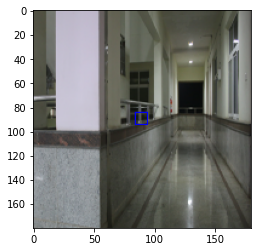

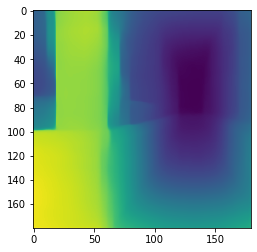

(87.45362192237197, 93.50169853435705)
293 (87.45362192237197, 93.50169853435705) turn right 0.8025 0.09800360000008368 1.324457700000039 correct
(89.49456756584819, 89.50552503235892)
294 (89.49456756584819, 89.50552503235892) turn left 0.8258333333333333 0.09512989999984711 1.5018165999999837 wrong


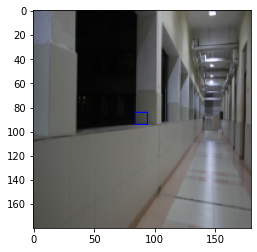

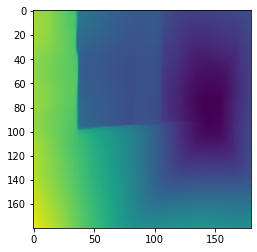

(89.49999999994905, 89.49999999994951)
295 (89.49999999994905, 89.49999999994951) turn left 0.8258333333333333 0.09787500000038563 1.5150923999999577 wrong


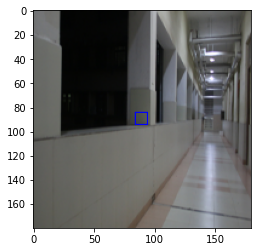

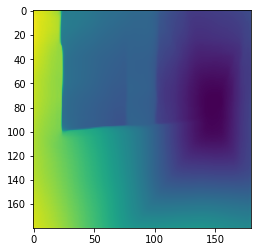

(89.37656631906064, 89.28124129817695)
296 (89.37656631906064, 89.28124129817695) turn left 0.17416666666666666 0.13566649999984293 1.4071429000000535 correct
(89.49999999994905, 89.49999999994951)
297 (89.49999999994905, 89.49999999994951) turn left 0.1575 0.0978688999998667 1.5113937999999507 correct
(88.24473303560862, 87.92396704604872)
298 (88.24473303560862, 87.92396704604872) turn left 0.23416666666666666 0.13548070000024381 1.5298444000000018 correct
(89.49999999994905, 89.49999999994951)
299 (89.49999999994905, 89.49999999994951) turn left 0.4891666666666667 0.09775179999996908 1.3702781000001778 correct
(89.49999999994905, 89.49999999994951)
300 (89.49999999994905, 89.49999999994951) turn left 0.4816666666666667 0.09496379999973215 1.5129125999997086 correct
theta_AOI:  1000
theta_y:  0
Number of Frames:  300
Predicted count:  300
Unable to Predict count:  0
Correct Decision count:  249
Average Inference Time(s) 1.4403722449999903
Mean Squared Error:  0.05899387713833826
Mean

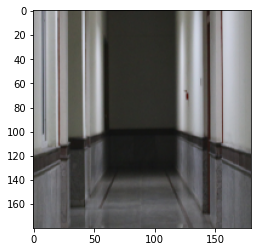

In [5]:
#Importing the Vanishing Point Locator (Solution class) defined in utility.py
from utility import Solution

#List of Area of interest thresholds to be evaluated on
area_of_interest_thresholds=[10,30,50,70,90,100,200,300,400,1000]
#Since the proposed algorithm predicts the normalized horiontal distance with range [0,1],
#predicted_value<0.5 : turn left
#predicted_value>0.5 : turn right
#predicted_value==0.5 : go forward
#A sharp value of 0.5 is practically impossible to encounter. Hence, the "go_forward"/"pitch" class may never be executed.
#Hence, for practical purposes, we set an interval around 0.5: [0.5-theta_y, 0.5+theta_y] as the "go forward"/"pitch" class
#For testing purposes, we set theta_y=0
theta_ys=[0]

#Creating arrays to store computed metrics
#Ignore predicted_counts, unable_to_predict_counts, discernibilities, accuracies
predicted_counts=np.zeros([len(area_of_interest_thresholds),len(theta_ys)])
unable_to_predict_counts=np.zeros([len(area_of_interest_thresholds),len(theta_ys)])
MSEs=np.zeros([len(area_of_interest_thresholds),len(theta_ys)])
MAEs=np.zeros([len(area_of_interest_thresholds),len(theta_ys)])
MREs=np.zeros([len(area_of_interest_thresholds),len(theta_ys)])
average_inference_times=np.zeros([len(area_of_interest_thresholds),len(theta_ys)])
average_depth_inference_times=np.zeros([len(area_of_interest_thresholds),len(theta_ys)])
correct_decision_counts=np.zeros([len(area_of_interest_thresholds),len(theta_ys)])
discernibilities=np.zeros([len(area_of_interest_thresholds),len(theta_ys)])
accuracies=np.zeros([len(area_of_interest_thresholds),len(theta_ys)])

# Testing on all Area of Interest Thresholds and theta_ys which has only one theta_y=0
for AOI_i in range(len(area_of_interest_thresholds)):
    for th_i in range(len(theta_ys)):
        #fix this error also
        resolution=180
        #lower value of AOI theta leads to faster inference time
        area_of_interest_threshold=area_of_interest_thresholds[AOI_i]
        theta_y=theta_ys[th_i]
        forward_threshold=theta_y*resolution
        
        num_of_frames=0
        predicted_count=0
        unable_to_predict_count=0

        skip_frames_till=0
        num_of_frames_limit=300
        
        SRE=0
        SSE=0
        SAE=0
        average_inference_time=0
        average_depth_inference_time=0

        correct_decision=0
        # cap.isOpened() and 
        while(num_of_frames<num_of_frames_limit):
            #ret,frame=cap.read()
            ret=True
            image=ds_arr1[num_of_frames]
            y=ds_arr2[num_of_frames]
            frame=np.zeros(shape=[180,320,3])

            for i in range(3):
                for j in range(180):
                    for k in range(320):
                        frame[j][k][i]=image[i][j][k]
            frame=frame.astype(np.uint8)
            if ret==False:
                break
            if ret==True:
                if num_of_frames%1!=0 or num_of_frames<skip_frames_till:
                    num_of_frames = num_of_frames + 1
                    continue
                num_of_frames=num_of_frames+1


                frame=cv2.resize(frame,(resolution,resolution)) 

                plt.imshow(frame)
                t_0 = timeit.default_timer()
                depth_image=image_to_depth(frame)
                t_1 = timeit.default_timer()
                solution1=Solution(depth_image,area_of_interest_threshold,forward_threshold)
                #print("min: ",solution1.minimum)
                #print("AOI threshold: ",solution1.areaOfInterest_threshold)
                centroid,decided_action=solution1.decide_action2()
                t_2 = timeit.default_timer()
                elapsed_time1 = (t_1 - t_0)
                elapsed_time2= (t_2-t_0)
                average_depth_inference_time=average_depth_inference_time+elapsed_time1
                average_inference_time=average_inference_time+elapsed_time2
                
                if centroid[0]==-1:
                    cv2.rectangle(frame, (0 + 10, 0 + 10), (0 + 15, 0 + 15), (0, 255, 0), 1)
                    unable_to_predict_count=unable_to_predict_count+1

                else:
                    centroid1=np.uint8(centroid)
                    cv2.rectangle(frame, (centroid1[1] - 5, centroid1[0] - 5), (centroid1[1] + 5, centroid1[0] + 5), (0, 0, 255), 1)
                    SSE=SSE+(centroid[1]/resolution-y)**2
                    SAE=SAE+abs(centroid[1]/resolution-y)
                    SRE=SRE+((abs(centroid[1]/resolution-y))/y)
                    predicted_count=predicted_count+1

                    if y>=0.5-theta_y and y<=0.5+theta_y and decided_action=="go forward":
                        correct_decision=correct_decision+1
                        print(num_of_frames,centroid,decided_action,y,elapsed_time1,elapsed_time2,"correct")
                    elif y<0.5-theta_y and decided_action=="turn left":
                        correct_decision=correct_decision+1
                        print(num_of_frames,centroid,decided_action,y,elapsed_time1,elapsed_time2,"correct")
                    elif y>0.5+theta_y and decided_action=="turn right":
                        correct_decision=correct_decision+1
                        print(num_of_frames,centroid,decided_action,y,elapsed_time1,elapsed_time2,"correct")
                    else:
                        print(num_of_frames,centroid,decided_action,y,elapsed_time1,elapsed_time2,"wrong")
                        plt.imshow(frame)
                        plt.show()
                        plt.imshow(depth_image)
                        plt.show()
                    #elif y>0.5-theta_y and y<0.5+theta_y and decided_action=="go forward":
                    #    correct_decision=correct_decision+1

                dist=frame
                dist = dist.astype(np.uint8)
                frame=dist
                cv2.namedWindow('video', cv2.WINDOW_NORMAL)
                cv2.resizeWindow('video', 600, 600)
                cv2.imshow("video",frame)

                if(cv2.waitKey(10)&0xFF==ord('q')):
                    break


        #cap.release()
        cv2.destroyAllWindows()
        #predicted_ratio=predicted_count/(predicted_count+unable_to_predict_count)
        #print(predicted_ratio)
        
        print("theta_AOI: ",area_of_interest_thresholds[AOI_i])
        print("theta_y: ",theta_ys[th_i])
        print("Number of Frames: ",num_of_frames)
        print("Predicted count: ",predicted_count)
        print("Unable to Predict count: ",unable_to_predict_count)
        print("Correct Decision count: ",correct_decision)
        MSE=SSE/predicted_count
        MAE=SAE/predicted_count
        MRE=SRE/predicted_count
        discernibility=predicted_count/num_of_frames
        average_inference_time=average_inference_time/num_of_frames
        average_depth_inference_time=average_depth_inference_time/num_of_frames
        accuracy=correct_decision/predicted_count
        print("Average Inference Time(s)",average_inference_time)
        print("Mean Squared Error: ",MSE)
        print("Mean Absolute Error: ",MAE)
        print("Mean Squared Error including unpredicted: ",(MSE*predicted_count+1*unable_to_predict_count)/num_of_frames)
        print("Mean Absolute Error including unpredicted: ",(MAE*predicted_count+1*unable_to_predict_count)/num_of_frames)
        print("Accuracy: ",accuracy)
        print("Discernibility",discernibility)
        
        predicted_counts[AOI_i][th_i]=predicted_count
        unable_to_predict_counts[AOI_i][th_i]=unable_to_predict_count
        MSEs[AOI_i][th_i]=MSE
        MAEs[AOI_i][th_i]=MAE
        MREs[AOI_i][th_i]=MRE
        average_inference_times[AOI_i][th_i]=average_inference_time
        average_depth_inference_times[AOI_i][th_i]=average_depth_inference_time
        correct_decision_counts[AOI_i][th_i]=correct_decision
        discernibilities[AOI_i][th_i]=discernibility
        accuracies[AOI_i][th_i]=accuracy
        
        print("theta_AOI: ",area_of_interest_thresholds[AOI_i])
        print("theta_y: ",theta_ys[th_i])
        print("Number of Frames: ",num_of_frames)
        print("Predicted count: ")
        print(predicted_counts)
        print("Unable to Predict count: ")
        print(unable_to_predict_counts)
        print("Correct Decision count: ")
        print(correct_decision_counts)

        print("Average Inference Time(s)")
        print(average_inference_times)
        print("Average Depth Inference Time(s)")
        print(average_depth_inference_times)
        print("Mean Squared Error: ")
        print(MSEs)
        print("Mean Absolute Error: ")
        print(MAEs)
        print("Mean Relative Error: ")
        print(MREs)
        print("Accuracy: ")
        print(accuracies)
        print("Discernibility")
        print(discernibilities)
        


In [ ]:
print("theta_AOI: ",area_of_interest_thresholds[AOI_i])
print("theta_y: ",theta_ys[th_i])
print("Number of Frames: ",num_of_frames)
print("Predicted count: ")
print(predicted_counts)
print("Unable to Predict count: ")
print(unable_to_predict_counts)
print("Correct Decision count: ")
print(correct_decision_counts)

print("Average Inference Time(s)")
print(average_inference_times)
print("Mean Squared Error: ")
print(MSEs)
print("Mean Absolute Error: ")
print(MAEs)
print("Accuracy: ")
print(accuracies)
print("Discernibility")
print(discernibilities)

In [8]:
import pandas as pd
df = pd.DataFrame(X4)
writer = pd.ExcelWriter('val7.xlsx', engine='xlsxwriter')
df.to_excel(writer, sheet_name='welcome', index=False)
writer.save()